In [35]:
import torch
import tensorflow as tf
import numpy as np                                
import matplotlib.pyplot as plt
from keras.datasets import cifar10, fashion_mnist
from keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten
from tensorflow.keras.layers import Dense, Conv2D
from tensorflow.keras.layers import BatchNormalization, Activation, MaxPooling2D
from tensorflow.keras.layers import AveragePooling2D, Input
from tensorflow.keras.layers import Flatten, add
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
from tensorflow.keras.callbacks import ModelCheckpoint, LearningRateScheduler
from tensorflow.keras.callbacks import ReduceLROnPlateau
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.regularizers import l2
from tensorflow.keras.utils import to_categorical
from sklearn.preprocessing import LabelBinarizer
import math
import time
import os
import cv2
from pdf2image import convert_from_path
from IPython.display import Image, display

# from keras_balanced_batch_generator import make_generator

In [ ]:
! pip install pdf2image
!apt-get install poppler-utils 

In [4]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


### Problem 1

In [64]:
# 1.1

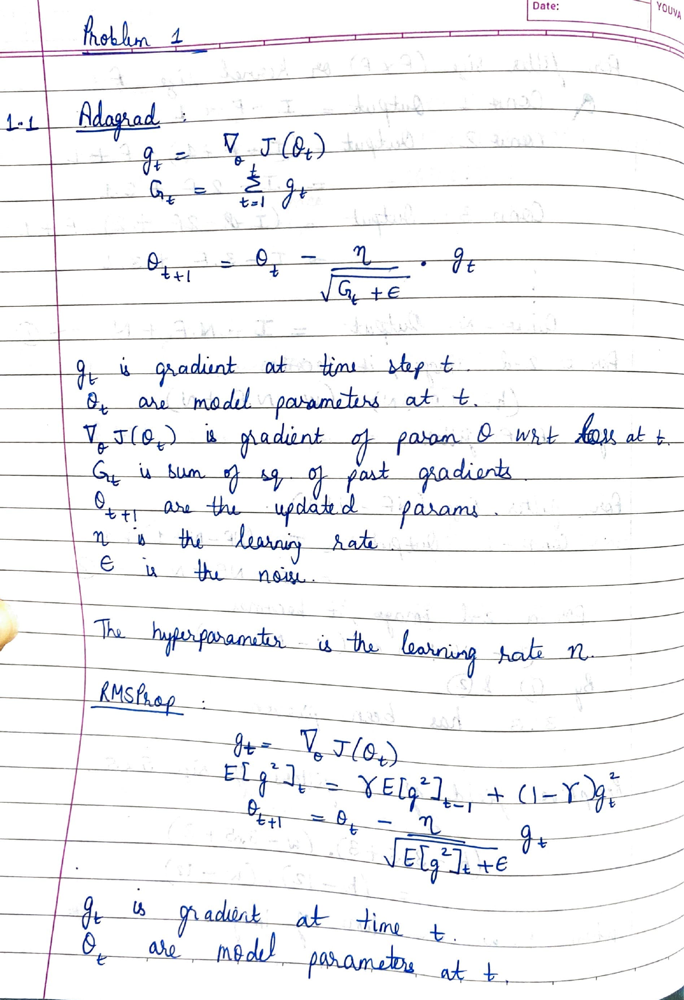

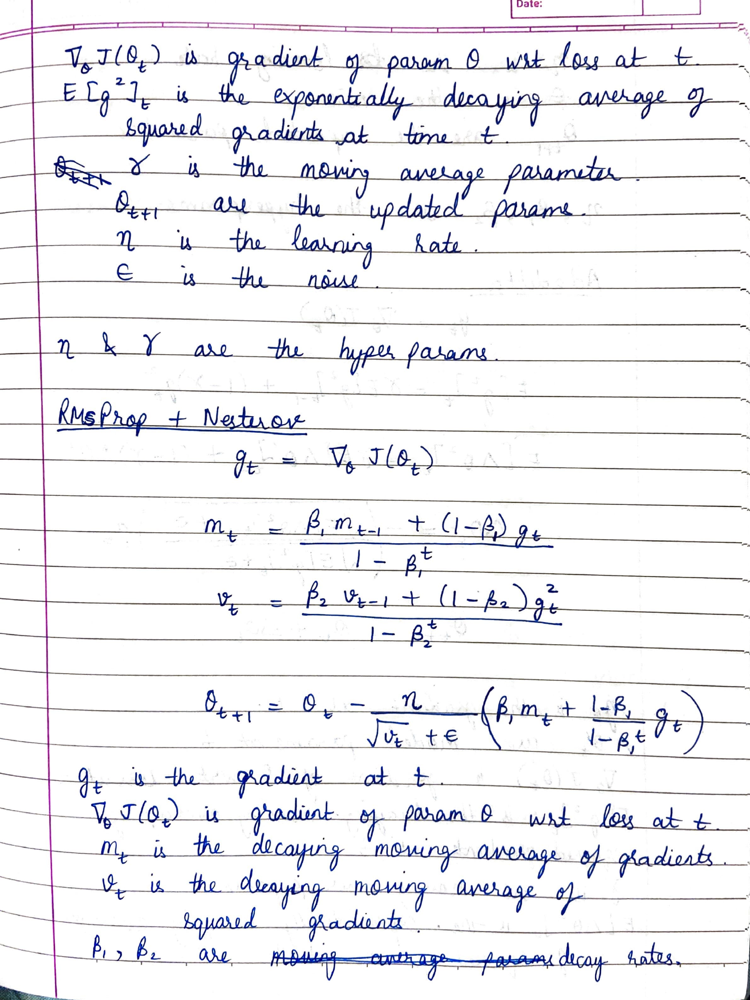

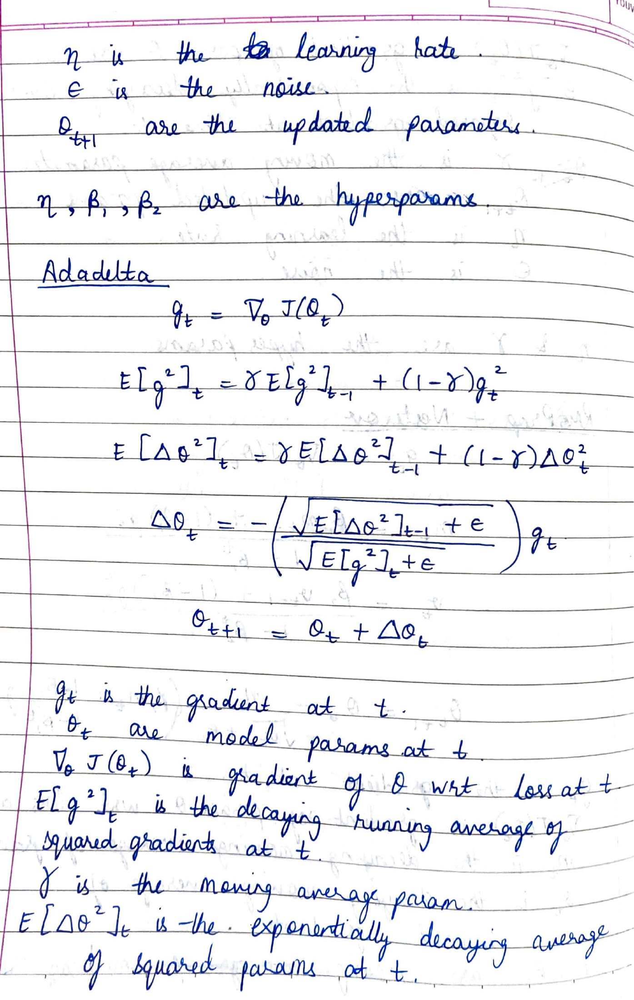

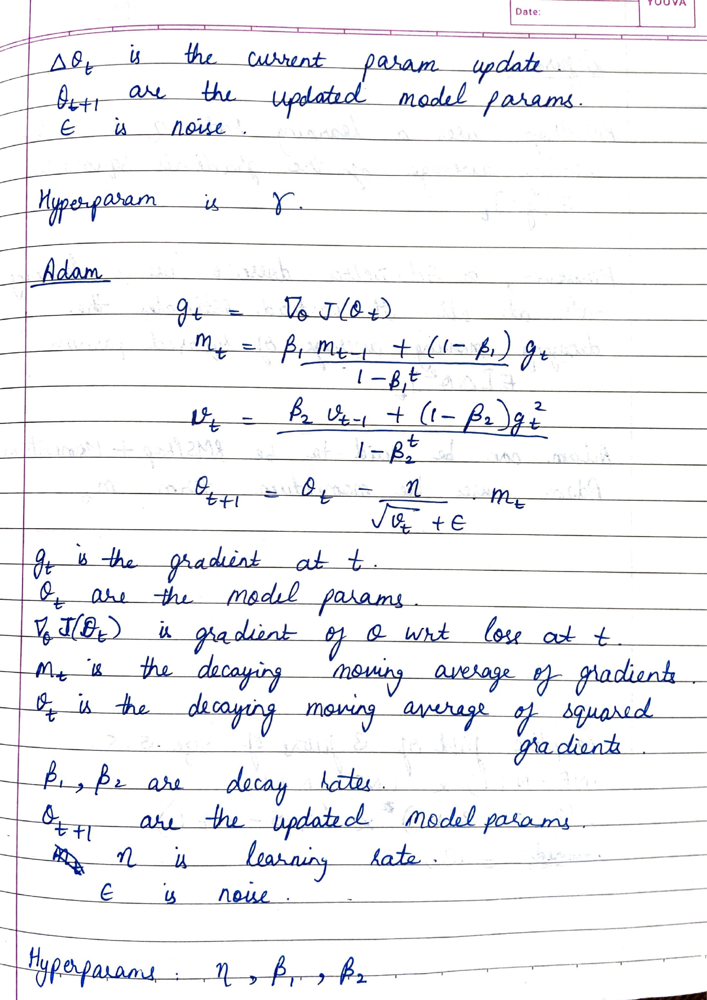

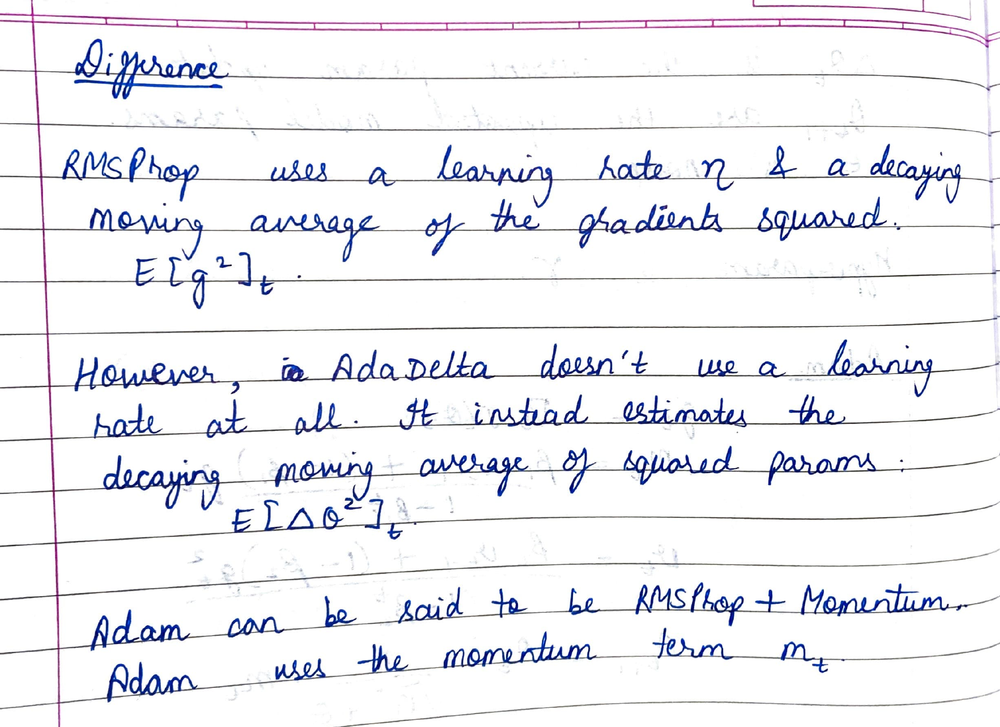

In [27]:
q1_images = convert_from_path("/content/gdrive/MyDrive/pdl hw3 1.1.pdf")

for i in range(len(q1_images)):
  display(q1_images[i])

In [54]:
# 1.2

**All parts in prob 1 run on GPU, results displayed here alongwith code.**

In [ ]:
# Train the neural network using all the five methods with L2-regularization for 200 epochs each and 
# plot the training loss vs number of epochs. Which method performs best (lowest training loss) ? 

#Preprocessing
(cifar_x_train, cifar_y_train), (cifar_x_test, cifar_y_test) = cifar10.load_data()

X_train = cifar_x_train.astype('float32') / 255
X_test = cifar_x_test.astype('float32') / 255

print('x_train shape:', X_train.shape)
print(X_train.shape[0], 'train samples')
print(X_test.shape[0], 'test samples')
print('y_train shape:', cifar_y_train.shape)

y_train = to_categorical(cifar_y_train)
y_test = to_categorical(cifar_y_test)

training_loss = []
time_taken = []
test_acc = []

print("start training")
#Adagrad
ada_opt = tf.keras.optimizers.Adagrad(
learning_rate=0.001, 
initial_accumulator_value=0.1, 
epsilon=1e-07,
name='Adagrad')
model1 = Sequential([
	Flatten(),
	Dense(1000, activation='relu', kernel_regularizer='l2'),
	Dense(1000, activation='relu', kernel_regularizer='l2'),
	Dense(10, activation='softmax')
	])
model1.compile(loss='categorical_crossentropy', optimizer=ada_opt, metrics=['acc'])

start = time.time()
history1 = model1.fit(
	X_train, y_train, batch_size=128, epochs=200, validation_data=(X_test,y_test),shuffle=True,verbose=2)
end = time.time()
print('Adagrad: Training Time:',end-start,'seconds')
print('Adagrad: Training loss:',history1.history['loss'])
print('Adagrad: Val loss:',history1.history['val_loss'])
print('Adagrad: Training acc:',history1.history['acc'])
print('Adagrad: Val acc:',history1.history['val_acc'])
training_loss.append(history1.history['loss'])
time_taken.append(end-start)
test_acc.append(history1.history['val_acc'])


#RMSProp
rms_opt = tf.keras.optimizers.RMSprop(
    learning_rate=0.001,
    rho=0.9,
    momentum=0.0,
    epsilon=1e-07,
    centered=False,
    name="RMSprop")
model2 = Sequential([
	Flatten(),
	Dense(1000, activation='relu', kernel_regularizer='l2'),
	Dense(1000, activation='relu', kernel_regularizer='l2'),
	Dense(10, activation='softmax')
	])
model2.compile(loss='categorical_crossentropy', optimizer=rms_opt, metrics=['acc'])

start = time.time()
history2 = model2.fit(
	X_train, y_train, batch_size=128, epochs=200, validation_data=(X_test,y_test),shuffle=True,verbose=2)
end = time.time()
print('RMSprop: Training Time:',end-start,'seconds')
print('RMSprop: Training loss:',history2.history['loss'])
print('RMSprop: Val loss:',history2.history['val_loss'])
print('RMSprop: Training acc:',history2.history['acc'])
print('RMSprop: Val acc:',history2.history['val_acc'])
training_loss.append(history2.history['loss'])
time_taken.append(end-start)
test_acc.append(history2.history['val_acc'])

#Nadam
rmr_nest_opt = tf.keras.optimizers.Nadam(
    learning_rate=0.001, beta_1=0.9, beta_2=0.999, epsilon=1e-07, name="Nadam")
model3 = Sequential([
	Flatten(),
	Dense(1000, activation='relu', kernel_regularizer='l2'),
	Dense(1000, activation='relu', kernel_regularizer='l2'),
	Dense(10, activation='softmax')
	])
model3.compile(loss='categorical_crossentropy', optimizer=rmr_nest_opt, metrics=['acc'])

start = time.time()
history3 = model3.fit(
	X_train, y_train, batch_size=128, epochs=200, validation_data=(X_test,y_test),shuffle=True,verbose=2)
end = time.time()
print('RMSprop_nest: Training Time:',end-start,'seconds')
print('RMSprop_nest: Training loss:',history3.history['loss'])
print('RMSprop_nest: Val loss:',history3.history['val_loss'])
print('RMSprop_nest: Training acc:',history3.history['acc'])
print('RMSprop_nest: Val acc:',history3.history['val_acc'])
training_loss.append(history3.history['loss'])
time_taken.append(end-start)
test_acc.append(history3.history['val_acc'])


#AdaDelta
ada_delta_opt = tf.keras.optimizers.Adadelta(
    learning_rate=0.001, rho=0.95, epsilon=1e-07, name="Adadelta")
model4 = Sequential([
	Flatten(),
	Dense(1000, activation='relu', kernel_regularizer='l2'),
	Dense(1000, activation='relu', kernel_regularizer='l2'),
	Dense(10, activation='softmax')
	])
model4.compile(loss='categorical_crossentropy', optimizer=ada_delta_opt, metrics=['acc'])

start = time.time()
history4 = model4.fit(
	X_train, y_train, batch_size=128, epochs=200, validation_data=(X_test,y_test),shuffle=True,verbose=2)
end = time.time()
print('AdaDelta: Training Time:',end-start,'seconds')
print('AdaDelta: Training loss:',history4.history['loss'])
print('AdaDelta: Val loss:',history4.history['val_loss'])
print('AdaDelta: Training acc:',history4.history['acc'])
print('AdaDelta: Val acc:',history4.history['val_acc'])
training_loss.append(history4.history['loss'])
time_taken.append(end-start)
test_acc.append(history4.history['val_acc'])


#Adam
adam_opt = tf.keras.optimizers.Adam(
    learning_rate=0.001,
    beta_1=0.9,
    beta_2=0.999,
    epsilon=1e-07,
    amsgrad=False,
    name="Adam")
model5 = Sequential([
	Flatten(),
	Dense(1000, activation='relu', kernel_regularizer='l2'),
	Dense(1000, activation='relu', kernel_regularizer='l2'),
	Dense(10, activation='softmax')
	])
model5.compile(loss='categorical_crossentropy', optimizer=adam_opt, metrics=['acc'])

start = time.time()
history5 = model5.fit(
	X_train, y_train, batch_size=128, epochs=200, validation_data=(X_test,y_test),shuffle=True,verbose=2)
end = time.time()
print('Adam: Training Time:',end-start,'seconds')
print('Adam: Training loss:',history5.history['loss'])
print('Adam: Val loss:',history5.history['val_loss'])
print('Adam: Training acc:',history5.history['acc'])
print('Adam: Val acc:',history5.history['val_acc'])
training_loss.append(history5.history['loss'])
time_taken.append(end-start)
test_acc.append(history5.history['val_acc'])

with open("1b_trainig_loss", "w") as f:
    f.write(str(training_loss))
f.close()

with open("1b_time", "w") as f:
    f.write(str(time_taken))
f.close()

with open("1b_acc", "w") as f:
    f.write(str(test_acc))
f.close()

In [57]:
# Output from above files on VM:

In [3]:
# Training loss
adagrad, rmsprop, nadam, adadelta, adam = [[26.55187225341797, 25.222909927368164, 24.052770614624023, 22.96346664428711, 21.93932342529297, 20.97215461730957, 20.05615234375, 19.18796730041504, 18.364944458007812, 17.583581924438477, 16.841909408569336, 16.137094497680664, 15.467551231384277, 14.831625938415527, 14.22675895690918, 13.652026176452637, 13.105304718017578, 12.584867477416992, 12.089763641357422, 11.619665145874023, 11.170652389526367, 10.744117736816406, 10.337563514709473, 9.950824737548828, 9.582315444946289, 9.230847358703613, 8.8964262008667, 8.577677726745605, 8.274055480957031, 7.983775615692139, 7.7077531814575195, 7.444677352905273, 7.193479537963867, 6.953845500946045, 6.725544452667236, 6.50728702545166, 6.299524307250977, 6.101211071014404, 5.911623001098633, 5.731088161468506, 5.558056831359863, 5.393400192260742, 5.236072063446045, 5.085703372955322, 4.942418575286865, 4.804930686950684, 4.674337387084961, 4.548768043518066, 4.429002285003662, 4.314969539642334, 4.2056965827941895, 4.101101398468018, 4.001127243041992, 3.905869960784912, 3.8140602111816406, 3.7269654273986816, 3.642948865890503, 3.5627264976501465, 3.4862406253814697, 3.4128901958465576, 3.343144178390503, 3.2749276161193848, 3.210918426513672, 3.1494534015655518, 3.090378522872925, 3.033810615539551, 2.9792068004608154, 2.9275364875793457, 2.878176212310791, 2.8300790786743164, 2.7843377590179443, 2.740339756011963, 2.6980152130126953, 2.65800404548645, 2.6193947792053223, 2.5817675590515137, 2.5463626384735107, 2.51204776763916, 2.479405403137207, 2.4477968215942383, 2.4173712730407715, 2.3884694576263428, 2.3606109619140625, 2.3331117630004883, 2.307903528213501, 2.282513380050659, 2.259084939956665, 2.2358572483062744, 2.2142088413238525, 2.193186044692993, 2.1727795600891113, 2.1531872749328613, 2.1340715885162354, 2.1160659790039062, 2.0983238220214844, 2.0819413661956787, 2.0655696392059326, 2.0499398708343506, 2.034407138824463, 2.020367383956909, 2.0061004161834717, 1.9927912950515747, 1.979912519454956, 1.967133641242981, 1.9553507566452026, 1.9434518814086914, 1.9325237274169922, 1.9211900234222412, 1.911547064781189, 1.9008160829544067, 1.8911614418029785, 1.8813552856445312, 1.871870994567871, 1.863344669342041, 1.8552777767181396, 1.8466676473617554, 1.838871717453003, 1.8313740491867065, 1.824034571647644, 1.8165565729141235, 1.8091422319412231, 1.8027632236480713, 1.795723795890808, 1.7893571853637695, 1.7837144136428833, 1.7776495218276978, 1.7723240852355957, 1.7663570642471313, 1.7613722085952759, 1.7556204795837402, 1.7503923177719116, 1.74527907371521, 1.740742802619934, 1.736082911491394, 1.7314985990524292, 1.7267998456954956, 1.723154067993164, 1.718549370765686, 1.714952826499939, 1.7106527090072632, 1.7066051959991455, 1.7033495903015137, 1.6993684768676758, 1.6956651210784912, 1.6928013563156128, 1.6895164251327515, 1.686414361000061, 1.6828981637954712, 1.6796647310256958, 1.6769155263900757, 1.6738216876983643, 1.6710803508758545, 1.6687426567077637, 1.665539264678955, 1.6634479761123657, 1.6605299711227417, 1.6582344770431519, 1.6554814577102661, 1.65311598777771, 1.6513854265213013, 1.6483992338180542, 1.6461448669433594, 1.644472599029541, 1.641822338104248, 1.6397428512573242, 1.6384652853012085, 1.6360474824905396, 1.6343683004379272, 1.6321029663085938, 1.6302489042282104, 1.6283279657363892, 1.6266963481903076, 1.624893069267273, 1.6230268478393555, 1.6217050552368164, 1.619262456893921, 1.6178175210952759, 1.6165159940719604, 1.614912509918213, 1.6132292747497559, 1.6118606328964233, 1.610268473625183, 1.6086630821228027, 1.6080468893051147, 1.6065479516983032, 1.6044995784759521, 1.603678584098816, 1.6023365259170532, 1.6011950969696045, 1.5993518829345703, 1.598451852798462, 1.5968643426895142, 1.5956584215164185, 1.5947704315185547, 1.5936036109924316, 1.5917882919311523, 1.5917056798934937, 1.590678334236145, 1.5887057781219482, 1.5876948833465576], [4.052584171295166, 2.131718158721924, 2.081674098968506, 2.0456478595733643, 2.0149900913238525, 1.9820257425308228, 1.9483236074447632, 1.9227242469787598, 1.910689115524292, 1.9024059772491455, 1.897672176361084, 1.8911689519882202, 1.8895106315612793, 1.886915683746338, 1.8825536966323853, 1.879469633102417, 1.8786426782608032, 1.8794233798980713, 1.8797321319580078, 1.8743343353271484, 1.8745052814483643, 1.8735135793685913, 1.871217966079712, 1.870727777481079, 1.8689806461334229, 1.8721297979354858, 1.8686119318008423, 1.8694082498550415, 1.869757056236267, 1.8717206716537476, 1.8704394102096558, 1.8691860437393188, 1.8688912391662598, 1.8660460710525513, 1.8634456396102905, 1.8670347929000854, 1.8638287782669067, 1.8650161027908325, 1.8632700443267822, 1.8648351430892944, 1.8619459867477417, 1.8665668964385986, 1.8649581670761108, 1.8630932569503784, 1.8637231588363647, 1.8656597137451172, 1.8606812953948975, 1.85908842086792, 1.8610540628433228, 1.8592734336853027, 1.862195611000061, 1.8595181703567505, 1.8629485368728638, 1.861063003540039, 1.8608064651489258, 1.8595088720321655, 1.8584051132202148, 1.8576666116714478, 1.8552072048187256, 1.8606305122375488, 1.8563209772109985, 1.8538838624954224, 1.852708101272583, 1.8562395572662354, 1.8556941747665405, 1.8544831275939941, 1.8549189567565918, 1.8590370416641235, 1.8590009212493896, 1.853039264678955, 1.8547719717025757, 1.852784276008606, 1.8543514013290405, 1.855508804321289, 1.8517725467681885, 1.8566813468933105, 1.8571312427520752, 1.8546936511993408, 1.8536076545715332, 1.8590550422668457, 1.8517295122146606, 1.8528333902359009, 1.849919319152832, 1.851315975189209, 1.851503849029541, 1.852043628692627, 1.8507176637649536, 1.8506115674972534, 1.8505140542984009, 1.8515735864639282, 1.8495756387710571, 1.8488420248031616, 1.8464839458465576, 1.8501430749893188, 1.849191665649414, 1.8484220504760742, 1.84774911403656, 1.850083589553833, 1.8518832921981812, 1.849829077720642, 1.844416856765747, 1.8533473014831543, 1.8498502969741821, 1.8502289056777954, 1.84763503074646, 1.8481028079986572, 1.8471565246582031, 1.8479595184326172, 1.8460822105407715, 1.8455396890640259, 1.8498159646987915, 1.847760796546936, 1.845781683921814, 1.8487801551818848, 1.8449910879135132, 1.845578908920288, 1.8451848030090332, 1.8481963872909546, 1.8487234115600586, 1.8509219884872437, 1.8458448648452759, 1.8494855165481567, 1.8448463678359985, 1.8468834161758423, 1.8453258275985718, 1.8478357791900635, 1.848117709159851, 1.8468017578125, 1.8459631204605103, 1.8472317457199097, 1.8421889543533325, 1.84782874584198, 1.8418266773223877, 1.8435765504837036, 1.841575026512146, 1.8418747186660767, 1.8423147201538086, 1.8418121337890625, 1.8427242040634155, 1.8447282314300537, 1.8398685455322266, 1.8475967645645142, 1.8440022468566895, 1.8481248617172241, 1.844771146774292, 1.8444761037826538, 1.8433520793914795, 1.8426579236984253, 1.8443307876586914, 1.8428574800491333, 1.8431659936904907, 1.8448076248168945, 1.8430689573287964, 1.841385006904602, 1.842838168144226, 1.8428523540496826, 1.839870572090149, 1.8403006792068481, 1.8431288003921509, 1.840922236442566, 1.843376874923706, 1.8415716886520386, 1.8397361040115356, 1.843472957611084, 1.8420778512954712, 1.8409903049468994, 1.841765284538269, 1.8429324626922607, 1.8386496305465698, 1.8387326002120972, 1.8406122922897339, 1.8409260511398315, 1.8384597301483154, 1.8391499519348145, 1.8422987461090088, 1.8401826620101929, 1.8405207395553589, 1.8418511152267456, 1.8406286239624023, 1.8426642417907715, 1.842047929763794, 1.8433551788330078, 1.8346205949783325, 1.8411262035369873, 1.8379369974136353, 1.8408104181289673, 1.8394144773483276, 1.8396992683410645, 1.8410183191299438, 1.8414605855941772, 1.837693691253662, 1.835953712463379, 1.8426270484924316, 1.8374968767166138, 1.8381291627883911, 1.8396275043487549, 1.842414379119873, 1.8386846780776978, 1.836400032043457, 1.839257001876831], [4.909163951873779, 2.0065042972564697, 1.922921061515808, 1.8780910968780518, 1.8534913063049316, 1.843251347541809, 1.8206613063812256, 1.8074194192886353, 1.7962284088134766, 1.7852903604507446, 1.7785260677337646, 1.7636351585388184, 1.7585636377334595, 1.7459299564361572, 1.7349865436553955, 1.7254436016082764, 1.7177070379257202, 1.712774395942688, 1.705575942993164, 1.6990001201629639, 1.6910003423690796, 1.7042142152786255, 1.7069846391677856, 1.681208848953247, 1.6743617057800293, 1.6672053337097168, 1.6621266603469849, 1.6674325466156006, 1.6587822437286377, 1.655950903892517, 1.652014970779419, 1.6521894931793213, 1.6456047296524048, 1.6464266777038574, 1.6422245502471924, 1.6419575214385986, 1.6376909017562866, 1.6351937055587769, 1.635313630104065, 1.6313797235488892, 1.6325154304504395, 1.6275410652160645, 1.6274971961975098, 1.6295397281646729, 1.6254693269729614, 1.624815821647644, 1.6239922046661377, 1.6212929487228394, 1.621142029762268, 1.6217659711837769, 1.6192740201950073, 1.6175339221954346, 1.616345763206482, 1.6202741861343384, 1.6141633987426758, 1.6131545305252075, 1.611735463142395, 1.6122806072235107, 1.6135436296463013, 1.6103248596191406, 1.612330675125122, 1.6076287031173706, 1.6108574867248535, 1.6102098226547241, 1.6102283000946045, 1.6054625511169434, 1.6052539348602295, 1.6087712049484253, 1.6052956581115723, 1.605446219444275, 1.6075716018676758, 1.6015946865081787, 1.6041350364685059, 1.6032289266586304, 1.6036489009857178, 1.5996149778366089, 1.603312373161316, 1.5983587503433228, 1.6026955842971802, 1.6015191078186035, 1.6014513969421387, 1.5976405143737793, 1.5987104177474976, 1.596696138381958, 1.5998024940490723, 1.597701907157898, 1.5956207513809204, 1.5967663526535034, 1.595500111579895, 1.5952355861663818, 1.5966123342514038, 1.5933396816253662, 1.595619559288025, 1.5922380685806274, 1.5927561521530151, 1.5941152572631836, 1.5907227993011475, 1.5907063484191895, 1.5947153568267822, 1.5922785997390747, 1.589769959449768, 1.5901217460632324, 1.590404987335205, 1.5917593240737915, 1.593340516090393, 1.5922297239303589, 1.5872852802276611, 1.5898197889328003, 1.587023138999939, 1.5879355669021606, 1.5923528671264648, 1.5891474485397339, 1.5848023891448975, 1.58563232421875, 1.5859259366989136, 1.5886056423187256, 1.5863173007965088, 1.586264729499817, 1.5846067667007446, 1.5830267667770386, 1.5874285697937012, 1.5866891145706177, 1.584423542022705, 1.5859519243240356, 1.5833001136779785, 1.5865224599838257, 1.585836410522461, 1.582403302192688, 1.5864113569259644, 1.5848931074142456, 1.581331729888916, 1.583460807800293, 1.5802490711212158, 1.5865881443023682, 1.5831565856933594, 1.5809355974197388, 1.5811277627944946, 1.5804694890975952, 1.58170747756958, 1.5810163021087646, 1.582186222076416, 1.5789128541946411, 1.5834980010986328, 1.5812610387802124, 1.5794873237609863, 1.5813688039779663, 1.5791139602661133, 1.5849132537841797, 1.5783412456512451, 1.5792676210403442, 1.5796929597854614, 1.5788360834121704, 1.5768488645553589, 1.58056640625, 1.5785319805145264, 1.5774860382080078, 1.579763650894165, 1.5778921842575073, 1.5747355222702026, 1.577628254890442, 1.5782240629196167, 1.5762605667114258, 1.580013632774353, 1.5784398317337036, 1.5803461074829102, 1.5763778686523438, 1.5746264457702637, 1.578007698059082, 1.5766863822937012, 1.5778871774673462, 1.5739471912384033, 1.5759203433990479, 1.574577808380127, 1.5771526098251343, 1.577217936515808, 1.5732024908065796, 1.5777584314346313, 1.5758838653564453, 1.575744390487671, 1.5755618810653687, 1.5743581056594849, 1.5767194032669067, 1.5749316215515137, 1.5723015069961548, 1.5714048147201538, 1.5769402980804443, 1.5754207372665405, 1.5736857652664185, 1.5714741945266724, 1.5738571882247925, 1.5750211477279663, 1.5724087953567505, 1.5715981721878052, 1.5724748373031616, 1.5752588510513306, 1.5741181373596191, 1.5732709169387817, 1.5736478567123413, 1.5721440315246582, 1.5738762617111206], [27.18623924255371, 26.7840633392334, 26.425172805786133, 26.089460372924805, 25.769758224487305, 25.461912155151367, 25.16367530822754, 24.87330436706543, 24.58931541442871, 24.311559677124023, 24.039569854736328, 23.772212982177734, 23.509536743164062, 23.251190185546875, 22.997753143310547, 22.749034881591797, 22.504352569580078, 22.263635635375977, 22.02570343017578, 21.79143524169922, 21.560779571533203, 21.334009170532227, 21.110130310058594, 20.888654708862305, 20.670316696166992, 20.454574584960938, 20.241710662841797, 20.031742095947266, 19.825284957885742, 19.621929168701172, 19.421375274658203, 19.223051071166992, 19.027286529541016, 18.833810806274414, 18.64310073852539, 18.45549964904785, 18.26972007751465, 18.085567474365234, 17.903858184814453, 17.724641799926758, 17.547452926635742, 17.372447967529297, 17.199783325195312, 17.029325485229492, 16.860441207885742, 16.693069458007812, 16.52836799621582, 16.36609649658203, 16.205984115600586, 16.047317504882812, 15.890548706054688, 15.735761642456055, 15.583084106445312, 15.432098388671875, 15.282365798950195, 15.134476661682129, 14.988107681274414, 14.844027519226074, 14.70150375366211, 14.560733795166016, 14.42121410369873, 14.283768653869629, 14.14747142791748, 14.012809753417969, 13.880294799804688, 13.749157905578613, 13.619351387023926, 13.490957260131836, 13.364376068115234, 13.239041328430176, 13.115150451660156, 12.993023872375488, 12.87224006652832, 12.75252914428711, 12.63436222076416, 12.517885208129883, 12.402833938598633, 12.288546562194824, 12.175886154174805, 12.064363479614258, 11.95399284362793, 11.845090866088867, 11.737692832946777, 11.631138801574707, 11.526236534118652, 11.422727584838867, 11.320019721984863, 11.218355178833008, 11.117919921875, 11.01867389678955, 10.920804977416992, 10.823690414428711, 10.727483749389648, 10.632654190063477, 10.538956642150879, 10.446700096130371, 10.35559368133545, 10.264869689941406, 10.17527961730957, 10.0872220993042, 9.999591827392578, 9.913093566894531, 9.827339172363281, 9.74238109588623, 9.658486366271973, 9.575628280639648, 9.494281768798828, 9.413816452026367, 9.334282875061035, 9.255990982055664, 9.178086280822754, 9.100842475891113, 9.02446174621582, 8.948970794677734, 8.874460220336914, 8.80105972290039, 8.728724479675293, 8.656508445739746, 8.584924697875977, 8.514440536499023, 8.445046424865723, 8.376152992248535, 8.307978630065918, 8.240544319152832, 8.174416542053223, 8.108471870422363, 8.043307304382324, 7.978672504425049, 7.915066719055176, 7.852209568023682, 7.789764404296875, 7.72804069519043, 7.666748046875, 7.606405735015869, 7.546995162963867, 7.487852573394775, 7.429477691650391, 7.371562957763672, 7.314285755157471, 7.257513046264648, 7.2015299797058105, 7.146120071411133, 7.091615676879883, 7.037532329559326, 6.984009265899658, 6.930855751037598, 6.8786091804504395, 6.827026844024658, 6.775893211364746, 6.725371360778809, 6.675377368927002, 6.625850677490234, 6.576825141906738, 6.528604984283447, 6.480664253234863, 6.433257102966309, 6.386382102966309, 6.339959144592285, 6.294198036193848, 6.248863220214844, 6.20396614074707, 6.159861087799072, 6.116052627563477, 6.072446823120117, 6.029605388641357, 5.987193584442139, 5.9451375007629395, 5.904001235961914, 5.863045692443848, 5.822265148162842, 5.782044410705566, 5.741970062255859, 5.702527046203613, 5.6635236740112305, 5.6249518394470215, 5.586707592010498, 5.549025535583496, 5.5115132331848145, 5.474472522735596, 5.437739849090576, 5.4015655517578125, 5.3657026290893555, 5.330273628234863, 5.295176029205322, 5.260637283325195, 5.226167678833008, 5.192187786102295, 5.1584601402282715, 5.125546455383301, 5.0926690101623535, 5.060224533081055, 5.0277934074401855, 4.995822906494141, 4.964224338531494, 4.933072090148926, 4.902331829071045, 4.87178897857666, 4.841737270355225, 4.811790466308594, 4.782144546508789], [4.340259552001953, 1.9850468635559082, 1.892038106918335, 1.8403851985931396, 1.8115898370742798, 1.7968612909317017, 1.777215600013733, 1.7655797004699707, 1.7519606351852417, 1.7489750385284424, 1.7521973848342896, 1.7297621965408325, 1.7310693264007568, 1.7207684516906738, 1.719202995300293, 1.716733455657959, 1.7156610488891602, 1.7259564399719238, 1.7059330940246582, 1.7079278230667114, 1.7112270593643188, 1.7035351991653442, 1.6994776725769043, 1.6959702968597412, 1.702047348022461, 1.685232400894165, 1.694991111755371, 1.6955130100250244, 1.6852421760559082, 1.6926779747009277, 1.6911849975585938, 1.6849422454833984, 1.6879711151123047, 1.683740258216858, 1.6822831630706787, 1.6873340606689453, 1.6785892248153687, 1.6737847328186035, 1.677632451057434, 1.6798923015594482, 1.67922842502594, 1.6815677881240845, 1.6708059310913086, 1.6690675020217896, 1.6727277040481567, 1.6737351417541504, 1.674993872642517, 1.6709070205688477, 1.6677426099777222, 1.6649264097213745, 1.6808677911758423, 1.6624548435211182, 1.6650638580322266, 1.6606088876724243, 1.6609110832214355, 1.6619503498077393, 1.6615025997161865, 1.6568703651428223, 1.666611671447754, 1.6608959436416626, 1.661773920059204, 1.6546635627746582, 1.6562901735305786, 1.6578923463821411, 1.6605877876281738, 1.6681957244873047, 1.660297155380249, 1.6552914381027222, 1.6531012058258057, 1.6528286933898926, 1.6546584367752075, 1.6526429653167725, 1.6606429815292358, 1.6597871780395508, 1.6595573425292969, 1.6557321548461914, 1.6599371433258057, 1.6509997844696045, 1.6465235948562622, 1.651528000831604, 1.6513913869857788, 1.668348789215088, 1.6506386995315552, 1.6530321836471558, 1.6577117443084717, 1.6647685766220093, 1.649407982826233, 1.648255467414856, 1.6565443277359009, 1.6461454629898071, 1.6584851741790771, 1.6575719118118286, 1.6510823965072632, 1.6774981021881104, 1.650030255317688, 1.6469297409057617, 1.6433265209197998, 1.667328953742981, 1.6491183042526245, 1.6455549001693726, 1.6432826519012451, 1.6526529788970947, 1.6535309553146362, 1.64728581905365, 1.6598490476608276, 1.6397548913955688, 1.644168496131897, 1.6519137620925903, 1.640015959739685, 1.6503217220306396, 1.6431537866592407, 1.6414480209350586, 1.6457370519638062, 1.640325903892517, 1.643385648727417, 1.6373467445373535, 1.6440025568008423, 1.6428169012069702, 1.6421456336975098, 1.6492390632629395, 1.6537648439407349, 1.632203459739685, 1.6422640085220337, 1.6392686367034912, 1.646366834640503, 1.6463550329208374, 1.6450337171554565, 1.652274489402771, 1.6565290689468384, 1.6384576559066772, 1.6384003162384033, 1.6775184869766235, 1.664968490600586, 1.6557371616363525, 1.6506686210632324, 1.650714635848999, 1.654199481010437, 1.6582082509994507, 1.6468772888183594, 1.6498234272003174, 1.6513350009918213, 1.6512187719345093, 1.6499547958374023, 1.652285099029541, 1.6481839418411255, 1.6451506614685059, 1.6445010900497437, 1.6470738649368286, 1.644821047782898, 1.6450074911117554, 1.6361280679702759, 1.6415162086486816, 1.6476434469223022, 1.6491646766662598, 1.650457501411438, 1.6480568647384644, 1.6544361114501953, 1.6503186225891113, 1.648817777633667, 1.653165340423584, 1.6486738920211792, 1.6493638753890991, 1.6492949724197388, 1.635666847229004, 1.6444482803344727, 1.6404998302459717, 1.6469453573226929, 1.6485782861709595, 1.6426777839660645, 1.6600178480148315, 1.63884437084198, 1.6356950998306274, 1.6503217220306396, 1.6485543251037598, 1.6475740671157837, 1.6353574991226196, 1.6473443508148193, 1.6516871452331543, 1.6500900983810425, 1.6442784070968628, 1.6447863578796387, 1.637747049331665, 1.6505117416381836, 1.6404551267623901, 1.6526556015014648, 1.6408302783966064, 1.6383041143417358, 1.6533846855163574, 1.636184811592102, 1.6433920860290527, 1.6496503353118896, 1.6408352851867676, 1.6469413042068481, 1.6469870805740356, 1.638468623161316, 1.6544005870819092, 1.6543382406234741, 1.647547960281372, 1.6511659622192383, 1.646365761756897]]

Text(0.5, 1.0, '1.2 Training loss vs number of epochs')

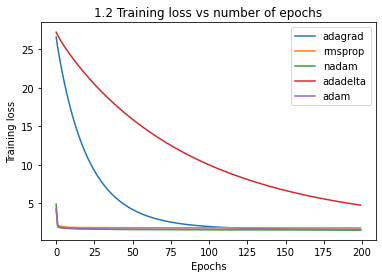

In [4]:
plt.plot(adagrad, label = "adagrad")
plt.plot(rmsprop, label = "rmsprop")
plt.plot(nadam, label = "nadam")
plt.plot(adadelta, label = "adadelta")
plt.plot(adam, label = "adam")
plt.legend()
plt.xlabel("Epochs")
plt.ylabel("Training loss")
plt.title("1.2 Training loss vs number of epochs")

As seen by the training loss, Adam or Nadam (RMSProp + Nesterov momentum) perform somewhat similar with Nadam outperforming slightly with least training loss.

In [58]:
# 1.3

In [ ]:
# Add dropout
#Preprocessing
(cifar_x_train, cifar_y_train), (cifar_x_test, cifar_y_test) = cifar10.load_data()

X_train = cifar_x_train.astype('float32') / 255
X_test = cifar_x_test.astype('float32') / 255

print('x_train shape:', X_train.shape)
print(X_train.shape[0], 'train samples')
print(X_test.shape[0], 'test samples')
print('y_train shape:', cifar_y_train.shape)

y_train = to_categorical(cifar_y_train)
y_test = to_categorical(cifar_y_test)

training_loss = []
time_taken = []
test_acc = []

print("start training")
#Adagrad
ada_opt = tf.keras.optimizers.Adagrad(
learning_rate=0.001, 
initial_accumulator_value=0.1, 
epsilon=1e-07,
name='Adagrad')
model1 = Sequential([
	Flatten(),
	Dropout(0.2),
	Dense(1000,activation='relu',kernel_regularizer='l2'),
	Dropout(0.5),
	Dense(1000,activation='relu',kernel_regularizer='l2'),
	Dropout(0.5),
	Dense(10, activation='softmax')])
model1.compile(loss='categorical_crossentropy', optimizer=ada_opt, metrics=['acc'])

start = time.time()
history1 = model1.fit(
	X_train, y_train, batch_size=128, epochs=200, validation_data=(X_test,y_test),shuffle=True,verbose=2)
end = time.time()
print('Adagrad: Training Time:',end-start,'seconds')
print('Adagrad: Training loss:',history1.history['loss'])
print('Adagrad: Val loss:',history1.history['val_loss'])
print('Adagrad: Training acc:',history1.history['acc'])
print('Adagrad: Val acc:',history1.history['val_acc'])
training_loss.append(history1.history['loss'])
time_taken.append(end-start)
test_acc.append(history1.history['val_acc'])


#RMSProp
rms_opt = tf.keras.optimizers.RMSprop(
    learning_rate=0.001,
    rho=0.9,
    momentum=0.0,
    epsilon=1e-07,
    centered=False,
    name="RMSprop")
model2 = Sequential([
	Flatten(),
	Dropout(0.2),
	Dense(1000,activation='relu',kernel_regularizer='l2'),
	Dropout(0.5),
	Dense(1000,activation='relu',kernel_regularizer='l2'),
	Dropout(0.5),
	Dense(10, activation='softmax')])
model2.compile(loss='categorical_crossentropy', optimizer=rms_opt, metrics=['acc'])

start = time.time()
history2 = model2.fit(
	X_train, y_train, batch_size=128, epochs=200, validation_data=(X_test,y_test),shuffle=True,verbose=2)
end = time.time()
print('RMSprop: Training Time:',end-start,'seconds')
print('RMSprop: Training loss:',history2.history['loss'])
print('RMSprop: Val loss:',history2.history['val_loss'])
print('RMSprop: Training acc:',history2.history['acc'])
print('RMSprop: Val acc:',history2.history['val_acc'])
training_loss.append(history2.history['loss'])
time_taken.append(end-start)
test_acc.append(history2.history['val_acc'])

#Nadam
rmr_nest_opt = tf.keras.optimizers.Nadam(
    learning_rate=0.001, beta_1=0.9, beta_2=0.999, epsilon=1e-07, name="Nadam")
model3 = Sequential([
	Flatten(),
	Dropout(0.2),
	Dense(1000,activation='relu',kernel_regularizer='l2'),
	Dropout(0.5),
	Dense(1000,activation='relu',kernel_regularizer='l2'),
	Dropout(0.5),
	Dense(10, activation='softmax')])
model3.compile(loss='categorical_crossentropy', optimizer=rmr_nest_opt, metrics=['acc'])

start = time.time()
history3 = model3.fit(
	X_train, y_train, batch_size=128, epochs=200, validation_data=(X_test,y_test),shuffle=True,verbose=2)
end = time.time()
print('RMSprop_nest: Training Time:',end-start,'seconds')
print('RMSprop_nest: Training loss:',history3.history['loss'])
print('RMSprop_nest: Val loss:',history3.history['val_loss'])
print('RMSprop_nest: Training acc:',history3.history['acc'])
print('RMSprop_nest: Val acc:',history3.history['val_acc'])
training_loss.append(history3.history['loss'])
time_taken.append(end-start)
test_acc.append(history3.history['val_acc'])


#AdaDelta
ada_delta_opt = tf.keras.optimizers.Adadelta(
    learning_rate=0.001, rho=0.95, epsilon=1e-07, name="Adadelta")
model4 = Sequential([
	Flatten(),
	Dropout(0.2),
	Dense(1000,activation='relu',kernel_regularizer='l2'),
	Dropout(0.5),
	Dense(1000,activation='relu',kernel_regularizer='l2'),
	Dropout(0.5),
	Dense(10, activation='softmax')])
model4.compile(loss='categorical_crossentropy', optimizer=ada_delta_opt, metrics=['acc'])

start = time.time()
history4 = model4.fit(
	X_train, y_train, batch_size=128, epochs=200, validation_data=(X_test,y_test),shuffle=True,verbose=2)
end = time.time()
print('AdaDelta: Training Time:',end-start,'seconds')
print('AdaDelta: Training loss:',history4.history['loss'])
print('AdaDelta: Val loss:',history4.history['val_loss'])
print('AdaDelta: Training acc:',history4.history['acc'])
print('AdaDelta: Val acc:',history4.history['val_acc'])
training_loss.append(history4.history['loss'])
time_taken.append(end-start)
test_acc.append(history4.history['val_acc'])



#Adam
adam_opt = tf.keras.optimizers.Adam(
    learning_rate=0.001,
    beta_1=0.9,
    beta_2=0.999,
    epsilon=1e-07,
    amsgrad=False,
    name="Adam")
model5 = Sequential([
	Flatten(),
	Dropout(0.2),
	Dense(1000,activation='relu',kernel_regularizer='l2'),
	Dropout(0.5),
	Dense(1000,activation='relu',kernel_regularizer='l2'),
	Dropout(0.5),
	Dense(10, activation='softmax')])
model5.compile(loss='categorical_crossentropy', optimizer=adam_opt, metrics=['acc'])

start = time.time()
history5 = model5.fit(
	X_train, y_train, batch_size=128, epochs=200, validation_data=(X_test,y_test),shuffle=True,verbose=2)
end = time.time()
print('Adam: Training Time:',end-start,'seconds')
print('Adam: Training loss:',history5.history['loss'])
print('Adam: Val loss:',history5.history['val_loss'])
print('Adam: Training acc:',history5.history['acc'])
print('Adam: Val acc:',history5.history['val_acc'])
training_loss.append(history5.history['loss'])
time_taken.append(end-start)
test_acc.append(history5.history['val_acc'])

with open("1c_trainig_loss", "w") as f:
    f.write(str(training_loss))
f.close()

with open("1c_time", "w") as f:
    f.write(str(time_taken))
f.close()

with open("1c_acc", "w") as f:
    f.write(str(test_acc))
f.close()

In [5]:
# Training loss
adagrad_dropout, rmsprop_dropout, nadam_dropout, adadelta_dropout, adam_dropout = [[26.85708236694336, 25.51253318786621, 24.344392776489258, 23.246763229370117, 22.21595573425293, 21.2398681640625, 20.32476806640625, 19.450271606445312, 18.628171920776367, 17.844165802001953, 17.101533889770508, 16.394332885742188, 15.722700119018555, 15.085667610168457, 14.482114791870117, 13.901312828063965, 13.353473663330078, 12.832762718200684, 12.33621597290039, 11.862284660339355, 11.41202163696289, 10.983338356018066, 10.574736595153809, 10.184517860412598, 9.815974235534668, 9.462715148925781, 9.125807762145996, 8.804924011230469, 8.497688293457031, 8.205405235290527, 7.926053047180176, 7.661471843719482, 7.407339572906494, 7.165597915649414, 6.9360480308532715, 6.716286659240723, 6.505921840667725, 6.304233074188232, 6.109738826751709, 5.930300712585449, 5.756712436676025, 5.588071823120117, 5.424696922302246, 5.275419235229492, 5.126476287841797, 4.98865270614624, 4.859054088592529, 4.728415012359619, 4.608214855194092, 4.492753982543945, 4.37937593460083, 4.275609493255615, 4.17327356338501, 4.073484897613525, 3.9794094562530518, 3.890087842941284, 3.8048105239868164, 3.725236654281616, 3.642251491546631, 3.570603132247925, 3.497305393218994, 3.431487560272217, 3.3648910522460938, 3.3006675243377686, 3.2398452758789062, 3.18186092376709, 3.127429485321045, 3.0742385387420654, 3.0224084854125977, 2.973672866821289, 2.9268319606781006, 2.8810596466064453, 2.8399906158447266, 2.796333074569702, 2.756909132003784, 2.7194035053253174, 2.6807303428649902, 2.64656662940979, 2.6156764030456543, 2.5809569358825684, 2.5506277084350586, 2.519155979156494, 2.4920847415924072, 2.4621381759643555, 2.439242124557495, 2.411926031112671, 2.385535717010498, 2.3630588054656982, 2.3404297828674316, 2.3181397914886475, 2.2999467849731445, 2.2778217792510986, 2.257714033126831, 2.2387619018554688, 2.2242438793182373, 2.206172466278076, 2.187481641769409, 2.1703414916992188, 2.1573472023010254, 2.1430399417877197, 2.1266849040985107, 2.1117568016052246, 2.099108934402466, 2.086980104446411, 2.0758931636810303, 2.0616302490234375, 2.049583911895752, 2.0400633811950684, 2.0277326107025146, 2.0192952156066895, 2.0085744857788086, 1.9980528354644775, 1.9888569116592407, 1.9822328090667725, 1.9731279611587524, 1.9641367197036743, 1.9550745487213135, 1.946889042854309, 1.9404603242874146, 1.930861234664917, 1.926123857498169, 1.9176901578903198, 1.9125744104385376, 1.9056808948516846, 1.9022865295410156, 1.893678069114685, 1.8881195783615112, 1.883187174797058, 1.876792550086975, 1.8715628385543823, 1.8672865629196167, 1.862139344215393, 1.8572121858596802, 1.8497443199157715, 1.8455944061279297, 1.8416597843170166, 1.8417404890060425, 1.8358815908432007, 1.8295683860778809, 1.8298498392105103, 1.8231022357940674, 1.8179240226745605, 1.8154182434082031, 1.8139164447784424, 1.8083070516586304, 1.8045015335083008, 1.8013209104537964, 1.7988468408584595, 1.7946696281433105, 1.7936230897903442, 1.7892041206359863, 1.7864490747451782, 1.7858624458312988, 1.7800759077072144, 1.7783634662628174, 1.7757079601287842, 1.777125597000122, 1.771982192993164, 1.771074652671814, 1.764565348625183, 1.7621910572052002, 1.764230489730835, 1.7617769241333008, 1.7594773769378662, 1.7588080167770386, 1.753941297531128, 1.752539038658142, 1.7515588998794556, 1.7480696439743042, 1.746439814567566, 1.7435301542282104, 1.7446428537368774, 1.7430438995361328, 1.7421648502349854, 1.73983895778656, 1.7362995147705078, 1.7365233898162842, 1.7348144054412842, 1.731729507446289, 1.7318446636199951, 1.7303661108016968, 1.7281043529510498, 1.7270309925079346, 1.7251520156860352, 1.7234152555465698, 1.7216503620147705, 1.7210428714752197, 1.720533847808838, 1.7213345766067505, 1.7190141677856445, 1.7187530994415283, 1.7153128385543823, 1.713844895362854, 1.7132341861724854, 1.7121204137802124, 1.7114651203155518, 1.7092397212982178, 1.708620309829712, 1.7084976434707642, 1.7078362703323364], [4.052689552307129, 2.2652721405029297, 2.244260311126709, 2.2237021923065186, 2.2004780769348145, 2.1697113513946533, 2.1456422805786133, 2.1393933296203613, 2.130262613296509, 2.123983383178711, 2.1271495819091797, 2.1230521202087402, 2.1227006912231445, 2.124746322631836, 2.117086172103882, 2.1192550659179688, 2.119454860687256, 2.116472005844116, 2.1213619709014893, 2.123318672180176, 2.1164822578430176, 2.119377851486206, 2.1177613735198975, 2.120349884033203, 2.1203367710113525, 2.1181864738464355, 2.1184980869293213, 2.1168413162231445, 2.1228103637695312, 2.119558811187744, 2.1188392639160156, 2.1220614910125732, 2.118748188018799, 2.1180355548858643, 2.124711275100708, 2.1246886253356934, 2.12087345123291, 2.117161989212036, 2.1232590675354004, 2.1201682090759277, 2.119033098220825, 2.1188924312591553, 2.1236627101898193, 2.1233301162719727, 2.120518445968628, 2.1218767166137695, 2.118807554244995, 2.116427421569824, 2.118758201599121, 2.117997884750366, 2.1218838691711426, 2.1203453540802, 2.124866485595703, 2.121431827545166, 2.120131731033325, 2.1203453540802, 2.1227328777313232, 2.1163735389709473, 2.120539426803589, 2.1240148544311523, 2.118324041366577, 2.1256747245788574, 2.1190316677093506, 2.1211793422698975, 2.1227385997772217, 2.1198270320892334, 2.1203882694244385, 2.1181907653808594, 2.118924617767334, 2.11531400680542, 2.1219990253448486, 2.1156790256500244, 2.119575262069702, 2.1210744380950928, 2.1193835735321045, 2.120746612548828, 2.11875057220459, 2.1192314624786377, 2.1227493286132812, 2.119130849838257, 2.1250722408294678, 2.1205456256866455, 2.118122100830078, 2.1215124130249023, 2.1216554641723633, 2.1239020824432373, 2.1178042888641357, 2.1195616722106934, 2.125464916229248, 2.1186728477478027, 2.120938777923584, 2.1201717853546143, 2.1209638118743896, 2.116661787033081, 2.121454954147339, 2.120593547821045, 2.119316816329956, 2.12082839012146, 2.121124505996704, 2.122398853302002, 2.1172893047332764, 2.120457649230957, 2.119178295135498, 2.120743989944458, 2.1179909706115723, 2.1208605766296387, 2.125703811645508, 2.120422124862671, 2.1224863529205322, 2.1231789588928223, 2.124131202697754, 2.12412166595459, 2.1240196228027344, 2.121943712234497, 2.126100540161133, 2.116461992263794, 2.1216304302215576, 2.122061014175415, 2.122389078140259, 2.1202406883239746, 2.126542091369629, 2.1233601570129395, 2.1207644939422607, 2.1218910217285156, 2.1216225624084473, 2.119262933731079, 2.1257991790771484, 2.1263649463653564, 2.1231918334960938, 2.125054121017456, 2.1234793663024902, 2.11854887008667, 2.120021343231201, 2.123534917831421, 2.1264190673828125, 2.121473789215088, 2.1178195476531982, 2.1222500801086426, 2.1232645511627197, 2.123673677444458, 2.1200835704803467, 2.1225273609161377, 2.119318723678589, 2.1218502521514893, 2.1205835342407227, 2.1200497150421143, 2.123809576034546, 2.122427225112915, 2.122682571411133, 2.1230103969573975, 2.125314474105835, 2.1235649585723877, 2.125394105911255, 2.1190667152404785, 2.1260366439819336, 2.127152919769287, 2.1222727298736572, 2.126735210418701, 2.120595693588257, 2.122643232345581, 2.118598461151123, 2.120549201965332, 2.126741647720337, 2.1199662685394287, 2.122737407684326, 2.1223621368408203, 2.1234538555145264, 2.121631622314453, 2.122246026992798, 2.1228997707366943, 2.12648606300354, 2.1284902095794678, 2.1254448890686035, 2.1195058822631836, 2.123661518096924, 2.1251628398895264, 2.1243152618408203, 2.125582456588745, 2.1215384006500244, 2.119049310684204, 2.126944065093994, 2.120412588119507, 2.1191914081573486, 2.1230273246765137, 2.1236391067504883, 2.1227190494537354, 2.123462677001953, 2.1265008449554443, 2.126810073852539, 2.124967575073242, 2.1267950534820557, 2.124671220779419, 2.126875162124634, 2.1255991458892822, 2.1261348724365234, 2.124342203140259, 2.123917579650879, 2.1278324127197266, 2.1274924278259277, 2.125581741333008], [4.805706977844238, 2.1287992000579834, 2.1054587364196777, 2.0920612812042236, 2.0833630561828613, 2.0724904537200928, 2.0702919960021973, 2.0669522285461426, 2.059535503387451, 2.0545122623443604, 2.050020933151245, 2.050926923751831, 2.054409980773926, 2.0502471923828125, 2.0463545322418213, 2.046332597732544, 2.0496838092803955, 2.059633493423462, 2.0467138290405273, 2.0559027194976807, 2.0573196411132812, 2.0460121631622314, 2.041778087615967, 2.0450520515441895, 2.04420804977417, 2.0391111373901367, 2.037235975265503, 2.0430614948272705, 2.0385522842407227, 2.0407495498657227, 2.0372679233551025, 2.0393078327178955, 2.0328261852264404, 2.0319607257843018, 2.033390760421753, 2.031827688217163, 2.0345892906188965, 2.046959638595581, 2.0420756340026855, 2.036062717437744, 2.03019380569458, 2.0339527130126953, 2.032583713531494, 2.031700849533081, 2.035250663757324, 2.0384247303009033, 2.0440549850463867, 2.048715353012085, 2.0524091720581055, 2.044121503829956, 2.0418732166290283, 2.041799545288086, 2.038609743118286, 2.04125714302063, 2.036054849624634, 2.044886827468872, 2.039897918701172, 2.0375630855560303, 2.0366384983062744, 2.0375125408172607, 2.0421221256256104, 2.043031930923462, 2.036674737930298, 2.038358688354492, 2.0508716106414795, 2.036097764968872, 2.0352940559387207, 2.0496573448181152, 2.043696165084839, 2.0372931957244873, 2.0392487049102783, 2.0540575981140137, 2.0527613162994385, 2.0495364665985107, 2.060441493988037, 2.0535573959350586, 2.048699140548706, 2.050677537918091, 2.0499958992004395, 2.048466444015503, 2.0453052520751953, 2.0453569889068604, 2.0423030853271484, 2.0477850437164307, 2.047818422317505, 2.0452616214752197, 2.043102741241455, 2.0480806827545166, 2.0615644454956055, 2.058333158493042, 2.053208827972412, 2.0486412048339844, 2.0431461334228516, 2.047456979751587, 2.0436148643493652, 2.0460612773895264, 2.0451412200927734, 2.046698808670044, 2.0436861515045166, 2.046959638595581, 2.0484814643859863, 2.041297674179077, 2.0437371730804443, 2.043834924697876, 2.044297218322754, 2.0475566387176514, 2.0421910285949707, 2.057225465774536, 2.0583574771881104, 2.0577750205993652, 2.0542633533477783, 2.0571510791778564, 2.0532617568969727, 2.0523505210876465, 2.0544140338897705, 2.0637736320495605, 2.058269739151001, 2.0572805404663086, 2.057695150375366, 2.052935838699341, 2.053508758544922, 2.076845407485962, 2.0593607425689697, 2.055253505706787, 2.0580484867095947, 2.0568244457244873, 2.055436372756958, 2.0578203201293945, 2.05210542678833, 2.0592594146728516, 2.0569727420806885, 2.0524559020996094, 2.058464765548706, 2.0546202659606934, 2.0565216541290283, 2.054353952407837, 2.051558017730713, 2.0497829914093018, 2.051706314086914, 2.057244300842285, 2.0520050525665283, 2.0578689575195312, 2.055593252182007, 2.0551865100860596, 2.0584490299224854, 2.054410696029663, 2.0542356967926025, 2.0676302909851074, 2.0739879608154297, 2.052908182144165, 2.051144599914551, 2.0529849529266357, 2.055720090866089, 2.057783365249634, 2.056283950805664, 2.0531883239746094, 2.0576844215393066, 2.0837018489837646, 2.0809266567230225, 2.0733706951141357, 2.072218179702759, 2.0703938007354736, 2.0712738037109375, 2.070481300354004, 2.064350128173828, 2.066535234451294, 2.069018840789795, 2.068160057067871, 2.0701045989990234, 2.0697922706604004, 2.0714921951293945, 2.069892168045044, 2.06868839263916, 2.070363759994507, 2.0732250213623047, 2.068906545639038, 2.0695674419403076, 2.067564010620117, 2.0701851844787598, 2.069087266921997, 2.0667271614074707, 2.069878578186035, 2.0689632892608643, 2.06613826751709, 2.074350118637085, 2.0762178897857666, 2.073406457901001, 2.0676422119140625, 2.073206663131714, 2.0686752796173096, 2.069720983505249, 2.081573009490967, 2.069701671600342, 2.074903964996338, 2.0687413215637207, 2.0663836002349854, 2.0731072425842285, 2.069192886352539, 2.0716538429260254, 2.0672035217285156], [27.57367706298828, 27.223159790039062, 26.94487190246582, 26.68141746520996, 26.426742553710938, 26.178598403930664, 25.932884216308594, 25.688989639282227, 25.451242446899414, 25.212995529174805, 24.97199249267578, 24.73805046081543, 24.504352569580078, 24.271432876586914, 24.04263687133789, 23.821178436279297, 23.59153938293457, 23.369600296020508, 23.14860725402832, 22.92670440673828, 22.71240997314453, 22.49912452697754, 22.290102005004883, 22.074520111083984, 21.873735427856445, 21.665725708007812, 21.462230682373047, 21.260908126831055, 21.0617733001709, 20.86478614807129, 20.67119598388672, 20.476125717163086, 20.287025451660156, 20.10176658630371, 19.916215896606445, 19.72646141052246, 19.54711151123047, 19.367103576660156, 19.187152862548828, 19.014909744262695, 18.840492248535156, 18.66446304321289, 18.499189376831055, 18.32691764831543, 18.164125442504883, 17.993118286132812, 17.833284378051758, 17.671228408813477, 17.512798309326172, 17.3521671295166, 17.199430465698242, 17.04585075378418, 16.89395523071289, 16.74004364013672, 16.594690322875977, 16.448150634765625, 16.301921844482422, 16.15593147277832, 16.014036178588867, 15.872507095336914, 15.734715461730957, 15.596965789794922, 15.458683967590332, 15.324813842773438, 15.188103675842285, 15.058431625366211, 14.925978660583496, 14.799217224121094, 14.670154571533203, 14.54232406616211, 14.418173789978027, 14.295355796813965, 14.173697471618652, 14.05183219909668, 13.934441566467285, 13.810761451721191, 13.695768356323242, 13.579072952270508, 13.465164184570312, 13.350794792175293, 13.237761497497559, 13.12795639038086, 13.01767349243164, 12.911001205444336, 12.800812721252441, 12.695870399475098, 12.58932113647461, 12.486845016479492, 12.38261604309082, 12.281880378723145, 12.178485870361328, 12.07644271850586, 11.97830581665039, 11.882781028747559, 11.78282356262207, 11.68629264831543, 11.593406677246094, 11.496859550476074, 11.403440475463867, 11.31198787689209, 11.22288703918457, 11.135234832763672, 11.040717124938965, 10.954585075378418, 10.864985466003418, 10.780599594116211, 10.69643783569336, 10.610010147094727, 10.527280807495117, 10.441743850708008, 10.362759590148926, 10.28300952911377, 10.20298957824707, 10.11949348449707, 10.039480209350586, 9.961511611938477, 9.890032768249512, 9.809435844421387, 9.73272705078125, 9.660425186157227, 9.58759593963623, 9.5135498046875, 9.44278335571289, 9.367603302001953, 9.297552108764648, 9.227553367614746, 9.157299041748047, 9.090182304382324, 9.022132873535156, 8.949932098388672, 8.885991096496582, 8.819945335388184, 8.752217292785645, 8.686674118041992, 8.625198364257812, 8.56100082397461, 8.497720718383789, 8.437713623046875, 8.373774528503418, 8.310606002807617, 8.251893997192383, 8.188504219055176, 8.130735397338867, 8.072017669677734, 8.014236450195312, 7.956131458282471, 7.897693157196045, 7.8467631340026855, 7.788686275482178, 7.733697414398193, 7.676334857940674, 7.623469352722168, 7.570284843444824, 7.516601085662842, 7.463551044464111, 7.4142255783081055, 7.361483097076416, 7.308302402496338, 7.259974479675293, 7.206246376037598, 7.161276817321777, 7.112102508544922, 7.062245845794678, 7.016274929046631, 6.96439790725708, 6.919785499572754, 6.872067451477051, 6.825959205627441, 6.782764911651611, 6.734155178070068, 6.688297271728516, 6.64502477645874, 6.601613521575928, 6.558187007904053, 6.517095565795898, 6.4698805809021, 6.429635047912598, 6.3861517906188965, 6.3437581062316895, 6.303490161895752, 6.267735004425049, 6.225743770599365, 6.186992645263672, 6.145978927612305, 6.103893756866455, 6.067250728607178, 6.028753757476807, 5.990234375, 5.953019142150879, 5.916846752166748, 5.877496719360352, 5.8429951667785645, 5.800163269042969, 5.769863128662109, 5.733082294464111, 5.702045440673828, 5.662803649902344, 5.627719879150391, 5.596687316894531, 5.561866283416748], [4.719033718109131, 2.190927743911743, 2.1179497241973877, 2.1179652214050293, 2.120684862136841, 2.121598958969116, 2.1293342113494873, 2.123645305633545, 2.1115615367889404, 2.103135347366333, 2.1194753646850586, 2.104994773864746, 2.106140613555908, 2.1102206707000732, 2.1065011024475098, 2.1198678016662598, 2.112931728363037, 2.1212127208709717, 2.1242218017578125, 2.136329412460327, 2.1298584938049316, 2.127591848373413, 2.1200199127197266, 2.1131653785705566, 2.1106362342834473, 2.1104257106781006, 2.1323349475860596, 2.103468179702759, 2.102475166320801, 2.104844331741333, 2.1014785766601562, 2.106275796890259, 2.1116275787353516, 2.1226799488067627, 2.1073055267333984, 2.102936029434204, 2.1205549240112305, 2.1033315658569336, 2.1081321239471436, 2.1060354709625244, 2.1033987998962402, 2.106867551803589, 2.096829414367676, 2.1005406379699707, 2.1035938262939453, 2.1147196292877197, 2.1001906394958496, 2.1223440170288086, 2.123689651489258, 2.1118407249450684, 2.1009716987609863, 2.10859751701355, 2.098752975463867, 2.1055686473846436, 2.10211181640625, 2.1137959957122803, 2.1174063682556152, 2.1014602184295654, 2.106740951538086, 2.1009509563446045, 2.1171836853027344, 2.1159613132476807, 2.1136162281036377, 2.1039247512817383, 2.098517417907715, 2.0983829498291016, 2.09826397895813, 2.1033787727355957, 2.105581760406494, 2.1015372276306152, 2.10465407371521, 2.1051442623138428, 2.1027565002441406, 2.099684238433838, 2.098985195159912, 2.098634958267212, 2.0977561473846436, 2.1093826293945312, 2.122490406036377, 2.1246769428253174, 2.1165575981140137, 2.1267149448394775, 2.1159751415252686, 2.119147300720215, 2.11460542678833, 2.115002155303955, 2.1327104568481445, 2.1249277591705322, 2.1183364391326904, 2.142590284347534, 2.1467018127441406, 2.1242637634277344, 2.1207218170166016, 2.1156342029571533, 2.1211230754852295, 2.117868423461914, 2.1166110038757324, 2.1208839416503906, 2.117806911468506, 2.1158206462860107, 2.113699197769165, 2.1176252365112305, 2.1108181476593018, 2.107067108154297, 2.124113082885742, 2.150160312652588, 2.1166884899139404, 2.123173713684082, 2.1191539764404297, 2.118823766708374, 2.1163952350616455, 2.1183714866638184, 2.130690336227417, 2.116138458251953, 2.1138813495635986, 2.1146156787872314, 2.1167211532592773, 2.1133358478546143, 2.115520477294922, 2.1170148849487305, 2.117616653442383, 2.1165406703948975, 2.1113038063049316, 2.115187168121338, 2.1178245544433594, 2.116755247116089, 2.117781162261963, 2.113502025604248, 2.1197004318237305, 2.117873191833496, 2.1197471618652344, 2.126392126083374, 2.1171886920928955, 2.1120500564575195, 2.117703676223755, 2.1146299839019775, 2.115614175796509, 2.1191704273223877, 2.1170859336853027, 2.122018575668335, 2.147289276123047, 2.118497133255005, 2.119277238845825, 2.119333028793335, 2.119046926498413, 2.1171669960021973, 2.120331048965454, 2.119074583053589, 2.1177937984466553, 2.1164300441741943, 2.1160778999328613, 2.1223983764648438, 2.117694616317749, 2.1216018199920654, 2.113616943359375, 2.1187071800231934, 2.1165947914123535, 2.1216609477996826, 2.11820650100708, 2.1224489212036133, 2.1182382106781006, 2.1168277263641357, 2.1192660331726074, 2.1210451126098633, 2.112673759460449, 2.1176133155822754, 2.1155877113342285, 2.114866018295288, 2.125627040863037, 2.1176180839538574, 2.1218202114105225, 2.121445655822754, 2.153118848800659, 2.1295974254608154, 2.116075277328491, 2.1238820552825928, 2.1193857192993164, 2.1126816272735596, 2.1127099990844727, 2.1236133575439453, 2.1144356727600098, 2.116190195083618, 2.1202352046966553, 2.1191232204437256, 2.1178760528564453, 2.1189160346984863, 2.115335702896118, 2.1211178302764893, 2.1138038635253906, 2.1150853633880615, 2.1288251876831055, 2.118504762649536, 2.120661973953247, 2.128056049346924, 2.1234800815582275, 2.115678310394287, 2.1215617656707764, 2.1169795989990234, 2.1256916522979736, 2.1489200592041016]]

Text(0.5, 1.0, '1.2 Training loss vs number of epochs')

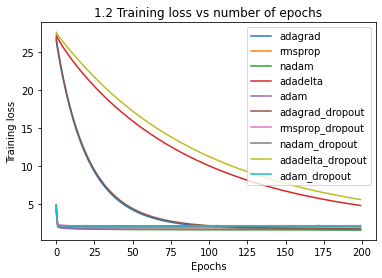

In [6]:
plt.plot(adagrad, label = "adagrad")
plt.plot(rmsprop, label = "rmsprop")
plt.plot(nadam, label = "nadam")
plt.plot(adadelta, label = "adadelta")
plt.plot(adam, label = "adam")
plt.plot(adagrad_dropout, label = "adagrad_dropout")
plt.plot(rmsprop_dropout, label = "rmsprop_dropout")
plt.plot(nadam_dropout, label = "nadam_dropout")
plt.plot(adadelta_dropout, label = "adadelta_dropout")
plt.plot(adam_dropout, label = "adam_dropout")
plt.legend()
plt.xlabel("Epochs")
plt.ylabel("Training loss")
plt.title("1.2 Training loss vs number of epochs")

In [7]:
end_loss1 = [adagrad[-1], rmsprop[-1], nadam[-1], adadelta[-1], adam[-1]]
end_loss2 = [adagrad_dropout[-1], rmsprop_dropout[-1], nadam_dropout[-1], adadelta_dropout[-1], adam_dropout[-1]]
end_loss1, end_loss2

([1.5876948833465576,
  1.839257001876831,
  1.5738762617111206,
  4.782144546508789,
  1.646365761756897],
 [1.7078362703323364,
  2.125581741333008,
  2.0672035217285156,
  5.561866283416748,
  2.1489200592041016])

By the end of 200 epochs, Nadam had the lowest training loss and adadelta with dropout had the highest.

In [8]:
# Training time
print("Training time in sec (from least to most):")
opt_times = {}
opt_times["adagrad"], opt_times["rmsprop"], opt_times["nadam"], opt_times["adadelta"], opt_times["adam"] = [323.38782238960266, 347.67018842697144, 396.74156427383423, 343.7491946220398, 344.56485247612]
opt_times["adagrad-dropout"], opt_times["rmsprop-dropout"], opt_times["nadam-dropout"], opt_times["adadelta-dropout"], opt_times["adam-dropout"] = [319.5095944404602, 383.7338750362396, 371.1512596607208, 323.3995943069458, 295.03810000419617]
dict(sorted(opt_times.items(), key=lambda item: item[1]))

Training time in sec (from least to most):


{'adam-dropout': 295.03810000419617,
 'adagrad-dropout': 319.5095944404602,
 'adagrad': 323.38782238960266,
 'adadelta-dropout': 323.3995943069458,
 'adadelta': 343.7491946220398,
 'adam': 344.56485247612,
 'rmsprop': 347.67018842697144,
 'nadam-dropout': 371.1512596607208,
 'rmsprop-dropout': 383.7338750362396,
 'nadam': 396.74156427383423}

Adam with dropout took the least training time and nadam took the most. Overall, optimisers with dropout took less training time than their vanilla counterparts.

In [ ]:
# 1.4

Dropout layer in Keras scales the weights automatically. Source: https://keras.io/api/layers/regularization_layers/dropout/

In [ ]:
test_acc = [[0.3183000087738037, 0.35179999470710754, 0.36579999327659607, 0.36800000071525574, 0.3815999925136566, 0.3912000060081482, 0.39719998836517334, 0.4027000069618225, 0.4034999907016754, 0.40450000762939453, 0.4065000116825104, 0.4140999913215637, 0.4180000126361847, 0.41510000824928284, 0.4156999886035919, 0.4242999851703644, 0.42590001225471497, 0.42239999771118164, 0.4262000024318695, 0.4251999855041504, 0.4250999987125397, 0.43160000443458557, 0.43140000104904175, 0.43479999899864197, 0.436599999666214, 0.4318000078201294, 0.43810001015663147, 0.4372999966144562, 0.43709999322891235, 0.4390000104904175, 0.43869999051094055, 0.4410000145435333, 0.44359999895095825, 0.44589999318122864, 0.4449999928474426, 0.44209998846054077, 0.44510000944137573, 0.44130000472068787, 0.4487999975681305, 0.44600000977516174, 0.44909998774528503, 0.4474000036716461, 0.45179998874664307, 0.4471000134944916, 0.45210000872612, 0.4528999924659729, 0.4498000144958496, 0.44510000944137573, 0.4551999866962433, 0.4562999904155731, 0.4562000036239624, 0.45829999446868896, 0.4544000029563904, 0.4586000144481659, 0.4535999894142151, 0.4602000117301941, 0.4578999876976013, 0.46140000224113464, 0.4584999978542328, 0.4569999873638153, 0.46160000562667847, 0.4632999897003174, 0.4602999985218048, 0.4607999920845032, 0.46480000019073486, 0.46369999647140503, 0.4674000144004822, 0.46309998631477356, 0.4684000015258789, 0.46239998936653137, 0.4668999910354614, 0.46470001339912415, 0.46790000796318054, 0.4620000123977661, 0.46779999136924744, 0.4645000100135803, 0.4706000089645386, 0.46880000829696655, 0.46959999203681946, 0.46389999985694885, 0.46860000491142273, 0.4740000069141388, 0.47440001368522644, 0.47269999980926514, 0.46959999203681946, 0.4756999909877777, 0.4724000096321106, 0.47450000047683716, 0.47589999437332153, 0.4754999876022339, 0.47369998693466187, 0.478300005197525, 0.4805000126361847, 0.4738999903202057, 0.47609999775886536, 0.48080000281333923, 0.48170000314712524, 0.47870001196861267, 0.4772999882698059, 0.47839999198913574, 0.48420000076293945, 0.4828000068664551, 0.47679999470710754, 0.48339998722076416, 0.4796000123023987, 0.48019999265670776, 0.4812000095844269, 0.4790000021457672, 0.48660001158714294, 0.48399999737739563, 0.4864000082015991, 0.48429998755455017, 0.487199991941452, 0.486299991607666, 0.4875999987125397, 0.48730000853538513, 0.4867999851703644, 0.4864000082015991, 0.4860000014305115, 0.4790000021457672, 0.4909999966621399, 0.490200012922287, 0.48899999260902405, 0.49000000953674316, 0.490200012922287, 0.491100013256073, 0.4880000054836273, 0.49390000104904175, 0.48980000615119934, 0.4814000129699707, 0.492900013923645, 0.49729999899864197, 0.48159998655319214, 0.48820000886917114, 0.4927000105381012, 0.48809999227523804, 0.49459999799728394, 0.4968000054359436, 0.49129998683929443, 0.49390000104904175, 0.4909000098705292, 0.49729999899864197, 0.49799999594688416, 0.49160000681877136, 0.4902999997138977, 0.4909000098705292, 0.4936999976634979, 0.5015000104904175, 0.5006999969482422, 0.5008999705314636, 0.49729999899864197, 0.4867999851703644, 0.49779999256134033, 0.49639999866485596, 0.5033000111579895, 0.5030999779701233, 0.49570000171661377, 0.49720001220703125, 0.5001999735832214, 0.5037999749183655, 0.504800021648407, 0.4991999864578247, 0.49720001220703125, 0.5001999735832214, 0.5022000074386597, 0.5062000155448914, 0.5038999915122986, 0.5013999938964844, 0.5052000284194946, 0.5024999976158142, 0.5037000179290771, 0.503600001335144, 0.5063999891281128, 0.5080000162124634, 0.5012000203132629, 0.5080999732017517, 0.5041000247001648, 0.506600022315979, 0.5049999952316284, 0.5012000203132629, 0.49959999322891235, 0.5026000142097473, 0.5023999810218811, 0.5020999908447266, 0.5060999989509583, 0.5016999840736389, 0.5098000168800354, 0.508400022983551, 0.5056999921798706, 0.5076000094413757, 0.5094000101089478, 0.5041999816894531, 0.5095999836921692, 0.5092999935150146, 0.5083000063896179, 0.5080999732017517, 0.5088000297546387, 0.5087000131607056, 0.5134999752044678, 0.507099986076355], [0.32260000705718994, 0.2554999887943268, 0.24390000104904175, 0.3296999931335449, 0.3176000118255615, 0.34540000557899475, 0.3495999872684479, 0.3853999972343445, 0.3001999855041504, 0.38280001282691956, 0.37720000743865967, 0.35269999504089355, 0.38359999656677246, 0.38370001316070557, 0.35899999737739563, 0.3488999903202057, 0.36169999837875366, 0.36820000410079956, 0.3515999913215637, 0.39890000224113464, 0.3831999897956848, 0.3831999897956848, 0.3628999888896942, 0.35429999232292175, 0.3531000018119812, 0.3066999912261963, 0.32690000534057617, 0.3149000108242035, 0.4074000120162964, 0.30559998750686646, 0.3262999951839447, 0.3366999924182892, 0.37709999084472656, 0.34380000829696655, 0.33880001306533813, 0.3741999864578247, 0.39100000262260437, 0.3546000123023987, 0.36419999599456787, 0.3716000020503998, 0.3255000114440918, 0.3799000084400177, 0.40059998631477356, 0.31850001215934753, 0.3278000056743622, 0.35580000281333923, 0.3662000000476837, 0.3806999921798706, 0.35740000009536743, 0.2937000095844269, 0.32420000433921814, 0.37540000677108765, 0.36570000648498535, 0.37770000100135803, 0.3853999972343445, 0.33649998903274536, 0.31520000100135803, 0.3206999897956848, 0.3871999979019165, 0.3776000142097473, 0.35670000314712524, 0.3824000060558319, 0.3188999891281128, 0.3783999979496002, 0.375900000333786, 0.37790000438690186, 0.3546999990940094, 0.3612000048160553, 0.38670000433921814, 0.3971000015735626, 0.34869998693466187, 0.32260000705718994, 0.3970000147819519, 0.36329999566078186, 0.3212999999523163, 0.34389999508857727, 0.34299999475479126, 0.36880001425743103, 0.3643999993801117, 0.3833000063896179, 0.3747999966144562, 0.3587999939918518, 0.2888999879360199, 0.36390000581741333, 0.3772999942302704, 0.3662000000476837, 0.35339999198913574, 0.35920000076293945, 0.33180001378059387, 0.3359000086784363, 0.38519999384880066, 0.40799999237060547, 0.3977999985218048, 0.39570000767707825, 0.3370000123977661, 0.3441999852657318, 0.35670000314712524, 0.3853999972343445, 0.39250001311302185, 0.37599998712539673, 0.365200012922287, 0.37299999594688416, 0.3465000092983246, 0.33880001306533813, 0.3684999942779541, 0.35269999504089355, 0.36309999227523804, 0.3637999892234802, 0.36959999799728394, 0.35530000925064087, 0.36390000581741333, 0.3659999966621399, 0.35580000281333923, 0.35899999737739563, 0.3662000000476837, 0.35920000076293945, 0.3677000105381012, 0.382999986410141, 0.40799999237060547, 0.3682999908924103, 0.3305000066757202, 0.33480000495910645, 0.2808000147342682, 0.3953999876976013, 0.3273000121116638, 0.3488999903202057, 0.32519999146461487, 0.3571000099182129, 0.3361000120639801, 0.3425000011920929, 0.33239999413490295, 0.39100000262260437, 0.3707999885082245, 0.3921999931335449, 0.37630000710487366, 0.36000001430511475, 0.3806000053882599, 0.4106999933719635, 0.32739999890327454, 0.3465999960899353, 0.38940000534057617, 0.3894999921321869, 0.39149999618530273, 0.358599990606308, 0.3382999897003174, 0.3221000134944916, 0.3666999936103821, 0.357699990272522, 0.39750000834465027, 0.41350001096725464, 0.31520000100135803, 0.40610000491142273, 0.2700999975204468, 0.3411000072956085, 0.3874000012874603, 0.3675000071525574, 0.29660001397132874, 0.3917999863624573, 0.36039999127388, 0.3765000104904175, 0.3928999900817871, 0.3546000123023987, 0.39410001039505005, 0.2831999957561493, 0.3871000111103058, 0.39660000801086426, 0.39969998598098755, 0.3571000099182129, 0.32519999146461487, 0.3061000108718872, 0.39239999651908875, 0.3707999885082245, 0.36800000071525574, 0.33739998936653137, 0.3562999963760376, 0.3788999915122986, 0.35830000042915344, 0.3359000086784363, 0.2906000018119812, 0.3504999876022339, 0.40529999136924744, 0.4138999879360199, 0.38089999556541443, 0.31619998812675476, 0.3125999867916107, 0.30730000138282776, 0.3691999912261963, 0.36320000886917114, 0.37689998745918274, 0.361299991607666, 0.3847000002861023, 0.3276999890804291, 0.33899998664855957, 0.3882000148296356, 0.3634999990463257, 0.34709998965263367, 0.396699994802475, 0.3828999996185303, 0.38350000977516174, 0.3684000074863434], [0.322299987077713, 0.37070000171661377, 0.36250001192092896, 0.3783999979496002, 0.39259999990463257, 0.3763999938964844, 0.40549999475479126, 0.38830000162124634, 0.2833999991416931, 0.38190001249313354, 0.4034000039100647, 0.41589999198913574, 0.3767000138759613, 0.43549999594688416, 0.41130000352859497, 0.43479999899864197, 0.4318000078201294, 0.4406999945640564, 0.4106000065803528, 0.4447999894618988, 0.4056999981403351, 0.429500013589859, 0.43560001254081726, 0.43529999256134033, 0.37459999322891235, 0.4390000104904175, 0.4514999985694885, 0.4433000087738037, 0.4194999933242798, 0.4530999958515167, 0.42989999055862427, 0.4447000026702881, 0.44510000944137573, 0.44839999079704285, 0.43950000405311584, 0.43720000982284546, 0.4496999979019165, 0.44830000400543213, 0.42590001225471497, 0.45210000872612, 0.4555000066757202, 0.44440001249313354, 0.4374000132083893, 0.4569999873638153, 0.44760000705718994, 0.44699999690055847, 0.4440000057220459, 0.445499986410141, 0.45719999074935913, 0.4413999915122986, 0.44609999656677246, 0.43140000104904175, 0.45989999175071716, 0.4555000066757202, 0.45010000467300415, 0.4458000063896179, 0.45660001039505005, 0.45890000462532043, 0.444599986076355, 0.4519999921321869, 0.4318999946117401, 0.4327000081539154, 0.4374000132083893, 0.4399999976158142, 0.4564000070095062, 0.4551999866962433, 0.46230000257492065, 0.42480000853538513, 0.44179999828338623, 0.4374000132083893, 0.4293000102043152, 0.4674000144004822, 0.44119998812675476, 0.4603999853134155, 0.4431000053882599, 0.44859999418258667, 0.45210000872612, 0.44519999623298645, 0.4562999904155731, 0.45339998602867126, 0.4413999915122986, 0.4440000057220459, 0.427700012922287, 0.454800009727478, 0.40059998631477356, 0.4471000134944916, 0.44699999690055847, 0.45809999108314514, 0.4625999927520752, 0.4503999948501587, 0.4456000030040741, 0.44940000772476196, 0.4618000090122223, 0.43939998745918274, 0.4399999976158142, 0.4406000077724457, 0.45419999957084656, 0.4620000123977661, 0.44909998774528503, 0.4715999960899353, 0.45590001344680786, 0.4611999988555908, 0.453000009059906, 0.4366999864578247, 0.45680001378059387, 0.44760000705718994, 0.45100000500679016, 0.4472000002861023, 0.45750001072883606, 0.43790000677108765, 0.45019999146461487, 0.44679999351501465, 0.45980000495910645, 0.444599986076355, 0.4284000098705292, 0.46230000257492065, 0.45969998836517334, 0.4578999876976013, 0.46700000762939453, 0.44920000433921814, 0.4417000114917755, 0.4410000145435333, 0.46059998869895935, 0.46790000796318054, 0.384799987077713, 0.44369998574256897, 0.4634999930858612, 0.4618000090122223, 0.4309000074863434, 0.46050000190734863, 0.44190001487731934, 0.4489000141620636, 0.43540000915527344, 0.436599999666214, 0.4537000060081482, 0.4571000039577484, 0.45579999685287476, 0.45590001344680786, 0.46050000190734863, 0.4530999958515167, 0.4596000015735626, 0.4722999930381775, 0.461899995803833, 0.4632999897003174, 0.4634999930858612, 0.4661000072956085, 0.44670000672340393, 0.4602000117301941, 0.4683000147342682, 0.46720001101493835, 0.4499000012874603, 0.4447999894618988, 0.4537000060081482, 0.4578000009059906, 0.45680001378059387, 0.43720000982284546, 0.4399999976158142, 0.413100004196167, 0.4740000069141388, 0.45500001311302185, 0.4587000012397766, 0.46639999747276306, 0.47450000047683716, 0.44999998807907104, 0.47769999504089355, 0.4325000047683716, 0.477400004863739, 0.4603999853134155, 0.44609999656677246, 0.45419999957084656, 0.45660001039505005, 0.47290000319480896, 0.4523000121116638, 0.43720000982284546, 0.46399998664855957, 0.46549999713897705, 0.45680001378059387, 0.4632999897003174, 0.44999998807907104, 0.45190000534057617, 0.44760000705718994, 0.4666999876499176, 0.42080000042915344, 0.4343999922275543, 0.4490000009536743, 0.462799996137619, 0.45100000500679016, 0.4726000130176544, 0.4586000144481659, 0.4361000061035156, 0.46630001068115234, 0.4584999978542328, 0.435699999332428, 0.45089998841285706, 0.45579999685287476, 0.435699999332428, 0.445499986410141, 0.4578999876976013, 0.4410000145435333, 0.45329999923706055], [0.2337000072002411, 0.27810001373291016, 0.29919999837875366, 0.3093999922275543, 0.32339999079704285, 0.32760000228881836, 0.3402000069618225, 0.34119999408721924, 0.3488999903202057, 0.3529999852180481, 0.3564999997615814, 0.3596000075340271, 0.362199991941452, 0.36579999327659607, 0.3666999936103821, 0.367900013923645, 0.36970001459121704, 0.3741999864578247, 0.37310001254081726, 0.3734999895095825, 0.37860000133514404, 0.375900000333786, 0.38119998574256897, 0.38190001249313354, 0.3815999925136566, 0.38260000944137573, 0.384799987077713, 0.3869999945163727, 0.38510000705718994, 0.38580000400543213, 0.3912000060081482, 0.3921000063419342, 0.39100000262260437, 0.39329999685287476, 0.39329999685287476, 0.3944000005722046, 0.3959999978542328, 0.3968000113964081, 0.3971000015735626, 0.3995000123977661, 0.39559999108314514, 0.4027000069618225, 0.4018000066280365, 0.40400001406669617, 0.4043999910354614, 0.40299999713897705, 0.4052000045776367, 0.40310001373291016, 0.4074000120162964, 0.4075999855995178, 0.4072999954223633, 0.4050000011920929, 0.40950000286102295, 0.40950000286102295, 0.4092999994754791, 0.4097999930381775, 0.4099999964237213, 0.41350001096725464, 0.41029998660087585, 0.4106999933719635, 0.4138999879360199, 0.41510000824928284, 0.41530001163482666, 0.4154999852180481, 0.4156999886035919, 0.414900004863739, 0.41760000586509705, 0.4156000018119812, 0.41760000586509705, 0.41670000553131104, 0.4156000018119812, 0.4171999990940094, 0.41929998993873596, 0.41990000009536743, 0.4185999929904938, 0.4205999970436096, 0.41909998655319214, 0.41929998993873596, 0.4205000102519989, 0.42149999737739563, 0.42239999771118164, 0.4237000048160553, 0.4212000072002411, 0.42179998755455017, 0.4226999878883362, 0.4212999939918518, 0.42260000109672546, 0.42489999532699585, 0.4242999851703644, 0.4239000082015991, 0.42500001192092896, 0.4244999885559082, 0.42320001125335693, 0.4268999993801117, 0.4253000020980835, 0.42660000920295715, 0.42660000920295715, 0.4262999892234802, 0.4262000024318695, 0.42579999566078186, 0.427700012922287, 0.42719998955726624, 0.42669999599456787, 0.42829999327659607, 0.42820000648498535, 0.42969998717308044, 0.4311999976634979, 0.42829999327659607, 0.43050000071525574, 0.43070000410079956, 0.4293999969959259, 0.4309000074863434, 0.4309999942779541, 0.4318000078201294, 0.4311999976634979, 0.43220001459121704, 0.4311000108718872, 0.4311999976634979, 0.4334999918937683, 0.4334000051021576, 0.43320000171661377, 0.43380001187324524, 0.43389999866485596, 0.4327000081539154, 0.4320000112056732, 0.4345000088214874, 0.43459999561309814, 0.4359999895095825, 0.436599999666214, 0.435699999332428, 0.43709999322891235, 0.436599999666214, 0.43540000915527344, 0.4352000057697296, 0.436599999666214, 0.43810001015663147, 0.43799999356269836, 0.43779999017715454, 0.4377000033855438, 0.4377000033855438, 0.43860000371932983, 0.4383000135421753, 0.4399000108242035, 0.44020000100135803, 0.43849998712539673, 0.43950000405311584, 0.4381999969482422, 0.4406000077724457, 0.44040000438690186, 0.4406999945640564, 0.44200000166893005, 0.4429999887943268, 0.44119998812675476, 0.4431000053882599, 0.4417000114917755, 0.44200000166893005, 0.4413999915122986, 0.44190001487731934, 0.44119998812675476, 0.4417000114917755, 0.4408000111579895, 0.44350001215934753, 0.4456999897956848, 0.4431000053882599, 0.4431999921798706, 0.44290000200271606, 0.4422999918460846, 0.4458000063896179, 0.4442000091075897, 0.44359999895095825, 0.4447999894618988, 0.444599986076355, 0.44440001249313354, 0.44440001249313354, 0.4458000063896179, 0.4447999894618988, 0.4447999894618988, 0.44589999318122864, 0.44600000977516174, 0.444599986076355, 0.4462999999523163, 0.4465000033378601, 0.4472000002861023, 0.44609999656677246, 0.44760000705718994, 0.44699999690055847, 0.4481000006198883, 0.447299987077713, 0.44679999351501465, 0.4487000107765198, 0.44769999384880066, 0.4494999945163727, 0.4498000144958496, 0.44670000672340393, 0.4487000107765198, 0.4496000111103058, 0.45010000467300415, 0.45089998841285706, 0.4490000009536743, 0.4489000141620636], [0.3750999867916107, 0.3801000118255615, 0.3736000061035156, 0.39719998836517334, 0.40220001339912415, 0.42309999465942383, 0.4108000099658966, 0.3935999870300293, 0.41130000352859497, 0.39719998836517334, 0.4262000024318695, 0.4203000068664551, 0.39730000495910645, 0.44130000472068787, 0.4332999885082245, 0.4381999969482422, 0.4284000098705292, 0.41999998688697815, 0.41449999809265137, 0.4251999855041504, 0.42170000076293945, 0.4000999927520752, 0.4307999908924103, 0.4259999990463257, 0.43299999833106995, 0.4359000027179718, 0.4413999915122986, 0.4235999882221222, 0.4011000096797943, 0.44020000100135803, 0.4431000053882599, 0.45730000734329224, 0.4196000099182129, 0.4413999915122986, 0.4101000130176544, 0.4555000066757202, 0.454800009727478, 0.4361000061035156, 0.44749999046325684, 0.42309999465942383, 0.4278999865055084, 0.4415999948978424, 0.4359999895095825, 0.43970000743865967, 0.44609999656677246, 0.4325000047683716, 0.4341999888420105, 0.4138000011444092, 0.4207000136375427, 0.4424999952316284, 0.4521999955177307, 0.42329999804496765, 0.4311000108718872, 0.4392000138759613, 0.4489000141620636, 0.4596000015735626, 0.3903999924659729, 0.4426000118255615, 0.44690001010894775, 0.45399999618530273, 0.42899999022483826, 0.43950000405311584, 0.4323999881744385, 0.44339999556541443, 0.43149998784065247, 0.4487999975681305, 0.43849998712539673, 0.4609000086784363, 0.44200000166893005, 0.4560000002384186, 0.4489000141620636, 0.4528000056743622, 0.4332999885082245, 0.4323999881744385, 0.44999998807907104, 0.42640000581741333, 0.4546000063419342, 0.4442000091075897, 0.43959999084472656, 0.43230000138282776, 0.44110000133514404, 0.45419999957084656, 0.45840001106262207, 0.4075999855995178, 0.4546000063419342, 0.45739999413490295, 0.4350000023841858, 0.44209998846054077, 0.461899995803833, 0.3968999981880188, 0.4496999979019165, 0.4309000074863434, 0.4203000068664551, 0.4269999861717224, 0.4456999897956848, 0.44690001010894775, 0.44290000200271606, 0.44909998774528503, 0.44429999589920044, 0.4577000141143799, 0.4327999949455261, 0.4510999917984009, 0.462799996137619, 0.4474000036716461, 0.4352000057697296, 0.4426000118255615, 0.4341999888420105, 0.42480000853538513, 0.43959999084472656, 0.45010000467300415, 0.44600000977516174, 0.45339998602867126, 0.4514999985694885, 0.44350001215934753, 0.45339998602867126, 0.4311000108718872, 0.4341000020503998, 0.4207000136375427, 0.44699999690055847, 0.44760000705718994, 0.46000000834465027, 0.4106999933719635, 0.43230000138282776, 0.40790000557899475, 0.44920000433921814, 0.4302999973297119, 0.43470001220703125, 0.4481000006198883, 0.4571000039577484, 0.46320000290870667, 0.4453999996185303, 0.42500001192092896, 0.4343999922275543, 0.46320000290870667, 0.4415000081062317, 0.4408999979496002, 0.4406000077724457, 0.4334000051021576, 0.4553000032901764, 0.4537999927997589, 0.42890000343322754, 0.45010000467300415, 0.45080000162124634, 0.44350001215934753, 0.4169999957084656, 0.43880000710487366, 0.42879998683929443, 0.41290000081062317, 0.4311000108718872, 0.4555000066757202, 0.4465999901294708, 0.45500001311302185, 0.44999998807907104, 0.43309998512268066, 0.447299987077713, 0.4399999976158142, 0.44359999895095825, 0.4481000006198883, 0.44200000166893005, 0.4334000051021576, 0.43140000104904175, 0.4462999999523163, 0.4440999925136566, 0.4426000118255615, 0.4471000134944916, 0.43309998512268066, 0.4429999887943268, 0.44749999046325684, 0.4169999957084656, 0.45410001277923584, 0.4388999938964844, 0.44620001316070557, 0.4523000121116638, 0.45809999108314514, 0.41909998655319214, 0.4381999969482422, 0.4521999955177307, 0.43479999899864197, 0.45339998602867126, 0.4239000082015991, 0.4090000092983246, 0.4447000026702881, 0.4433000087738037, 0.44369998574256897, 0.4212000072002411, 0.4494999945163727, 0.444599986076355, 0.45100000500679016, 0.4343000054359436, 0.45249998569488525, 0.4505000114440918, 0.44119998812675476, 0.44760000705718994, 0.4553000032901764, 0.4345000088214874, 0.4609000086784363, 0.4449000060558319, 0.4368000030517578, 0.4381999969482422, 0.45170000195503235]]

In [10]:
# Test accuracy
test_acc = np.array(test_acc)
test_acc_dropout = [[0.28130000829696655, 0.28940001130104065, 0.3037000000476837, 0.3174000084400177, 0.3231000006198883, 0.32910001277923584, 0.337799996137619, 0.3418999910354614, 0.349700003862381, 0.3499999940395355, 0.35580000281333923, 0.35429999232292175, 0.3587000072002411, 0.3626999855041504, 0.36419999599456787, 0.3686999976634979, 0.36320000886917114, 0.36739999055862427, 0.37070000171661377, 0.3749000132083893, 0.3788999915122986, 0.3707999885082245, 0.37560001015663147, 0.38280001282691956, 0.3880000114440918, 0.3873000144958496, 0.38749998807907104, 0.3928000032901764, 0.3937999904155731, 0.3944000005722046, 0.3912999927997589, 0.39559999108314514, 0.4009000062942505, 0.39739999175071716, 0.4000000059604645, 0.40779998898506165, 0.40310001373291016, 0.4083000123500824, 0.4083999991416931, 0.4075999855995178, 0.4138999879360199, 0.41029998660087585, 0.41190001368522644, 0.4140999913215637, 0.41370001435279846, 0.41350001096725464, 0.41440001130104065, 0.41769999265670776, 0.4180999994277954, 0.4189000129699707, 0.4198000133037567, 0.42320001125335693, 0.42170000076293945, 0.42329999804496765, 0.4239000082015991, 0.4262000024318695, 0.42969998717308044, 0.4293999969959259, 0.42419999837875366, 0.43070000410079956, 0.43209999799728394, 0.4291999936103821, 0.43230000138282776, 0.4343999922275543, 0.4348999857902527, 0.43720000982284546, 0.4341000020503998, 0.4392000138759613, 0.436599999666214, 0.4388999938964844, 0.4399999976158142, 0.4401000142097473, 0.4408000111579895, 0.44179999828338623, 0.44029998779296875, 0.44119998812675476, 0.4424999952316284, 0.44190001487731934, 0.44179999828338623, 0.44429999589920044, 0.4456999897956848, 0.4449000060558319, 0.4453999996185303, 0.4505999982357025, 0.4478999972343445, 0.4472000002861023, 0.44780001044273376, 0.44429999589920044, 0.44769999384880066, 0.4496000111103058, 0.451200008392334, 0.45010000467300415, 0.451200008392334, 0.4526999890804291, 0.45210000872612, 0.4514000117778778, 0.453000009059906, 0.45500001311302185, 0.45489999651908875, 0.4553000032901764, 0.45410001277923584, 0.4546999931335449, 0.45489999651908875, 0.4555000066757202, 0.45809999108314514, 0.4602999985218048, 0.45890000462532043, 0.460099995136261, 0.4603999853134155, 0.4620000123977661, 0.46129998564720154, 0.460999995470047, 0.4602000117301941, 0.4602000117301941, 0.46160000562667847, 0.4641999900341034, 0.4616999924182892, 0.4634000062942505, 0.4632999897003174, 0.4629000127315521, 0.46549999713897705, 0.4661000072956085, 0.4652999937534332, 0.46630001068115234, 0.4661000072956085, 0.4672999978065491, 0.4659999907016754, 0.4650999903678894, 0.46239998936653137, 0.46540001034736633, 0.46709999442100525, 0.46880000829696655, 0.4666000008583069, 0.4659000039100647, 0.4693000018596649, 0.46880000829696655, 0.47119998931884766, 0.4715000092983246, 0.46959999203681946, 0.46939998865127563, 0.4708999991416931, 0.4715999960899353, 0.46950000524520874, 0.4733999967575073, 0.4724999964237213, 0.4706000089645386, 0.4717999994754791, 0.4722999930381775, 0.47279998660087585, 0.47380000352859497, 0.47369998693466187, 0.4726000130176544, 0.4738999903202057, 0.47279998660087585, 0.47600001096725464, 0.47189998626708984, 0.475600004196167, 0.47600001096725464, 0.476500004529953, 0.4787999987602234, 0.47440001368522644, 0.4772000014781952, 0.4772999882698059, 0.4763000011444092, 0.47679999470710754, 0.48179998993873596, 0.47780001163482666, 0.4747999906539917, 0.47620001435279846, 0.47679999470710754, 0.4799000024795532, 0.48010000586509705, 0.4787999987602234, 0.4772000014781952, 0.47920000553131104, 0.47929999232292175, 0.48100000619888306, 0.48179998993873596, 0.4803999960422516, 0.48100000619888306, 0.4794999957084656, 0.4805000126361847, 0.4763000011444092, 0.48249998688697815, 0.4781000018119812, 0.48030000925064087, 0.48330000042915344, 0.4823000133037567, 0.48399999737739563, 0.48350000381469727, 0.48170000314712524, 0.48010000586509705, 0.483599990606308, 0.48069998621940613, 0.4851999878883362, 0.48240000009536743, 0.48510000109672546, 0.4862000048160553, 0.4828000068664551, 0.4869000017642975], [0.19210000336170197, 0.2921999990940094, 0.23759999871253967, 0.3019999861717224, 0.2752000093460083, 0.2492000013589859, 0.2500999867916107, 0.31859999895095825, 0.2434999942779541, 0.28110000491142273, 0.27140000462532043, 0.3149999976158142, 0.2599000036716461, 0.29019999504089355, 0.2802000045776367, 0.20960000157356262, 0.2475000023841858, 0.3018999993801117, 0.29980000853538513, 0.27900001406669617, 0.2492000013589859, 0.24150000512599945, 0.24959999322891235, 0.2759000062942505, 0.31380000710487366, 0.23559999465942383, 0.30309998989105225, 0.2345000058412552, 0.25060001015663147, 0.27399998903274536, 0.27390000224113464, 0.3100999891757965, 0.22519999742507935, 0.2703000009059906, 0.24220000207424164, 0.2644999921321869, 0.26930001378059387, 0.3163999915122986, 0.3050999939441681, 0.25850000977516174, 0.24940000474452972, 0.2745000123977661, 0.24699999392032623, 0.2831999957561493, 0.20319999754428864, 0.25780001282691956, 0.27239999175071716, 0.2531000077724457, 0.2897000014781952, 0.2587999999523163, 0.2802000045776367, 0.23350000381469727, 0.2962000072002411, 0.2624000012874603, 0.29019999504089355, 0.24709999561309814, 0.30390000343322754, 0.21770000457763672, 0.3181000053882599, 0.2973000109195709, 0.21639999747276306, 0.30410000681877136, 0.3172000050544739, 0.2508000135421753, 0.2971999943256378, 0.22130000591278076, 0.26080000400543213, 0.24580000340938568, 0.23399999737739563, 0.21559999883174896, 0.2669999897480011, 0.3050999939441681, 0.30630001425743103, 0.3084999918937683, 0.23929999768733978, 0.27059999108314514, 0.272599995136261, 0.2590000033378601, 0.26589998602867126, 0.26649999618530273, 0.2630000114440918, 0.24040000140666962, 0.27379998564720154, 0.2842999994754791, 0.28450000286102295, 0.24040000140666962, 0.29580000042915344, 0.29809999465942383, 0.2879999876022339, 0.22609999775886536, 0.2409999966621399, 0.25360000133514404, 0.25220000743865967, 0.29319998621940613, 0.22419999539852142, 0.2605000138282776, 0.2827000021934509, 0.2897000014781952, 0.28360000252723694, 0.23499999940395355, 0.2694000005722046, 0.2842000126838684, 0.2881999909877777, 0.29750001430511475, 0.28380000591278076, 0.2289000004529953, 0.3188999891281128, 0.2962999939918518, 0.25589999556541443, 0.25839999318122864, 0.29589998722076416, 0.2702000141143799, 0.28119999170303345, 0.2630000114440918, 0.24160000681877136, 0.2978000044822693, 0.2980000078678131, 0.24009999632835388, 0.21649999916553497, 0.27709999680519104, 0.30379998683929443, 0.2542000114917755, 0.30169999599456787, 0.27000001072883606, 0.2847000062465668, 0.2502000033855438, 0.27559998631477356, 0.2386000007390976, 0.28049999475479126, 0.23260000348091125, 0.2906000018119812, 0.27160000801086426, 0.26109999418258667, 0.27959999442100525, 0.262800008058548, 0.25519999861717224, 0.2883000075817108, 0.27630001306533813, 0.26440000534057617, 0.25609999895095825, 0.2551000118255615, 0.27140000462532043, 0.25619998574256897, 0.26499998569488525, 0.27320000529289246, 0.2906999886035919, 0.2766000032424927, 0.290800005197525, 0.28349998593330383, 0.28450000286102295, 0.28349998593330383, 0.2793999910354614, 0.2498999983072281, 0.2249000072479248, 0.2565999925136566, 0.2775999903678894, 0.271699994802475, 0.2718000113964081, 0.24709999561309814, 0.2752000093460083, 0.2946000099182129, 0.288100004196167, 0.22390000522136688, 0.22349999845027924, 0.2953000068664551, 0.28459998965263367, 0.273499995470047, 0.2549999952316284, 0.2800999879837036, 0.26019999384880066, 0.2858000099658966, 0.26600000262260437, 0.26179999113082886, 0.2777000069618225, 0.2865999937057495, 0.2606000006198883, 0.2842000126838684, 0.267300009727478, 0.2937999963760376, 0.27730000019073486, 0.2754000127315521, 0.250900000333786, 0.29580000042915344, 0.28519999980926514, 0.29910001158714294, 0.22210000455379486, 0.2492000013589859, 0.24130000174045563, 0.28439998626708984, 0.23010000586509705, 0.25200000405311584, 0.3043000102043152, 0.2797999978065491, 0.2687000036239624, 0.265500009059906, 0.2515999972820282, 0.25279998779296875, 0.2563999891281128, 0.2554999887943268, 0.25], [0.21060000360012054, 0.3095000088214874, 0.27160000801086426, 0.28209999203681946, 0.3010999858379364, 0.2535000145435333, 0.2581999897956848, 0.30790001153945923, 0.2847999930381775, 0.329800009727478, 0.2736000120639801, 0.29809999465942383, 0.30799999833106995, 0.3147999942302704, 0.3057999908924103, 0.2809999883174896, 0.301800012588501, 0.2863999903202057, 0.28220000863075256, 0.30790001153945923, 0.28630000352859497, 0.3075999915599823, 0.26579999923706055, 0.28790000081062317, 0.2809000015258789, 0.30410000681877136, 0.2847000062465668, 0.27480000257492065, 0.2838999927043915, 0.29829999804496765, 0.26899999380111694, 0.2766999900341034, 0.29089999198913574, 0.3061000108718872, 0.27630001306533813, 0.2919999957084656, 0.29190000891685486, 0.24539999663829803, 0.26489999890327454, 0.3102000057697296, 0.2824000120162964, 0.2865999937057495, 0.3084999918937683, 0.28299999237060547, 0.30820000171661377, 0.24529999494552612, 0.27900001406669617, 0.262800008058548, 0.2709999978542328, 0.24740000069141388, 0.26100000739097595, 0.2867000102996826, 0.2700999975204468, 0.2660999894142151, 0.26409998536109924, 0.27320000529289246, 0.2768999934196472, 0.28189998865127563, 0.303600013256073, 0.3034999966621399, 0.2822999954223633, 0.30469998717308044, 0.2660999894142151, 0.3043999969959259, 0.2768000066280365, 0.2992999851703644, 0.2759999930858612, 0.27970001101493835, 0.2773999869823456, 0.28290000557899475, 0.2784000039100647, 0.27720001339912415, 0.23890000581741333, 0.2696000039577484, 0.24560000002384186, 0.25110000371932983, 0.2703999876976013, 0.2680000066757202, 0.2906000018119812, 0.2630999982357025, 0.2930999994277954, 0.28049999475479126, 0.2897999882698059, 0.2816999852657318, 0.25949999690055847, 0.2948000133037567, 0.2815999984741211, 0.25270000100135803, 0.26190000772476196, 0.2732999920845032, 0.28040000796318054, 0.2806999981403351, 0.27649998664855957, 0.28850001096725464, 0.2770000100135803, 0.26420000195503235, 0.28220000863075256, 0.27469998598098755, 0.2782000005245209, 0.30160000920295715, 0.2750999927520752, 0.2653000056743622, 0.29910001158714294, 0.2727000117301941, 0.2840999960899353, 0.2705000042915344, 0.28049999475479126, 0.2615000009536743, 0.27000001072883606, 0.2802000045776367, 0.26589998602867126, 0.22550000250339508, 0.2662000060081482, 0.2904999852180481, 0.25380000472068787, 0.27469998598098755, 0.27410000562667847, 0.2298000007867813, 0.2809999883174896, 0.25119999051094055, 0.24729999899864197, 0.27320000529289246, 0.2632000148296356, 0.24500000476837158, 0.29019999504089355, 0.2919999957084656, 0.2824000120162964, 0.2712000012397766, 0.2700999975204468, 0.2752000093460083, 0.25029999017715454, 0.2558000087738037, 0.2599000036716461, 0.28290000557899475, 0.24279999732971191, 0.2770000100135803, 0.25949999690055847, 0.2890999913215637, 0.25589999556541443, 0.2590000033378601, 0.273499995470047, 0.2542000114917755, 0.2354000061750412, 0.250900000333786, 0.2766999900341034, 0.27149999141693115, 0.24140000343322754, 0.25780001282691956, 0.24269999563694, 0.26420000195503235, 0.2694000005722046, 0.2646999955177307, 0.26910001039505005, 0.27900001406669617, 0.2802000045776367, 0.2500999867916107, 0.25119999051094055, 0.2565999925136566, 0.24969999492168427, 0.25870001316070557, 0.22699999809265137, 0.24410000443458557, 0.23819999396800995, 0.26080000400543213, 0.2378000020980835, 0.26930001378059387, 0.25450000166893005, 0.2720000147819519, 0.2603999972343445, 0.2842999994754791, 0.26489999890327454, 0.25859999656677246, 0.24940000474452972, 0.24719999730587006, 0.26660001277923584, 0.21770000457763672, 0.2775000035762787, 0.23000000417232513, 0.2703000009059906, 0.24959999322891235, 0.26339998841285706, 0.27730000019073486, 0.23690000176429749, 0.2809000015258789, 0.24130000174045563, 0.26339998841285706, 0.21850000321865082, 0.25189998745918274, 0.25679999589920044, 0.25609999895095825, 0.24199999868869781, 0.2468000054359436, 0.23160000145435333, 0.2214999943971634, 0.25540000200271606, 0.2563000023365021, 0.2680000066757202, 0.27410000562667847, 0.2754000127315521, 0.23770000040531158], [0.12780000269412994, 0.163100004196167, 0.19089999794960022, 0.2054000049829483, 0.21639999747276306, 0.22419999539852142, 0.23119999468326569, 0.23819999396800995, 0.241799995303154, 0.24570000171661377, 0.2443999946117401, 0.24860000610351562, 0.24950000643730164, 0.25859999656677246, 0.25920000672340393, 0.26159998774528503, 0.2648000121116638, 0.26809999346733093, 0.2709999978542328, 0.2754000127315521, 0.2775999903678894, 0.2768000066280365, 0.2815999984741211, 0.2824000120162964, 0.2842999994754791, 0.2879999876022339, 0.28929999470710754, 0.2912999987602234, 0.2948000133037567, 0.2971999943256378, 0.2953000068664551, 0.299699991941452, 0.3019999861717224, 0.30329999327659607, 0.30469998717308044, 0.3059000074863434, 0.3073999881744385, 0.31119999289512634, 0.31139999628067017, 0.31349998712539673, 0.3154999911785126, 0.3158999979496002, 0.31869998574256897, 0.3199000060558319, 0.32100000977516174, 0.3237000107765198, 0.3237000107765198, 0.32260000705718994, 0.3249000012874603, 0.326200008392334, 0.32820001244544983, 0.32899999618530273, 0.32760000228881836, 0.33090001344680786, 0.329800009727478, 0.33059999346733093, 0.33160001039505005, 0.3346000015735626, 0.3345000147819519, 0.33570000529289246, 0.336899995803833, 0.3366999924182892, 0.336899995803833, 0.336899995803833, 0.33869999647140503, 0.33959999680519104, 0.3407999873161316, 0.34200000762939453, 0.3431999981403351, 0.3434999883174896, 0.3449999988079071, 0.34310001134872437, 0.3441999852657318, 0.3474999964237213, 0.3483000099658966, 0.3481000065803528, 0.34700000286102295, 0.3490999937057495, 0.351500004529953, 0.352400004863739, 0.3504999876022339, 0.3504999876022339, 0.3522000014781952, 0.352400004863739, 0.35339999198913574, 0.35510000586509705, 0.35440000891685486, 0.3538999855518341, 0.35569998621940613, 0.3569999933242798, 0.35679998993873596, 0.3578000068664551, 0.3580999970436096, 0.358599990606308, 0.3612000048160553, 0.36149999499320984, 0.36230000853538513, 0.3612000048160553, 0.36320000886917114, 0.36399999260902405, 0.36410000920295715, 0.36239999532699585, 0.3643999993801117, 0.3635999858379364, 0.3644999861717224, 0.36410000920295715, 0.3671000003814697, 0.3662000000476837, 0.36660000681877136, 0.36640000343322754, 0.3668999969959259, 0.3677999973297119, 0.36820000410079956, 0.36970001459121704, 0.36899998784065247, 0.3718999922275543, 0.3725999891757965, 0.3709000051021576, 0.3720000088214874, 0.3732999861240387, 0.37540000677108765, 0.37529999017715454, 0.3752000033855438, 0.375, 0.37630000710487366, 0.37560001015663147, 0.3763999938964844, 0.3752000033855438, 0.37940001487731934, 0.37950000166893005, 0.37860000133514404, 0.3788999915122986, 0.38019999861717224, 0.3797000050544739, 0.3817000091075897, 0.3815000057220459, 0.382999986410141, 0.38199999928474426, 0.38350000977516174, 0.3815999925136566, 0.382099986076355, 0.38269999623298645, 0.3831999897956848, 0.38280001282691956, 0.3862000107765198, 0.3846000134944916, 0.3855000138282776, 0.3874000012874603, 0.38690000772476196, 0.3864000141620636, 0.38679999113082886, 0.38769999146461487, 0.3869999945163727, 0.38659998774528503, 0.388700008392334, 0.3894999921321869, 0.38920000195503235, 0.3903999924659729, 0.3889000117778778, 0.3903000056743622, 0.3903999924659729, 0.39070001244544983, 0.3910999894142151, 0.391400009393692, 0.3919000029563904, 0.3921999931335449, 0.39329999685287476, 0.39329999685287476, 0.3935999870300293, 0.39340001344680786, 0.3926999866962433, 0.3937999904155731, 0.3937999904155731, 0.39469999074935913, 0.3950999975204468, 0.3962000012397766, 0.39559999108314514, 0.39730000495910645, 0.39649999141693115, 0.3961000144481659, 0.39590001106262207, 0.397599995136261, 0.39959999918937683, 0.397599995136261, 0.3977000117301941, 0.40070000290870667, 0.3978999853134155, 0.4009999930858612, 0.40130001306533813, 0.40130001306533813, 0.40139999985694885, 0.4018999934196472, 0.40220001339912415, 0.4025000035762787, 0.40220001339912415, 0.4018999934196472, 0.4049000144004822, 0.4043999910354614, 0.40299999713897705, 0.4034000039100647], [0.2856999933719635, 0.2962000072002411, 0.31619998812675476, 0.24560000002384186, 0.24959999322891235, 0.27059999108314514, 0.24979999661445618, 0.22550000250339508, 0.2574000060558319, 0.20649999380111694, 0.2329999953508377, 0.1876000016927719, 0.22190000116825104, 0.24570000171661377, 0.22939999401569366, 0.23499999940395355, 0.2281000018119812, 0.2281000018119812, 0.2004999965429306, 0.17759999632835388, 0.2045000046491623, 0.22470000386238098, 0.20239999890327454, 0.22779999673366547, 0.21539999544620514, 0.2101999968290329, 0.22210000455379486, 0.2078000009059906, 0.24410000443458557, 0.2214999943971634, 0.2232999950647354, 0.1940000057220459, 0.18950000405311584, 0.22789999842643738, 0.2296999990940094, 0.22920000553131104, 0.21850000321865082, 0.21130000054836273, 0.2079000025987625, 0.23549999296665192, 0.2563999891281128, 0.23260000348091125, 0.2184000015258789, 0.21719999611377716, 0.22370000183582306, 0.2198999971151352, 0.18889999389648438, 0.20010000467300415, 0.24050000309944153, 0.24580000340938568, 0.1964000016450882, 0.21649999916553497, 0.21220000088214874, 0.21150000393390656, 0.2207999974489212, 0.22300000488758087, 0.21699999272823334, 0.22290000319480896, 0.22509999573230743, 0.20589999854564667, 0.23919999599456787, 0.22840000689029694, 0.19609999656677246, 0.22519999742507935, 0.2379000037908554, 0.2069000005722046, 0.2295999974012375, 0.2298000007867813, 0.22120000422000885, 0.22439999878406525, 0.2184000015258789, 0.21279999613761902, 0.23729999363422394, 0.2152000069618225, 0.21320000290870667, 0.22599999606609344, 0.21119999885559082, 0.1965000033378601, 0.22460000216960907, 0.1964000016450882, 0.20759999752044678, 0.2020999938249588, 0.21719999611377716, 0.20990000665187836, 0.19599999487400055, 0.18029999732971191, 0.22130000591278076, 0.2101999968290329, 0.19869999587535858, 0.18690000474452972, 0.22949999570846558, 0.2053000032901764, 0.1907999962568283, 0.2206999957561493, 0.210099995136261, 0.2305999994277954, 0.2045000046491623, 0.20180000364780426, 0.19189999997615814, 0.1875, 0.20970000326633453, 0.22689999639987946, 0.18199999630451202, 0.19830000400543213, 0.1906999945640564, 0.19439999759197235, 0.21950000524520874, 0.2353000044822693, 0.18700000643730164, 0.20819999277591705, 0.23180000483989716, 0.2371000051498413, 0.21780000627040863, 0.22499999403953552, 0.23149999976158142, 0.21240000426769257, 0.19769999384880066, 0.18060000240802765, 0.22370000183582306, 0.20280000567436218, 0.23899999260902405, 0.2126999944448471, 0.19110000133514404, 0.20810000598430634, 0.19599999487400055, 0.21879999339580536, 0.19689999520778656, 0.1868000030517578, 0.2029000073671341, 0.2281000018119812, 0.22040000557899475, 0.2117999941110611, 0.22830000519752502, 0.20270000398159027, 0.2078000009059906, 0.20250000059604645, 0.1882999986410141, 0.17730000615119934, 0.19609999656677246, 0.19760000705718994, 0.2029000073671341, 0.22920000553131104, 0.20579999685287476, 0.2142000049352646, 0.21389999985694885, 0.225600004196167, 0.20270000398159027, 0.20730000734329224, 0.2117999941110611, 0.2110999971628189, 0.2134999930858612, 0.20720000565052032, 0.22439999878406525, 0.21379999816417694, 0.21539999544620514, 0.22779999673366547, 0.22220000624656677, 0.21150000393390656, 0.19470000267028809, 0.2117999941110611, 0.1972000002861023, 0.21570000052452087, 0.22120000422000885, 0.218299999833107, 0.18809999525547028, 0.2126999944448471, 0.21699999272823334, 0.22259999811649323, 0.22429999709129333, 0.23890000581741333, 0.2184000015258789, 0.1851000040769577, 0.20649999380111694, 0.21459999680519104, 0.2337000072002411, 0.1923999935388565, 0.21480000019073486, 0.2290000021457672, 0.22450000047683716, 0.20469999313354492, 0.1915999948978424, 0.21780000627040863, 0.21660000085830688, 0.2207999974489212, 0.23520000278949738, 0.19189999997615814, 0.21490000188350677, 0.1949000060558319, 0.2320999950170517, 0.2290000021457672, 0.19509999454021454, 0.2298000007867813, 0.22210000455379486, 0.2084999978542328, 0.18860000371932983, 0.22210000455379486, 0.21960000693798065, 0.19840000569820404, 0.2142000049352646, 0.20659999549388885]]
test_acc_dropout = np.array(test_acc_dropout)

In [11]:
print("Test accuracy (from highest to lowest):")
mean_acc = np.apply_along_axis(lambda x: x.mean(), 1, test_acc)
mean_acc_dropout = np.apply_along_axis(lambda x: x.mean(), 1, test_acc_dropout)
opt_acc = {}
opt_acc["adagrad"], opt_acc["rmsprop"], opt_acc["nadam"], opt_acc["adadelta"], opt_acc["adam"] = mean_acc
opt_acc["adagrad-dropout"], opt_acc["rmsprop-dropout"], opt_acc["nadam-dropout"], opt_acc["adadelta-dropout"], opt_acc["adam-dropout"] = mean_acc_dropout

dict(sorted(opt_acc.items(), key=lambda item: item[1], reverse = True))

Test accuracy (from highest to lowest):


{'adagrad': 0.4714230002462864,
 'nadam': 0.44341800108551976,
 'adagrad-dropout': 0.44059550046920776,
 'adam': 0.4369285000860691,
 'adadelta': 0.4176835003495216,
 'rmsprop': 0.35811599969863894,
 'adadelta-dropout': 0.34844749987125395,
 'nadam-dropout': 0.27074650041759013,
 'rmsprop-dropout': 0.2684235002845526,
 'adam-dropout': 0.21573600001633167}

Adagrad followed by Nadam had the highest accuracy and Adam with dropout had the lowest. Vanilla optimizers seem to have better accuracy than their counterparts with dropout.

### Problem 2

In [2]:
(X_train, y_train), (X_test, y_test) = fashion_mnist.load_data()

X_train = np.array([cv2.resize(x, (32, 32)) for x in X_train])
X_test = np.array([cv2.resize(x, (32, 32)) for x in X_test])

X_train = X_train.astype('float32') / 255
X_test = X_test.astype('float32') / 255

X_train = X_train.reshape((X_train.shape[0], 32, 32, 1))
X_test = X_test.reshape((X_test.shape[0], 32, 32, 1))



print('x_train shape:', X_train.shape)
print(X_train.shape[0], 'train samples')
print(X_test.shape[0], 'test samples')
print('y_train shape:', y_train.shape)

y_train = to_categorical(y_train)
y_test = to_categorical(y_test)

4422102/4422102 [==============================] - 0s 0us/step
x_train shape: (60000, 32, 32, 1)
60000 train samples
10000 test samples
y_train shape: (60000,)


In [3]:
lb = LabelBinarizer()
y_train = lb.fit_transform(y_train)
y_test = lb.transform(y_test)

img_gen = ImageDataGenerator(
    width_shift_range=0.1,
	  height_shift_range=0.1, 
    horizontal_flip=True,
	  fill_mode="nearest")

In [4]:
# 2.1

In [5]:
###### MINIGOOGLENET CODE START ###### 

In [6]:
# import the necessary packages
from tensorflow.keras.callbacks import LambdaCallback
from tensorflow.keras import backend as K
import matplotlib.pyplot as plt
import numpy as np
import tempfile

class LearningRateFinder:
	def __init__(self, model, stopFactor=4, beta=0.98):
		# store the model, stop factor, and beta value (for computing
		# a smoothed, average loss)
		self.model = model
		self.stopFactor = stopFactor
		self.beta = beta

		# initialize our list of learning rates and losses,
		# respectively
		self.lrs = []
		self.losses = []

		# initialize our learning rate multiplier, average loss, best
		# loss found thus far, current batch number, and weights file
		self.lrMult = 1
		self.avgLoss = 0
		self.bestLoss = 1e9
		self.batchNum = 0
		self.weightsFile = None

	def reset(self):
		# re-initialize all variables from our constructor
		self.lrs = []
		self.losses = []
		self.lrMult = 1
		self.avgLoss = 0
		self.bestLoss = 1e9
		self.batchNum = 0
		self.weightsFile = None

	def is_data_iter(self, data):
		# define the set of class types we will check for
		iterClasses = ["NumpyArrayIterator", "DirectoryIterator",
			 "Iterator", "Sequence"]

		# return whether our data is an iterator
		return data.__class__.__name__ in iterClasses

	def on_batch_end(self, batch, logs):
		# grab the current learning rate and add log it to the list of
		# learning rates that we've tried
		lr = K.get_value(self.model.optimizer.lr)
		self.lrs.append(lr)

		# grab the loss at the end of this batch, increment the total
		# number of batches processed, compute the average average
		# loss, smooth it, and update the losses list with the
		# smoothed value
		l = logs["loss"]
		self.batchNum += 1
		self.avgLoss = (self.beta * self.avgLoss) + ((1 - self.beta) * l)
		smooth = self.avgLoss / (1 - (self.beta ** self.batchNum))
		self.losses.append(smooth)

		# compute the maximum loss stopping factor value
		stopLoss = self.stopFactor * self.bestLoss

		# check to see whether the loss has grown too large
		if self.batchNum > 1 and smooth > stopLoss:
			# stop returning and return from the method
			self.model.stop_training = True
			return

		# check to see if the best loss should be updated
		if self.batchNum == 1 or smooth < self.bestLoss:
			self.bestLoss = smooth

		# increase the learning rate
		lr *= self.lrMult
		K.set_value(self.model.optimizer.lr, lr)

	def find(self, trainData, startLR, endLR, epochs=None,
		stepsPerEpoch=None, batchSize=32, sampleSize=2048,
		verbose=1):
		# reset our class-specific variables
		self.reset()

		# determine if we are using a data generator or not
		useGen = self.is_data_iter(trainData)

		# if we're using a generator and the steps per epoch is not
		# supplied, raise an error
		if useGen and stepsPerEpoch is None:
			msg = "Using generator without supplying stepsPerEpoch"
			raise Exception(msg)

		# if we're not using a generator then our entire dataset must
		# already be in memory
		elif not useGen:
			# grab the number of samples in the training data and
			# then derive the number of steps per epoch
			numSamples = len(trainData[0])
			stepsPerEpoch = np.ceil(numSamples / float(batchSize))

		# if no number of training epochs are supplied, compute the
		# training epochs based on a default sample size
		if epochs is None:
			epochs = int(np.ceil(sampleSize / float(stepsPerEpoch)))

		# compute the total number of batch updates that will take
		# place while we are attempting to find a good starting
		# learning rate
		numBatchUpdates = epochs * stepsPerEpoch

		# derive the learning rate multiplier based on the ending
		# learning rate, starting learning rate, and total number of
		# batch updates
		self.lrMult = (endLR / startLR) ** (1.0 / numBatchUpdates)

		# create a temporary file path for the model weights and
		# then save the weights (so we can reset the weights when we
		# are done)
		self.weightsFile = tempfile.mkstemp()[1]
		self.model.save_weights(self.weightsFile)

		# grab the *original* learning rate (so we can reset it
		# later), and then set the *starting* learning rate
		origLR = K.get_value(self.model.optimizer.lr)
		K.set_value(self.model.optimizer.lr, startLR)

		# construct a callback that will be called at the end of each
		# batch, enabling us to increase our learning rate as training
		# progresses
		callback = LambdaCallback(on_batch_end=lambda batch, logs:
			self.on_batch_end(batch, logs))

		# check to see if we are using a data iterator
		if useGen:
			self.model.fit(
				x=trainData,
				steps_per_epoch=stepsPerEpoch,
				epochs=epochs,
				verbose=verbose,
				callbacks=[callback])

		# otherwise, our entire training data is already in memory
		else:
			# train our model using Keras' fit method
			self.model.fit(
				x=trainData[0], y=trainData[1],
				batch_size=batchSize,
				epochs=epochs,
				callbacks=[callback],
				verbose=verbose)

		# restore the original model weights and learning rate
		self.model.load_weights(self.weightsFile)
		K.set_value(self.model.optimizer.lr, origLR)

	def plot_loss(self, skipBegin=10, skipEnd=1, title=""):
		# grab the learning rate and losses values to plot
		lrs = self.lrs[skipBegin:-skipEnd]
		losses = self.losses[skipBegin:-skipEnd]

		# plot the learning rate vs. loss
		plt.plot(lrs, losses)
		plt.xscale("log")
		plt.xlabel("Learning Rate (Log Scale)")
		plt.ylabel("Loss")

		# if the title is not empty, add it to the plot
		if title != "":
			plt.title(title)
   
# import the necessary packages
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import AveragePooling2D
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import Activation
from tensorflow.keras.layers import Dropout
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Input
from tensorflow.keras.models import Model
from tensorflow.keras.layers import concatenate
from tensorflow.keras import backend as K

class MiniGoogLeNet:
	@staticmethod
	def conv_module(x, K, kX, kY, stride, chanDim, padding="same"):
		# define a CONV => BN => RELU pattern
		x = Conv2D(K, (kX, kY), strides=stride, padding=padding)(x)
		x = BatchNormalization(axis=chanDim)(x)
		x = Activation("relu")(x)

		# return the block
		return x

	@staticmethod
	def inception_module(x, numK1x1, numK3x3, chanDim):
		# define two CONV modules, then concatenate across the
		# channel dimension
		conv_1x1 = MiniGoogLeNet.conv_module(x, numK1x1, 1, 1,
			(1, 1), chanDim)
		conv_3x3 = MiniGoogLeNet.conv_module(x, numK3x3, 3, 3,
			(1, 1), chanDim)
		x = concatenate([conv_1x1, conv_3x3], axis=chanDim)

		# return the block
		return x

	@staticmethod
	def downsample_module(x, K, chanDim):
		# define the CONV module and POOL, then concatenate
		# across the channel dimensions
		conv_3x3 = MiniGoogLeNet.conv_module(x, K, 3, 3, (2, 2),
			chanDim, padding="valid")
		pool = MaxPooling2D((3, 3), strides=(2, 2))(x)
		x = concatenate([conv_3x3, pool], axis=chanDim)

		# return the block
		return x

	@staticmethod
	def build(width, height, depth, classes):
		# initialize the input shape to be "channels last" and the
		# channels dimension itself
		inputShape = (height, width, depth)
		chanDim = -1

		# if we are using "channels first", update the input shape
		# and channels dimension
		if K.image_data_format() == "channels_first":
			inputShape = (depth, height, width)
			chanDim = 1

		# define the model input and first CONV module
		inputs = Input(shape=inputShape)
		x = MiniGoogLeNet.conv_module(inputs, 96, 3, 3, (1, 1),
			chanDim)

		# two Inception modules followed by a downsample module
		x = MiniGoogLeNet.inception_module(x, 32, 32, chanDim)
		x = MiniGoogLeNet.inception_module(x, 32, 48, chanDim)
		x = MiniGoogLeNet.downsample_module(x, 80, chanDim)

		# four Inception modules followed by a downsample module
		x = MiniGoogLeNet.inception_module(x, 112, 48, chanDim)
		x = MiniGoogLeNet.inception_module(x, 96, 64, chanDim)
		x = MiniGoogLeNet.inception_module(x, 80, 80, chanDim)
		x = MiniGoogLeNet.inception_module(x, 48, 96, chanDim)
		x = MiniGoogLeNet.downsample_module(x, 96, chanDim)

		# two Inception modules followed by global POOL and dropout
		x = MiniGoogLeNet.inception_module(x, 176, 160, chanDim)
		x = MiniGoogLeNet.inception_module(x, 176, 160, chanDim)
		x = AveragePooling2D((7, 7))(x)
		x = Dropout(0.5)(x)

		# softmax classifier
		x = Flatten()(x)
		x = Dense(classes)(x)
		x = Activation("softmax")(x)

		# create the model
		model = Model(inputs, x, name="googlenet")

		# return the constructed network architecture
		return model
  
	@staticmethod
	def build_return_model(width, height, depth, classes):
		# initialize the input shape to be "channel last" and channels dimension
		inputShape = (height, width, depth)
		chanDim = -1
		# define the model input and first CONV module
		inputs = Input(shape = inputShape)
		x = MiniGoogLeNet.conv_module(inputs, 96, 3, 3, (1, 1), chanDim)
		# two Inception modules followed by a downsample module
		x = MiniGoogLeNet.inception_module(x, 32, 32, chanDim)
		x = MiniGoogLeNet.inception_module(x, 32, 48, chanDim)
		x = MiniGoogLeNet.downsample_module(x, 80, chanDim)
		# four Inception module followed by a downsample module
		x = MiniGoogLeNet.inception_module(x, 112, 48, chanDim)
		x = MiniGoogLeNet.inception_module(x, 96, 64, chanDim)
		x = MiniGoogLeNet.inception_module(x, 80, 80, chanDim)
		x = MiniGoogLeNet.inception_module(x, 48, 96, chanDim)
		x = MiniGoogLeNet.downsample_module(x, 96, chanDim)
		# two Inception module followed by global POOL and dropout
		x = MiniGoogLeNet.inception_module(x, 176, 160, chanDim)
		x = MiniGoogLeNet.inception_module(x, 176, 160, chanDim)
		x = AveragePooling2D((7, 7), padding="same")(x)
		x = Dropout(0.5)(x)
		# softmax classifier
		x = Flatten()(x)
		x = Dense(classes)(x)
		x = Activation("softmax")(x)
		# return the inputs and the model
		return inputs, x

from tensorflow.keras import backend as K
from tensorflow.keras.callbacks import *
import numpy as np

class CyclicLR(Callback):
	"""This callback implements a cyclical learning rate policy (CLR).
	The method cycles the learning rate between two boundaries with
	some constant frequency, as detailed in this paper (https://arxiv.org/abs/1506.01186).
	The amplitude of the cycle can be scaled on a per-iteration or
	per-cycle basis.
	This class has three built-in policies, as put forth in the paper.
	"triangular":
		A basic triangular cycle w/ no amplitude scaling.
	"triangular2":
		A basic triangular cycle that scales initial amplitude by half each cycle.
	"exp_range":
		A cycle that scales initial amplitude by gamma**(cycle iterations) at each
		cycle iteration.
	For more detail, please see paper.

	# Example
		```python
			clr = CyclicLR(base_lr=0.001, max_lr=0.006,
								step_size=2000., mode='triangular')
			model.fit(X_train, Y_train, callbacks=[clr])
		```

	Class also supports custom scaling functions:
		```python
			clr_fn = lambda x: 0.5*(1+np.sin(x*np.pi/2.))
			clr = CyclicLR(base_lr=0.001, max_lr=0.006,
								step_size=2000., scale_fn=clr_fn,
								scale_mode='cycle')
			model.fit(X_train, Y_train, callbacks=[clr])
		```
	# Arguments
		base_lr: initial learning rate which is the
			lower boundary in the cycle.
		max_lr: upper boundary in the cycle. Functionally,
			it defines the cycle amplitude (max_lr - base_lr).
			The lr at any cycle is the sum of base_lr
			and some scaling of the amplitude; therefore
			max_lr may not actually be reached depending on
			scaling function.
		step_size: number of training iterations per
			half cycle. Authors suggest setting step_size
			2-8 x training iterations in epoch.
		mode: one of {triangular, triangular2, exp_range}.
			Default 'triangular'.
			Values correspond to policies detailed above.
			If scale_fn is not None, this argument is ignored.
		gamma: constant in 'exp_range' scaling function:
			gamma**(cycle iterations)
		scale_fn: Custom scaling policy defined by a single
			argument lambda function, where
			0 <= scale_fn(x) <= 1 for all x >= 0.
			mode paramater is ignored
		scale_mode: {'cycle', 'iterations'}.
			Defines whether scale_fn is evaluated on
			cycle number or cycle iterations (training
			iterations since start of cycle). Default is 'cycle'.
	"""

	def __init__(self, base_lr=0.001, max_lr=0.006, step_size=2000., mode='triangular',
				 gamma=1., scale_fn=None, scale_mode='cycle'):
		super(CyclicLR, self).__init__()

		self.base_lr = base_lr
		self.max_lr = max_lr
		self.step_size = step_size
		self.mode = mode
		self.gamma = gamma
		if scale_fn == None:
			if self.mode == 'triangular':
				self.scale_fn = lambda x: 1.
				self.scale_mode = 'cycle'
			elif self.mode == 'triangular2':
				self.scale_fn = lambda x: 1 / (2. ** (x - 1))
				self.scale_mode = 'cycle'
			elif self.mode == 'exp_range':
				self.scale_fn = lambda x: gamma ** (x)
				self.scale_mode = 'iterations'
		else:
			self.scale_fn = scale_fn
			self.scale_mode = scale_mode
		self.clr_iterations = 0.
		self.trn_iterations = 0.
		self.history = {}

		self._reset()

	def _reset(self, new_base_lr=None, new_max_lr=None,
			   new_step_size=None):
		"""Resets cycle iterations.
		Optional boundary/step size adjustment.
		"""
		if new_base_lr != None:
			self.base_lr = new_base_lr
		if new_max_lr != None:
			self.max_lr = new_max_lr
		if new_step_size != None:
			self.step_size = new_step_size
		self.clr_iterations = 0.

	def clr(self):
		cycle = np.floor(1 + self.clr_iterations / (2 * self.step_size))
		x = np.abs(self.clr_iterations / self.step_size - 2 * cycle + 1)
		if self.scale_mode == 'cycle':
			return self.base_lr + (self.max_lr - self.base_lr) * np.maximum(0, (1 - x)) * self.scale_fn(cycle)
		else:
			return self.base_lr + (self.max_lr - self.base_lr) * np.maximum(0, (1 - x)) * self.scale_fn(
				self.clr_iterations)

	def on_train_begin(self, logs={}):
		logs = logs or {}

		if self.clr_iterations == 0:
			K.set_value(self.model.optimizer.lr, self.base_lr)
		else:
			K.set_value(self.model.optimizer.lr, self.clr())

	def on_batch_end(self, epoch, logs=None):

		logs = logs or {}
		self.trn_iterations += 1
		self.clr_iterations += 1

		self.history.setdefault('lr', []).append(K.get_value(self.model.optimizer.lr))
		self.history.setdefault('iterations', []).append(self.trn_iterations)

		for k, v in logs.items():
			self.history.setdefault(k, []).append(v)

		K.set_value(self.model.optimizer.lr, self.clr())

In [7]:
###### MINIGOOGLENET CODE END ###### 

In [6]:
start_lr = 1e-9
end_lr = 1e+1
batch_size = 64
lr_cand_num= 10
step_size = 8 * (X_train.shape[0] // batch_size)
classes_names = ["top", "trouser", "pullover", "dress", "coat", "sandal", "shirt", "sneaker", "bag", "ankle boot"]
num_epochs = 5

In [15]:
opt = SGD(learning_rate = start_lr, momentum=0.8)
model = MiniGoogLeNet.build(width=32, height=32, depth=1, classes=10)
model.compile(loss="categorical_crossentropy", optimizer=opt, metrics=["accuracy"])

Epoch 1/5
938/938 [==============================] - 39s 41ms/step - loss: 2.6395 - accuracy: 0.0959
Epoch 2/5
938/938 [==============================] - 40s 42ms/step - loss: 2.6165 - accuracy: 0.0998
Epoch 3/5
938/938 [==============================] - 43s 46ms/step - loss: 2.0242 - accuracy: 0.2846
Epoch 4/5
938/938 [==============================] - 40s 42ms/step - loss: 0.7255 - accuracy: 0.7410
Epoch 5/5
938/938 [==============================] - 40s 42ms/step - loss: 0.9794 - accuracy: 0.6741


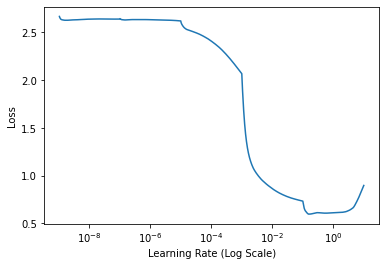

In [18]:
lr_cand_gen = LearningRateFinder(model)
lr_cand_gen.find(
		img_gen.flow(X_train, y_train, batch_size=batch_size),
		start_lr,
    end_lr,
    epochs = num_epochs,
		stepsPerEpoch=np.ceil((len(X_train) / float(batch_size))),
		batchSize=batch_size,
    verbose=1)

lr_cand_gen.plot_loss()

Training loss vs Learning rate ^

From above graph training loss begins to decrease considerably after 10e-5 and increases slightly after 10e-1.

lr_min = 10e-5 and lr_max=1e-1.

In [ ]:
# 2.2

In [35]:
min_lr = 10e-5
max_lr = 1e-1
# Running for more than enough epochs for convergence
max_epochs = 22
step_size = 8 * (X_train.shape[0] // batch_size)
# start opt with min_lr
opt = SGD(lr = min_lr, momentum=0.8)
model_cyclic = MiniGoogLeNet.build(width=32, height=32, depth=1, classes=10)
model_cyclic.compile(loss="categorical_crossentropy", optimizer=opt, metrics=["accuracy"])


cyclic_lr_finder = CyclicLR(
    base_lr = min_lr, 
    max_lr = max_lr,
    step_size=step_size, 
    mode='exp_range',
    gamma=0.9995
)

model_hist_cyclic = model_cyclic.fit(
	x = img_gen.flow(X_train, y_train, batch_size=batch_size),
	validation_data=(X_test, y_test),
	steps_per_epoch=X_train.shape[0] // batch_size,
	epochs = max_epochs,
	callbacks=[cyclic_lr_finder],
	verbose=1
)

/usr/local/lib/python3.7/dist-packages/keras/optimizers/optimizer_v2/gradient_descent.py:108: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


Epoch 1/22
937/937 [==============================] - 44s 45ms/step - loss: 0.9311 - accuracy: 0.6693 - val_loss: 1.5583 - val_accuracy: 0.5484
Epoch 2/22
937/937 [==============================] - 51s 54ms/step - loss: 0.4427 - accuracy: 0.8389 - val_loss: 0.4040 - val_accuracy: 0.8495
Epoch 3/22
937/937 [==============================] - 42s 45ms/step - loss: 0.3523 - accuracy: 0.8735 - val_loss: 0.3997 - val_accuracy: 0.8579
Epoch 4/22
937/937 [==============================] - 49s 52ms/step - loss: 0.3063 - accuracy: 0.8906 - val_loss: 0.3895 - val_accuracy: 0.8576
Epoch 5/22
937/937 [==============================] - 42s 45ms/step - loss: 0.2804 - accuracy: 0.8992 - val_loss: 0.3450 - val_accuracy: 0.8789
Epoch 6/22
937/937 [==============================] - 43s 46ms/step - loss: 0.2586 - accuracy: 0.9067 - val_loss: 0.2546 - val_accuracy: 0.9092
Epoch 7/22
937/937 [==============================] - 42s 45ms/step - loss: 0.2408 - accuracy: 0.9141 - val_loss: 0.2520 - val_accuracy:

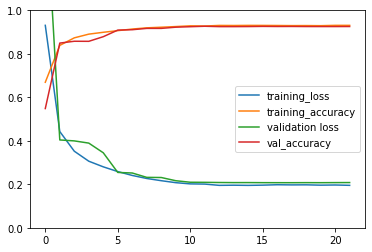

In [44]:
plt.plot(model_hist_cyclic.history["loss"], label = "training_loss")
plt.plot(model_hist_cyclic.history["accuracy"], label = "training_accuracy")
plt.plot(model_hist_cyclic.history["val_loss"], label = "validation loss")
plt.plot(model_hist_cyclic.history["val_accuracy"], label = "val_accuracy")
plt.ylim(0, 1)
plt.legend()

Loss and accuracy vs Epochs ^

In [ ]:
# 2.3 - running the following on GPU by importing training and test sets.

In [22]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [53]:
import pickle as pkl

with open("/content/gdrive/My Drive/train.pkl", "wb") as f:
    pkl.dump([X_train, y_train], f)

with open("/content/gdrive/My Drive/test.pkl", "wb") as f:
    pkl.dump([X_test, y_test], f)

As the model(MiniGoogleNet) couldn't run for large batch sizes, I tried a couple of things.

Error: OOM when allocating tensor with shape[4096,96,15,15].

1. Running on Colab.

2. Running on GCP - with different RAM.

3. Effective batch size approach : Accumulate gradients during training using a wrapper: https://stackoverflow.com/questions/55268762/how-to-accumulate-gradients-for-large-batch-sizes-in-keras I used a wrapper from runai optimizer. 
`(opt = runai.ga.keras.optimizers.Optimizer(SGD(learning_rate = lr_new), steps=10)`


None of these worked so I finally used gradient accummulation. Source: https://stackoverflow.com/questions/66472201/gradient-accumulation-with-custom-model-fit-in-tf-keras with tweaks.

**Technique used: Create a new model for each batch size ranging from 32 to 16384 to accurately capture how the model trains specifically to a batch size.**

In [28]:
import tensorflow as tf

class CustomTrainStep(tf.keras.Model):
    def __init__(self, *args, **kwargs):
        super().__init__(*args, **kwargs)
        self.n_gradients = tf.Variable(1, dtype=tf.int32, trainable=False)
        self.n_acum_step = tf.Variable(0, dtype=tf.int32, trainable=False)
        self.gradient_accumulation = [tf.Variable(tf.zeros_like(v, dtype=tf.float32), trainable=False) for v in self.trainable_variables]

    def train_step(self, data):
        self.n_acum_step.assign_add(1)

        x, y = data
        # Gradient Tape
        with tf.GradientTape() as tape:
            y_pred = self(x, training=True)
            loss = self.compiled_loss(y, y_pred, regularization_losses=self.losses)
        # Calculate batch gradients
        gradients = tape.gradient(loss, self.trainable_variables)
        # Accumulate batch gradients
        for i in range(len(self.gradient_accumulation)):
            self.gradient_accumulation[i].assign_add(gradients[i])
 
        # If n_acum_step reach the n_gradients then we apply accumulated gradients to update the variables otherwise do nothing
        tf.cond(tf.equal(self.n_acum_step, self.n_gradients), self.apply_accu_gradients, lambda: None)

        # update metrics
        self.compiled_metrics.update_state(y, y_pred)
        return {m.name: m.result() for m in self.metrics}

    def apply_accu_gradients(self):
        # apply accumulated gradients
        self.optimizer.apply_gradients(zip(self.gradient_accumulation, self.trainable_variables))

        # reset
        self.n_acum_step.assign(0)
        for i in range(len(self.gradient_accumulation)):
            self.gradient_accumulation[i].assign(tf.zeros_like(self.trainable_variables[i], dtype=tf.float32))

In [20]:
import pickle as pkl

# Get the training, test data created earlier
with open("/content/gdrive/My Drive/train.pkl", "rb") as f:
    X_train, y_train = pkl.load(f)

with open("/content/gdrive/My Drive/test.pkl", "rb") as f:
    X_test, y_test = pkl.load(f)

In [ ]:
lr_new = 1e-1
min_batch_size =32
min_batch_size = 16384
max_epochs = 50
batchwise_hist = []

inputs, outputs = MiniGoogLeNet.build_return_model(width=32, height=32, depth=1,classes=10)
model2 = CustomTrainStep(inputs=[inputs], outputs=[outputs])
opt = SGD(learning_rate=lr_new, momentum=0.9)
model2.compile(loss="categorical_crossentropy", optimizer=opt, metrics=["acc"])

for i in range(10):
  print("i=", i)
  model2_history = model2.fit(X_train, y_train, batch_size=32, epochs=max_epochs, verbose=2)
  model2.n_gradients.assign(2 * model.n_gradients) # Increase batch size
  batchwise_hist.append(model2_history.history)
	
with open("/content/gdrive/My Drive/2c_output.log", "w") as outfile2:
    outfile2.write("\n".join(batchwise_hist))
outfile2.close()

i= 0
Epoch 1/10
1875/1875 - 46s - loss: 0.5133 - acc: 0.8160 - 46s/epoch - 25ms/step
Epoch 2/10
1875/1875 - 42s - loss: 0.3011 - acc: 0.8927 - 42s/epoch - 22ms/step
Epoch 3/10
1875/1875 - 42s - loss: 0.2539 - acc: 0.9094 - 42s/epoch - 22ms/step
Epoch 4/10
1875/1875 - 42s - loss: 0.2259 - acc: 0.9193 - 42s/epoch - 22ms/step
Epoch 5/10
1875/1875 - 42s - loss: 0.2041 - acc: 0.9267 - 42s/epoch - 22ms/step
Epoch 6/10
1875/1875 - 42s - loss: 0.1879 - acc: 0.9322 - 42s/epoch - 22ms/step
Epoch 7/10
1875/1875 - 42s - loss: 0.1729 - acc: 0.9380 - 42s/epoch - 22ms/step
Epoch 8/10
1875/1875 - 44s - loss: 0.1569 - acc: 0.9434 - 44s/epoch - 23ms/step
Epoch 9/10
1875/1875 - 44s - loss: 0.1454 - acc: 0.9475 - 44s/epoch - 23ms/step
Epoch 10/10
1875/1875 - 45s - loss: 0.1342 - acc: 0.9512 - 45s/epoch - 24ms/step
i= 1
Epoch 1/10
1875/1875 - 43s - loss: 0.1179 - acc: 0.9569 - 43s/epoch - 23ms/step
Epoch 2/10
1875/1875 - 43s - loss: 0.1128 - acc: 0.9592 - 43s/epoch - 23ms/step
Epoch 3/10
1875/1875 - 41s - 

**Output from the files:**

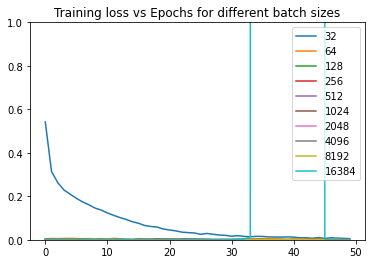

In [42]:
training_loss = [[0.5420950055122375, 0.3148602545261383, 0.263302743434906, 0.22902557253837585, 0.21005752682685852, 0.19092011451721191, 0.174209326505661, 0.16138389706611633, 0.14593978226184845, 0.13680416345596313, 0.12320204079151154, 0.11250272393226624, 0.10243477672338486, 0.09364716708660126, 0.08331773430109024, 0.07617134600877762, 0.06584402173757553, 0.06130563095211983, 0.05866776406764984, 0.049452099949121475, 0.04518171772360802, 0.04109710454940796, 0.035184502601623535, 0.03307579085230827, 0.03138801082968712, 0.02517504058778286, 0.029176533222198486, 0.025540439411997795, 0.021893184632062912, 0.020530330017209053, 0.016385484486818314, 0.019006891176104546, 0.01557104755192995, 0.01413582731038332, 0.0158893670886755, 0.01538989320397377, 0.013232850469648838, 0.012681168504059315, 0.012481078505516052, 0.013199292123317719, 0.01236988790333271, 0.009073697030544281, 0.009275338612496853, 0.007124865893274546, 0.01042476762086153, 0.006368867587298155, 0.0093088299036026, 0.007611554581671953, 0.0065561458468437195, 0.00535868713632226], [0.004424142651259899, 0.005895729176700115, 0.005522752180695534, 0.006178302224725485, 0.006684988737106323, 0.005759812891483307, 0.00489472970366478, 0.005610791966319084, 0.0036813600454479456, 0.005515204276889563, 0.002967710141092539, 0.006573460530489683, 0.004934226628392935, 0.002059279941022396, 0.0017566143069416285, 0.0044827694073319435, 0.004049958661198616, 0.003759965533390641, 0.004262658767402172, 0.0038333337288349867, 0.0038605036679655313, 0.002536144806072116, 0.0034915495198220015, 0.002685680752620101, 0.0025044360663741827, 0.0024253004230558872, 0.0013914102455601096, 0.0013036956079304218, 0.0010259727714583278, 0.0016002325573936105, 0.0008167336345650256, 0.0007512139272876084, 0.0027698043268173933, 0.001947510871104896, 0.00433072354644537, 0.00524519570171833, 0.005788046400994062, 0.00463395519182086, 0.0035483844112604856, 0.0019419497111812234, 0.003236608114093542, 0.0024830885231494904, 0.001741944346576929, 0.002766008023172617, 0.00282686366699636, 0.001712263561785221, 0.002282261848449707, 0.003551843576133251, 0.0017292260890826583, 0.001784080290235579], [0.0015628954861313105, 0.0019750958308577538, 0.0014764564111828804, 0.0020898866932839155, 0.0015195661690086126, 0.001750446856021881, 0.0024361752439290285, 0.0015050298534333706, 0.0014468521112576127, 0.0014219657750800252, 0.002018603263422847, 0.0022103970404714346, 0.0020592855289578438, 0.002211294835433364, 0.0015400806441903114, 0.0016354976687580347, 0.0015300887171179056, 0.0012247825507074594, 0.0013612826587632298, 0.0015126679791137576, 0.001946224132552743, 0.0011915767099708319, 0.001728612813167274, 0.0015058960998430848, 0.0010453611612319946, 0.0012184611987322569, 0.0013423492200672626, 0.0010942216031253338, 0.0003736764774657786, 0.0007568137370981276, 0.0012120387982577085, 0.0011519078398123384, 0.0021852487698197365, 0.0013651404296979308, 0.0010873693972826004, 0.0005269134999252856, 0.00042402115650475025, 0.00032726931385695934, 0.0004110129957552999, 0.0006185490638017654, 0.0006036488921381533, 0.00021555698185693473, 0.00034083236823789775, 0.000740310933906585, 0.0012787797022610903, 0.0012900488218292594, 0.001046059187501669, 0.0008256377768702805, 0.0008152007358148694, 0.0018261673394590616], [0.0022864926140755415, 0.000871046504471451, 0.0009155705920420587, 0.0009719351655803621, 0.0006024650065228343, 0.0008627874194644392, 0.00096559664234519, 0.0005545747117139399, 0.0004805534554179758, 0.00047144488780759275, 0.0007023931248113513, 0.00036066482425667346, 0.0008073702920228243, 0.0006965039647184312, 0.00016975098697002977, 0.00023456639610230923, 0.0009616901515983045, 0.0004917426267638803, 0.002449232852086425, 0.0005323163350112736, 0.0012258143397048116, 0.0016226411098614335, 0.0016205578576773405, 0.000981750781647861, 0.0011806521797552705, 0.001394210266880691, 0.0014235802227631211, 0.000803600181825459, 0.0005545089952647686, 0.0004015734884887934, 0.0005144216702319682, 0.00177153164986521, 0.0010841601761057973, 0.0015598858008161187, 0.0013058120384812355, 0.0007433482096530497, 0.00032564601860940456, 0.00019607636204455048, 0.0008559082052670419, 0.00038685440085828304, 0.0014036239590495825, 0.0008924464927986264, 0.0018670459976419806, 0.001512882998213172, 0.0020405512768775225, 0.0012210982386022806, 0.0005163736641407013, 0.00046010559890419245, 0.0018131023971363902, 0.001323410077020526], [0.0005158910062164068, 0.0007181499386206269, 0.0009618865442462265, 0.0007057498442009091, 0.0004176415968686342, 0.00041682427399791777, 0.00026756804436445236, 0.0002477466478012502, 0.00013952150766272098, 0.00011370253923814744, 0.00020737254817504436, 0.0005589656066149473, 0.0007919994532130659, 0.0004174903151579201, 0.00028069698601029813, 0.00022183344117365777, 0.00012256583431735635, 0.00023000765941105783, 0.00034863792825490236, 0.00019481792696751654, 0.00019715983944479376, 0.00022235298820305616, 8.759189950069413e-05, 0.00010516378097236156, 8.13326914794743e-05, 4.317121783969924e-05, 0.00010657189704943448, 4.313025783631019e-05, 0.00025816369452513754, 0.00016813822730910033, 0.00013841799227520823, 6.21022772975266e-05, 7.141257810872048e-05, 4.470202839002013e-05, 7.24413403077051e-05, 5.549647903535515e-05, 0.0003290211607236415, 8.362225344171748e-05, 0.0001319572766078636, 7.738367276033387e-05, 3.729409945663065e-05, 6.055105768609792e-05, 2.5503031793050468e-05, 1.918446650961414e-05, 3.206002656952478e-05, 2.40684203163255e-05, 1.17268518806668e-05, 1.8286398699274287e-05, 6.461532757384703e-05, 1.6740508726797998e-05], [5.13179438712541e-05, 2.393396061961539e-05, 2.209760896221269e-05, 6.268489232752472e-05, 0.00021537138673011214, 0.00012680682993959635, 0.0002212844992754981, 0.0003348524041939527, 0.00044236177927814424, 0.0006911872769705951, 0.00023498336668126285, 0.0003071119135711342, 0.000445342535385862, 0.0002958516706712544, 0.00046177557669579983, 0.002225420670583844, 0.001283194636926055, 0.0010564553085714579, 0.0016028652898967266, 0.0023171722423285246, 0.001610207837074995, 0.0017051371978595853, 0.001662489608861506, 0.0024191366974264383, 0.0025602427776902914, 0.0014231194509193301, 0.0008759776828810573, 0.0005622744793072343, 0.0012837930116802454, 0.0009296833304688334, 0.0010226010344922543, 0.0013829346280544996, 0.0012881765142083168, 0.001442213892005384, 0.0004855543083976954, 0.0003411267534829676, 0.00018588414241094142, 0.00021772664331365377, 0.00012479063298087567, 0.0002586384944152087, 0.0003962986811529845, 0.00026013440219685435, 0.00013884958752896637, 0.0001078276545740664, 0.00024356174981221557, 4.902883301838301e-05, 9.316202340414748e-05, 0.00011436271597631276, 5.6597778893774375e-05, 3.891083906637505e-05], [3.5635755921248347e-05, 3.769674731302075e-05, 7.331976667046547e-05, 7.683303556405008e-05, 6.817268877057359e-05, 5.5678341595921665e-05, 3.646731420303695e-05, 7.159963570302352e-05, 4.729704960482195e-05, 5.0986338465008885e-05, 6.469535583164543e-05, 6.646629481110722e-05, 7.203783025033772e-05, 9.353180939797312e-05, 7.218565588118508e-05, 8.815696492092684e-05, 0.0001315210829488933, 0.00011166645708726719, 7.900791388237849e-05, 0.00026921628159470856, 0.00011247119982726872, 0.0004474227025639266, 0.0002547341282479465, 8.877983054844663e-05, 0.00011553732474567369, 8.804611570667475e-05, 0.00012869264173787087, 3.9054571971064433e-05, 9.529809904051945e-05, 0.0001527318818261847, 5.2233011956559494e-05, 0.00024567791842855513, 0.0002886784786824137, 0.0001999812084250152, 0.00026978758978657424, 0.0002364337706239894, 0.00010784382902784273, 0.00016751696239225566, 0.00010925821698037907, 9.933907858794555e-05, 7.616945367772132e-05, 2.3407743356074207e-05, 0.00034696434158831835, 0.0004024859517812729, 0.00011250675015617162, 0.00013040105113759637, 7.80857153586112e-05, 7.519372593378648e-05, 4.946686021867208e-05, 4.588955926010385e-05], [9.234812023350969e-05, 0.00021413587091956288, 0.0001776456629158929, 0.00016096854233182967, 0.00017904609558172524, 0.00014908667071722448, 0.00010451586422277614, 9.804413275560364e-05, 9.932003013091162e-05, 0.00016839032468851656, 0.00010500455391593277, 0.00010603384725982323, 0.00014959735563024879, 0.0001658066175878048, 0.00010216349619440734, 0.00018121137691196054, 0.00011696758883772418, 0.00010703843872761354, 0.00015005195746198297, 0.0001187707093777135, 0.0001315734552918002, 0.0004088383284397423, 0.0004094199393875897, 0.0004406029765959829, 0.0006124817882664502, 0.0004018892941530794, 0.00026238540885969996, 0.0004190315958112478, 0.0004717384872492403, 0.0007786425994709134, 0.0008228786755353212, 0.0006860010325908661, 0.0004760454467032105, 0.0006912219105288386, 0.0005371130537241697, 0.0006486950442194939, 0.000734700181055814, 0.0006243881653062999, 0.0006723136175423861, 0.0005172537639737129, 0.0005365303950384259, 0.000349713081959635, 0.00034281102125532925, 0.00031837483402341604, 0.00020871868764515966, 0.0005792855517938733, 0.0004112103779334575, 0.0005185871268622577, 0.0006640728679485619, 0.0007894003065302968], [0.0005989692290313542, 0.0005402365350164473, 0.000393367517972365, 0.0006821535644121468, 0.0003943931660614908, 0.0005084285512566566, 0.00032248845673166215, 0.0005302808131091297, 0.000656267860904336, 0.0006768734892830253, 0.0008253557607531548, 0.0008777246112003922, 0.000518881599418819, 0.0005881105898879468, 0.0006610269192606211, 0.0005997192347422242, 0.0006556315929628909, 0.00041697200504131615, 0.0005595232360064983, 0.00038258227868936956, 0.00040411631925962865, 0.0007319321157410741, 0.00040680586243979633, 0.0003644444514065981, 0.0004151301400270313, 0.00033199781319126487, 0.0004338389844633639, 0.00044451310532167554, 0.00043942287447862327, 0.0004510145226959139, 0.0006378131220117211, 0.0005782142397947609, 0.0008824639371596277, 0.0007892603753134608, 0.0010885989759117365, 0.0007009180262684822, 0.0006589682889170945, 0.0007218534592539072, 0.0007036990718916059, 0.0005248243105597794, 0.000587265589274466, 0.0008383745444007218, 0.0007822341867722571, 0.0005817440687678754, 0.0007714273524470627, 0.0003845740866381675, 0.0003952145925723016, 0.00046930808457545936, 0.0003537531301844865, 0.0003829436027444899], [0.00024292927992064506, 0.00030125517514534295, 0.00018208321125712246, 0.0002398660290054977, 0.00017821673827711493, 0.0001844886428443715, 0.00016554282046854496, 0.00015197052562143654, 0.00013116197078488767, 0.00011392638407414779, 5.810958828078583e-05, 6.154020229587331e-05, 0.0001344257325399667, 8.917581726564094e-05, 4.866996459895745e-05, 0.000111114073661156, 0.00016568080172874033, 9.650101128499955e-05, 5.2379502449184656e-05, 0.0001358536392217502, 7.594619819428772e-05, 9.25453205127269e-05, 5.07073309563566e-05, 0.00011055206414312124, 8.339669147972018e-05, 0.00010485359962331131, 0.0001039486814988777, 0.00017212233797181398, 0.00020633346866816282, 3.840804856736213e-05, 0.0004967922577634454, 0.0020398814231157303, 0.003100417321547866, 0.013631965965032578, 305.02734375, 47493.44140625, 11080747.0, 41246372.0, 3751796736.0, 367057436672.0, 866572632064.0, 755666845696.0, 440541808427008.0, 471300048945152.0, 2.523395077124915e+16, 0, 0, 0, 0, 0]]
for idx, loss_list in enumerate(training_loss):
  batch_s = 32 * (2 ** idx)
  plt.plot(loss_list, label=batch_s)
  plt.ylim(0,1)
plt.title("Training loss vs Epochs for different batch sizes")
plt.legend()

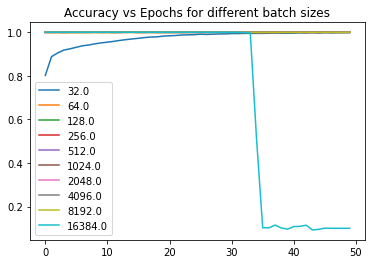

In [37]:
training_acc = [[0.8015333414077759, 0.8878499865531921, 0.9051166772842407, 0.9182666540145874, 0.9240000247955322, 0.9310166835784912, 0.9378166794776917, 0.9414166808128357, 0.9469333291053772, 0.9512166380882263, 0.9544500112533569, 0.9580833315849304, 0.9625333547592163, 0.9661333560943604, 0.9692666530609131, 0.9722333550453186, 0.9756166934967041, 0.9779499769210815, 0.978866696357727, 0.9823333621025085, 0.9836333394050598, 0.9850833415985107, 0.9875166416168213, 0.9880499839782715, 0.9888833165168762, 0.9911333322525024, 0.989883303642273, 0.9912499785423279, 0.9921000003814697, 0.9925000071525574, 0.9939166903495789, 0.9938499927520752, 0.9946500062942505, 0.994783341884613, 0.9947999715805054, 0.9948499798774719, 0.9953166842460632, 0.9958000183105469, 0.9955666661262512, 0.9956666827201843, 0.9958333373069763, 0.9969000220298767, 0.9965500235557556, 0.997783362865448, 0.9963666796684265, 0.9980000257492065, 0.9967666864395142, 0.9975000023841858, 0.9979166388511658, 0.9982666373252869], [0.998449981212616, 0.9980000257492065, 0.9984166622161865, 0.9976999759674072, 0.99795001745224, 0.9980833530426025, 0.9984166622161865, 0.9981499910354614, 0.9987000226974487, 0.9981499910354614, 0.9989833235740662, 0.9978166818618774, 0.998533308506012, 0.9994333386421204, 0.9993333220481873, 0.9983999729156494, 0.9986333250999451, 0.9986500144004822, 0.9987999796867371, 0.9987666606903076, 0.9986333250999451, 0.9992166757583618, 0.9989500045776367, 0.9991666674613953, 0.9993333220481873, 0.9993333220481873, 0.9995999932289124, 0.9995999932289124, 0.9996333122253418, 0.9995499849319458, 0.9998000264167786, 0.9997833371162415, 0.9992499947547913, 0.9993166923522949, 0.9985666871070862, 0.9984666705131531, 0.9982666373252869, 0.9982333183288574, 0.9988166689872742, 0.9993833303451538, 0.9989166855812073, 0.9991666674613953, 0.9994333386421204, 0.9991499781608582, 0.9990666508674622, 0.9994333386421204, 0.9992499947547913, 0.9987999796867371, 0.9994833469390869, 0.9994166493415833], [0.9994999766349792, 0.9994833469390869, 0.9994999766349792, 0.9993833303451538, 0.9995833039283752, 0.9994666576385498, 0.9992166757583618, 0.9994000196456909, 0.9995999932289124, 0.9994666576385498, 0.9993500113487244, 0.9991999864578247, 0.9994500279426575, 0.9993666410446167, 0.9995499849319458, 0.9994833469390869, 0.9994500279426575, 0.9997166395187378, 0.9995833039283752, 0.9994500279426575, 0.9993500113487244, 0.9996333122253418, 0.9994500279426575, 0.9994999766349792, 0.999666690826416, 0.9995499849319458, 0.9996500015258789, 0.9997000098228455, 0.9998999834060669, 0.9998166561126709, 0.9995666742324829, 0.9996166825294495, 0.9993833303451538, 0.9994833469390869, 0.999750018119812, 0.9998166561126709, 0.9998999834060669, 0.999916672706604, 0.9998833537101746, 0.9997833371162415, 0.9998166561126709, 0.9999333620071411, 0.9998999834060669, 0.999750018119812, 0.999666690826416, 0.9995833039283752, 0.999750018119812, 0.9997833371162415, 0.9996833205223083, 0.9994000196456909], [0.9993000030517578, 0.999750018119812, 0.9997333288192749, 0.9996166825294495, 0.9998833537101746, 0.9997333288192749, 0.9996500015258789, 0.999833345413208, 0.9998499751091003, 0.9998833537101746, 0.9997666478157043, 0.9998999834060669, 0.9996833205223083, 0.9998166561126709, 0.9999666810035706, 0.999916672706604, 0.9997666478157043, 0.9998833537101746, 0.9994333386421204, 0.9998666644096375, 0.9995666742324829, 0.9994999766349792, 0.9994500279426575, 0.9997166395187378, 0.9995666742324829, 0.9995499849319458, 0.9994999766349792, 0.9997833371162415, 0.9998499751091003, 0.9999333620071411, 0.9998666644096375, 0.9994166493415833, 0.9996166825294495, 0.9995333552360535, 0.9996833205223083, 0.9997833371162415, 0.9999333620071411, 0.999916672706604, 0.999750018119812, 0.9998999834060669, 0.9995333552360535, 0.9997333288192749, 0.9993666410446167, 0.9994000196456909, 0.9993833303451538, 0.9995666742324829, 0.9998499751091003, 0.9998833537101746, 0.9994666576385498, 0.9995833039283752], [0.999833345413208, 0.999750018119812, 0.999750018119812, 0.9997333288192749, 0.9998166561126709, 0.999916672706604, 0.999916672706604, 0.9999333620071411, 0.9999833106994629, 0.9999833106994629, 0.9999333620071411, 0.9998666644096375, 0.9997833371162415, 0.9998833537101746, 0.9999333620071411, 0.9999499917030334, 0.9999833106994629, 0.9999499917030334, 0.9998999834060669, 0.9998999834060669, 0.9999333620071411, 0.9999333620071411, 0.9999666810035706, 0.9999666810035706, 0.9999833106994629, 1.0, 0.9999333620071411, 1.0, 0.9999333620071411, 0.9999833106994629, 0.9999666810035706, 0.9999833106994629, 0.9999666810035706, 1.0, 0.9999833106994629, 0.9999833106994629, 0.9998999834060669, 0.9999833106994629, 0.9999499917030334, 0.9999833106994629, 1.0, 0.9999833106994629, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.9999833106994629, 1.0], [1.0, 1.0, 1.0, 0.9999833106994629, 0.9999499917030334, 0.9999666810035706, 0.9999499917030334, 0.9999333620071411, 0.9998999834060669, 0.9998000264167786, 0.9998999834060669, 0.9998666644096375, 0.9997833371162415, 0.9998999834060669, 0.9998499751091003, 0.9991999864578247, 0.9995333552360535, 0.9996500015258789, 0.9994333386421204, 0.9993833303451538, 0.9993666410446167, 0.9994666576385498, 0.9994999766349792, 0.9992666840553284, 0.9992166757583618, 0.9994666576385498, 0.9996833205223083, 0.9997833371162415, 0.999750018119812, 0.9996333122253418, 0.9996833205223083, 0.9995999932289124, 0.9995833039283752, 0.9994999766349792, 0.9998499751091003, 0.999916672706604, 0.9999499917030334, 0.9999333620071411, 0.9999666810035706, 0.9999499917030334, 0.9998666644096375, 0.9999333620071411, 0.9999499917030334, 0.9999833106994629, 0.999916672706604, 1.0, 0.9999666810035706, 0.9999833106994629, 1.0, 1.0], [1.0, 0.9999833106994629, 0.9999833106994629, 0.9999666810035706, 0.9999833106994629, 0.9999833106994629, 1.0, 0.9999833106994629, 1.0, 0.9999833106994629, 0.9999833106994629, 0.9999833106994629, 0.9999666810035706, 0.9999833106994629, 0.9999666810035706, 0.9999666810035706, 0.9999666810035706, 0.9999499917030334, 0.9999833106994629, 0.9999333620071411, 0.9999666810035706, 0.9998499751091003, 0.9999499917030334, 1.0, 0.9999833106994629, 0.9999666810035706, 0.9999499917030334, 1.0, 0.9999499917030334, 0.9999833106994629, 0.9999833106994629, 0.999916672706604, 0.999916672706604, 0.9999499917030334, 0.9998999834060669, 0.9999333620071411, 0.9999833106994629, 0.9999333620071411, 0.9999666810035706, 0.9999833106994629, 0.9999833106994629, 1.0, 0.999916672706604, 0.9998666644096375, 0.9999666810035706, 0.9999666810035706, 0.9999833106994629, 0.9999833106994629, 0.9999833106994629, 0.9999833106994629], [0.9999666810035706, 0.9999499917030334, 0.9999499917030334, 0.9999333620071411, 0.9999499917030334, 0.9999499917030334, 0.9999833106994629, 0.9999833106994629, 0.9999833106994629, 0.9999666810035706, 0.9999666810035706, 0.9999499917030334, 0.9999833106994629, 0.9999666810035706, 0.9999666810035706, 0.9999666810035706, 0.9999666810035706, 0.9999666810035706, 0.9999499917030334, 0.9999499917030334, 0.9999833106994629, 0.9998499751091003, 0.9998499751091003, 0.9998499751091003, 0.9997833371162415, 0.9998833537101746, 0.9999333620071411, 0.9998666644096375, 0.999833345413208, 0.9997833371162415, 0.999750018119812, 0.9997000098228455, 0.9998499751091003, 0.9997333288192749, 0.9997833371162415, 0.9998166561126709, 0.9997000098228455, 0.9997666478157043, 0.999833345413208, 0.9998499751091003, 0.9998000264167786, 0.9998999834060669, 0.9998666644096375, 0.9998999834060669, 0.9999666810035706, 0.999833345413208, 0.9998833537101746, 0.999833345413208, 0.9997333288192749, 0.9998000264167786], [0.9998000264167786, 0.9997333288192749, 0.999916672706604, 0.9997166395187378, 0.9998499751091003, 0.9998166561126709, 0.9998999834060669, 0.9998166561126709, 0.999833345413208, 0.9998833537101746, 0.9997166395187378, 0.9997166395187378, 0.9998833537101746, 0.9997833371162415, 0.9998000264167786, 0.9998000264167786, 0.9997833371162415, 0.9998499751091003, 0.9998166561126709, 0.9998999834060669, 0.9998833537101746, 0.9997833371162415, 0.9998833537101746, 0.9998666644096375, 0.9998999834060669, 0.9998999834060669, 0.9998666644096375, 0.9998499751091003, 0.9998499751091003, 0.9998999834060669, 0.9997333288192749, 0.9998000264167786, 0.9998000264167786, 0.9997166395187378, 0.999666690826416, 0.9998000264167786, 0.9997833371162415, 0.9998000264167786, 0.9997333288192749, 0.9998666644096375, 0.999833345413208, 0.999750018119812, 0.999750018119812, 0.9997333288192749, 0.9997666478157043, 0.9998499751091003, 0.999916672706604, 0.9998166561126709, 0.9998999834060669, 0.9998499751091003], [0.999916672706604, 0.999916672706604, 0.9999499917030334, 0.9999499917030334, 0.9999833106994629, 0.9999333620071411, 0.9999333620071411, 0.9999666810035706, 0.9999666810035706, 0.9999666810035706, 1.0, 1.0, 0.9999499917030334, 0.9999833106994629, 0.9999833106994629, 0.9999666810035706, 0.9999499917030334, 0.9999833106994629, 0.9999833106994629, 0.9999333620071411, 0.9999833106994629, 0.9999833106994629, 1.0, 0.9999833106994629, 0.9999833106994629, 0.9999666810035706, 0.9999833106994629, 0.9999499917030334, 0.999916672706604, 1.0, 0.9998833537101746, 0.9994833469390869, 0.9992666840553284, 0.9968500137329102, 0.5147500038146973, 0.10254999995231628, 0.10199999809265137, 0.11474999785423279, 0.10148333013057709, 0.09601666778326035, 0.10793333500623703, 0.10894999653100967, 0.11403333395719528, 0.09253333508968353, 0.09498333185911179, 0.10058332979679108, 0.10000000149011612, 0.10000000149011612, 0.10000000149011612, 0.10000000149011612]]
for idx, acc_list in enumerate(training_acc):
  batch_s = 32 * math.pow(2,idx)
  plt.plot(acc_list, label=batch_s)
plt.title("Accuracy vs Epochs for different batch sizes")
plt.legend()

As seen, the training loss vs epoch and the accuracy vs epoch graphs are very similar to the cyclical learning rate graphs seen in 2.2, especially for batch size 32 and up until epochs 20. So we can say that increasing batch size for a fixed learning rate has the same effect as decreasing learning rate for a fixed batch size. Here we see that bigger batch sizes converge faster and have higher accuracy throughout until larger no. of epochs (>30). The training loss increases dramatically and the accuracy decreases for larger batches like 16384.

### Problem 3

In [ ]:
# 3.1

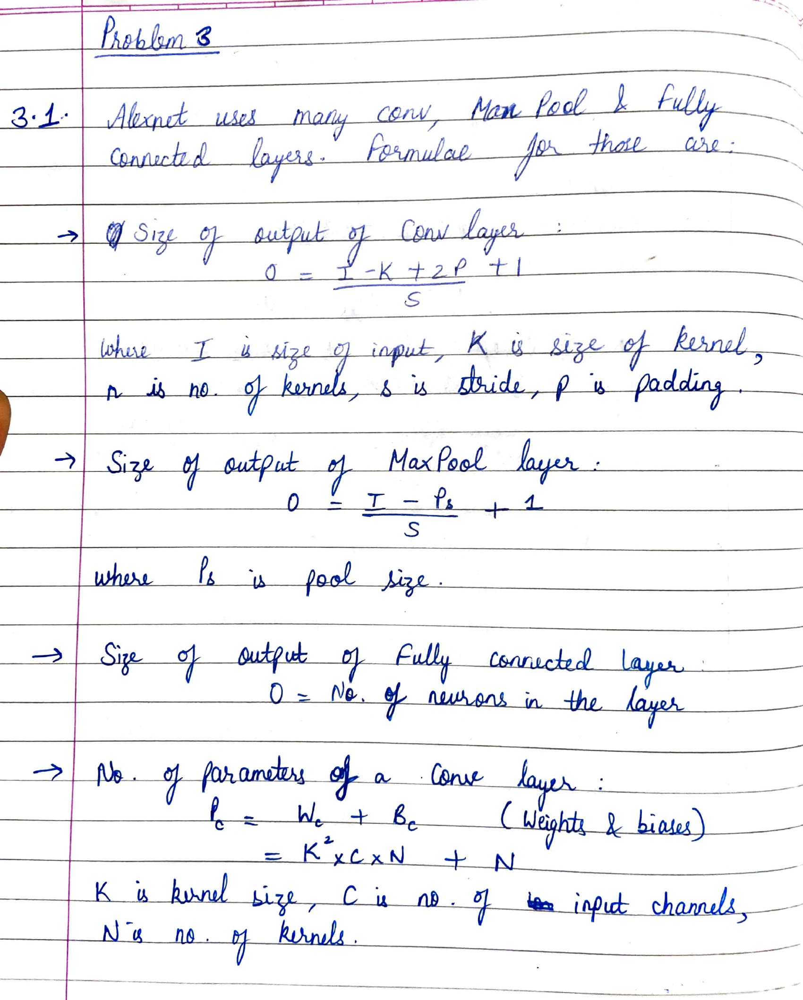

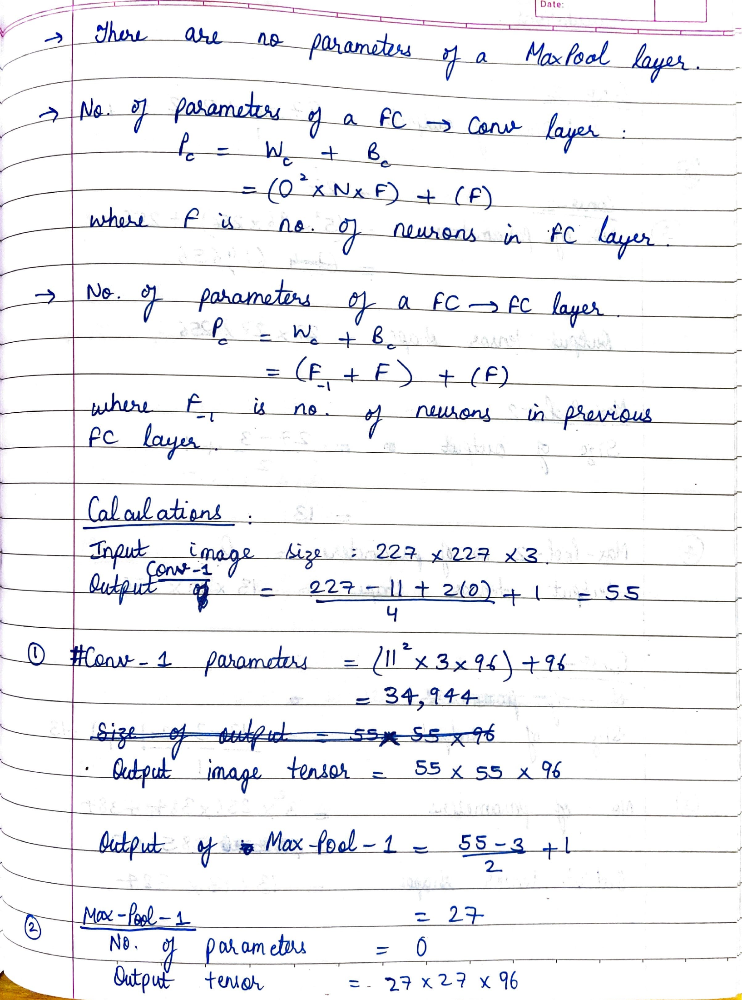

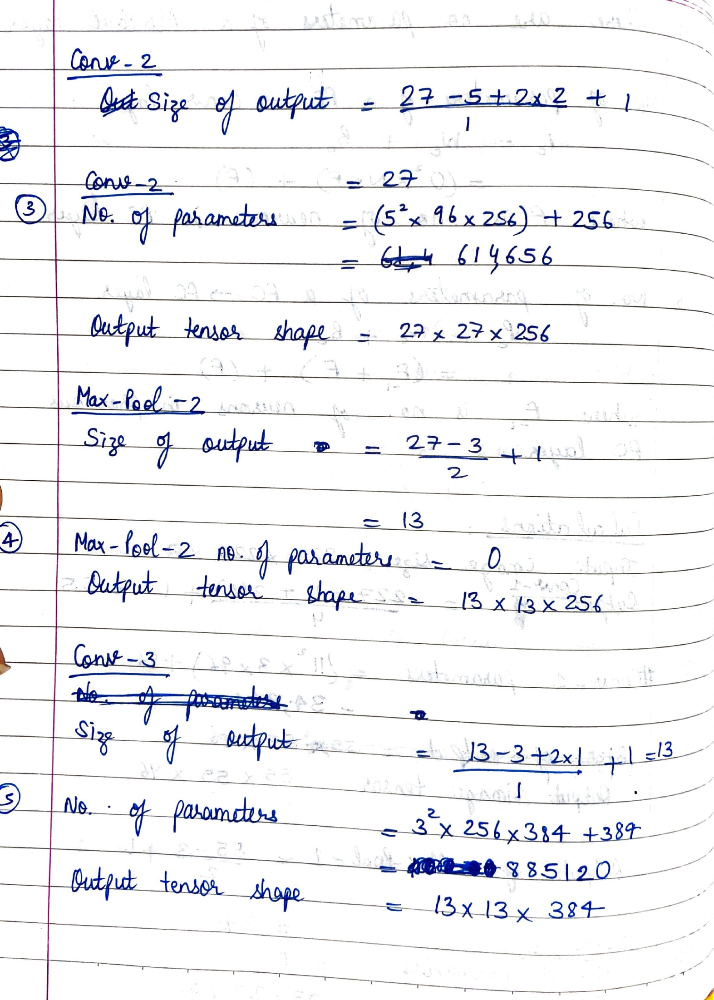

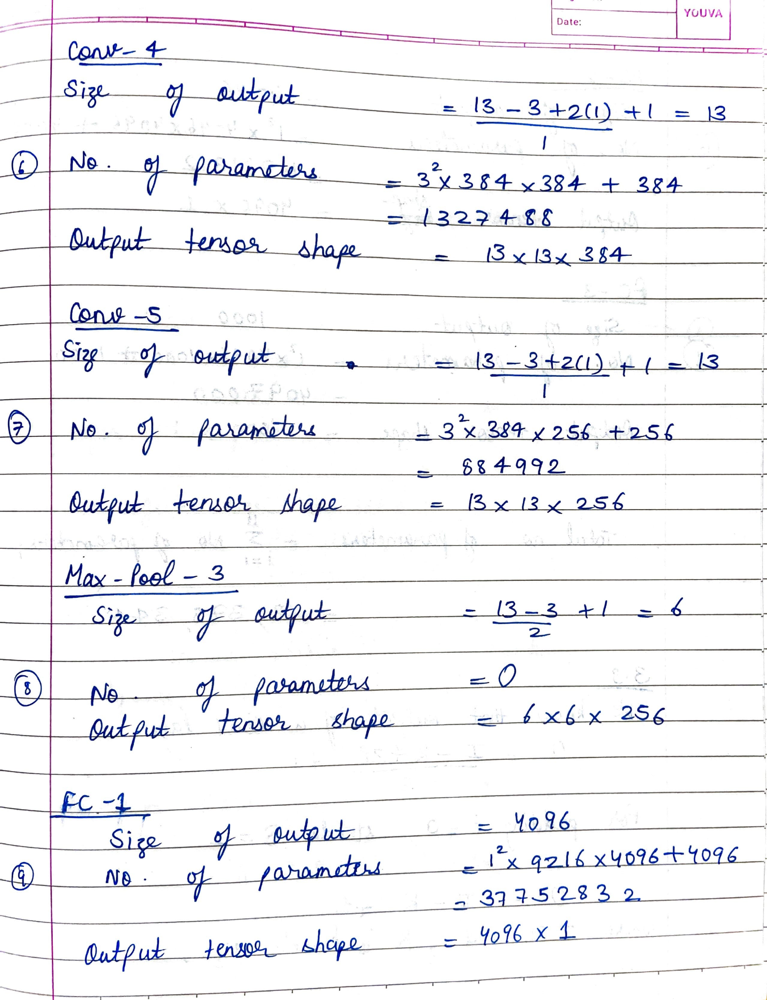

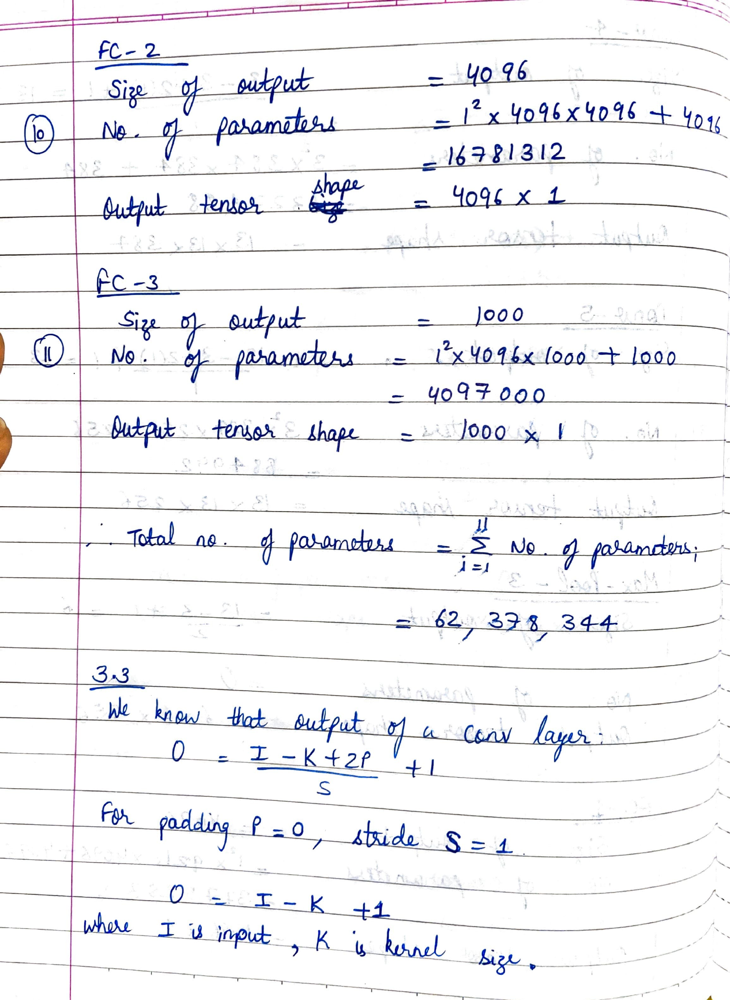

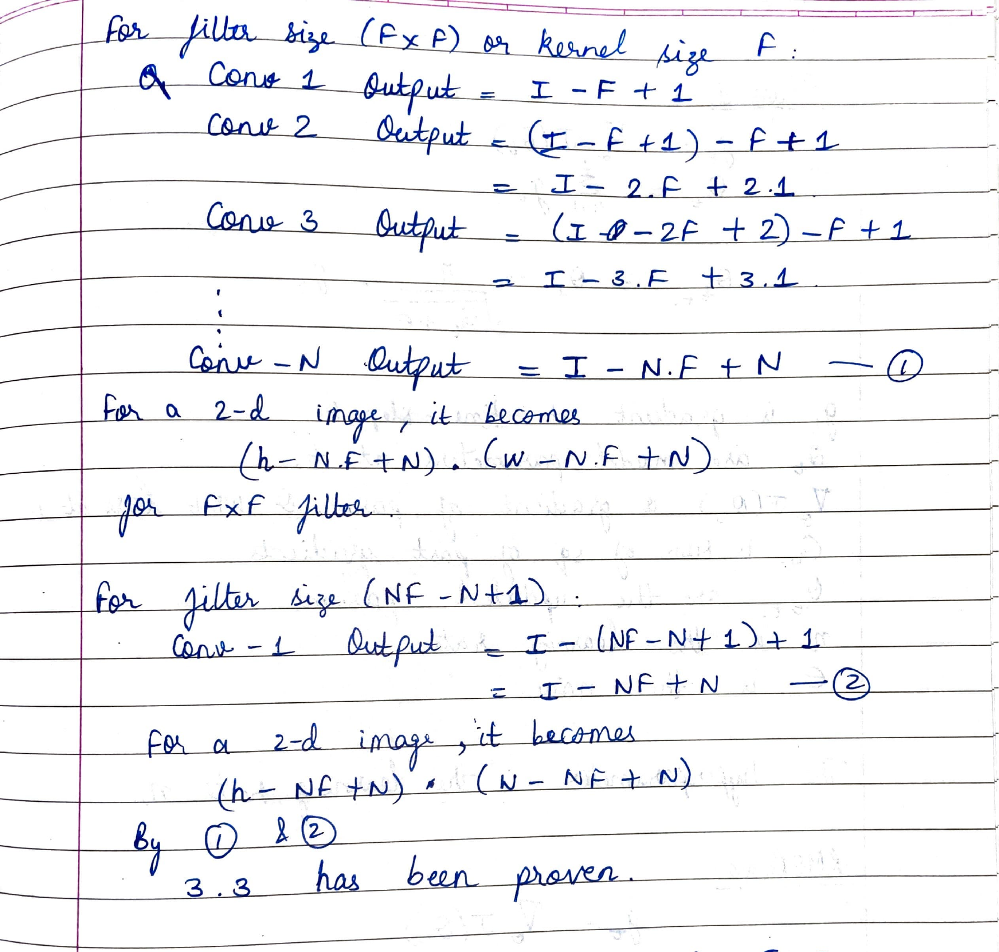

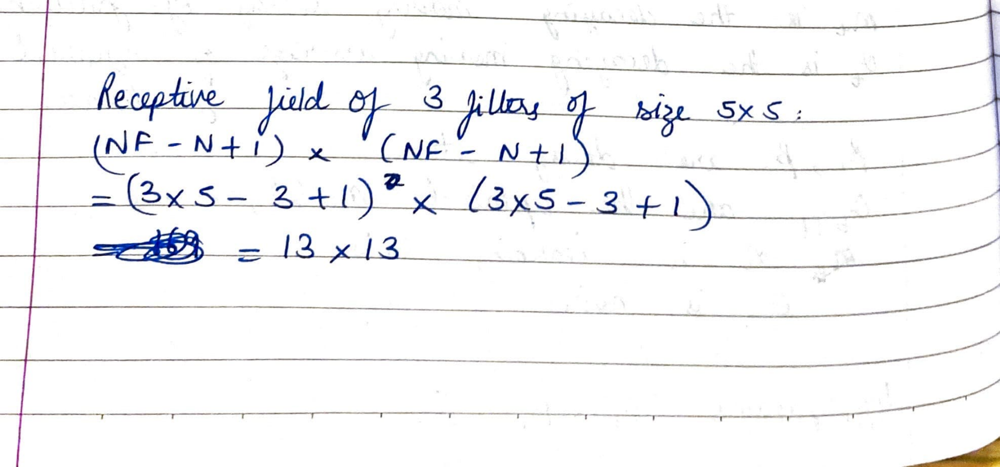

In [31]:
q3_images = convert_from_path("/content/gdrive/MyDrive/pdl hw3 3.1.pdf")

for i in range(len(q3_images)):
  display(q3_images[i])

3.2

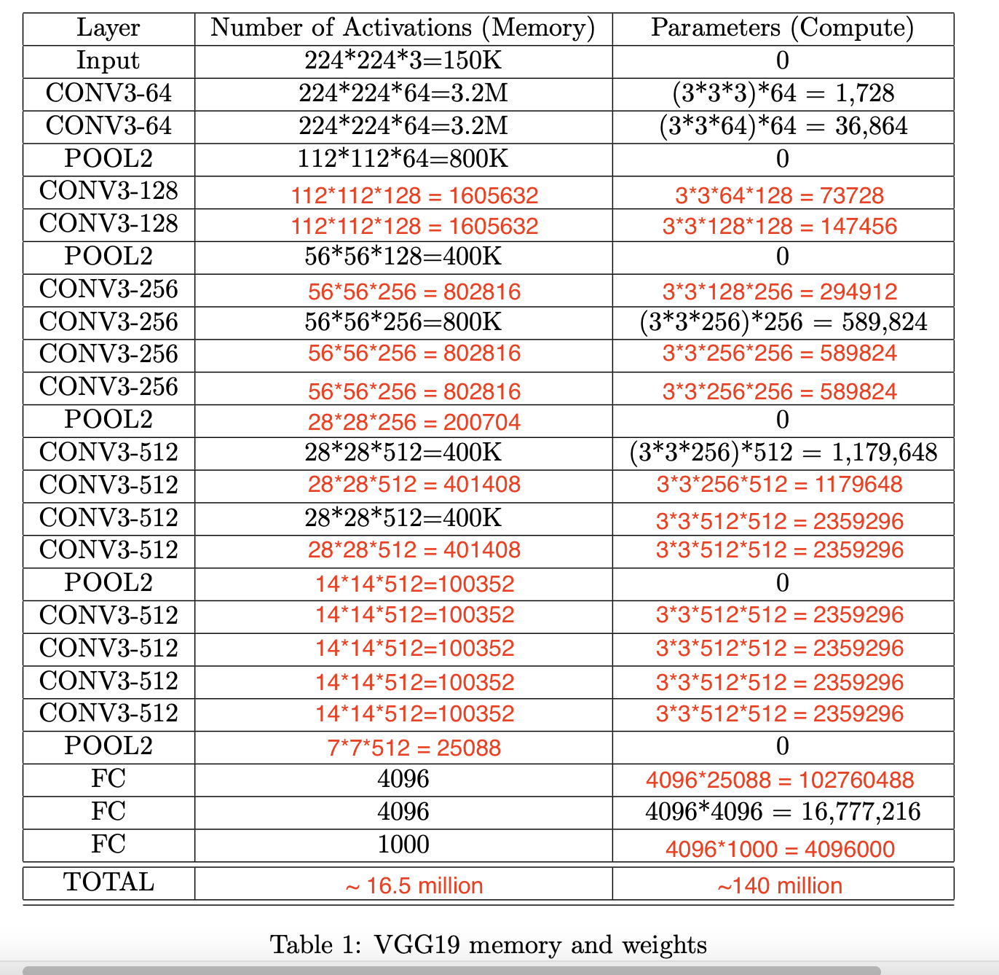

In [1]:
# 3.4

**a. What is the general idea behind designing an inception module (parallel convolutional filters of different sizes with a pooling followed by concatenation) in a convolutional neural network ?**


The main idea is based on finding out how an optimal local sparse
structure in a convolutional vision network can be approximated and covered by readily available dense components. It lets us use many filter sizes that can be concatenated. Also, current state-of-the-art models rely heavily on pooling operations. So the authors add a parallel pooling path to see even more benefits. It aligns with the intuition that
visual information should be processed at various scales and then aggregated so that the next stage
can abstract features from different scales simultaneously.

**b. size 32x32x256, calculate the output size after filter concatenation for the naive and dimensionality reduction inception architectures.**

(using formula3 from 3a.)

**Naive architecture:**

Filter size = 1*1

Output size after 128 Conv: 32 * 32 * 128

Filter size = 3*3

Output size after 192 Conv: 32 * 32 * 192

Filter size = 5*5

Output size after 96 Conv: 32 * 32 * 96

Filter size = 3*3 stride=2

Output size after Max pooling: 32 * 32 * 256

Total size after concatenation =  32 * 32 * (128+192+96+256) = 32 * 32 * 672


**Dimension reduction architecture:**

Filter size = 1*1

Output size after 128 Conv: 32 * 32 * 128

Filter size = 3*3

Output size after 192 Conv: 32 * 32 * 192

Filter size = 5*5

Output size after 96 Conv: 32 * 32 * 96

Filter size = 1*1

Output size after 64 Conv: 32 * 32 * 64

Total size after concatenation =  32 * 32 * (128+192+96+64) = 32 * 32 * 480

**c. calculate the total number of convolutional operations**

(using formulae from 3a.)

**Naive architecture:**

Filter size 1*1

Ops after 128 conv: 32*32*1*1*256*128 = 33554432

Filter size 3*3

Ops after 192 conv: 32*32*3*3*256*128 = 301989888

Filter size 5*5

Ops after 96 conv: 32*32*5*5*256*128 = 838860800

Total Ops: 1174405120

**Dimension reduction architecture:**

Filter size 1*1 128 conv

Ops: (32 × 32 × 256 × 128) + (32 × 32 × 256 × 128) + (32 × 32 × 256 × 64) = 92274688

Filter size 3*3 192 Conv

Ops: 32 × 32 × 3 × 3 × 128 × 192 = 226492416

Filter size 5*5 96 Conv

Ops: 32 × 32 × 5 × 5 × 32 × 96 = 78643200

Total Ops: 397410304

**4d. explain the problem with naive architecture and how dimensionality reduction architecture helps.**

As seen the no. of operations are very high in naive architecture compared to dimensionality reduction which parallelizes many operations. Hence, naive arch is computationally expensive. No. of features considerably decrease in dimensionality reduction arch which is why it is better.

Computational saving = 1174405120 - 397410304 / 1174405120 = ~66.16% decrease.

### Problem 4

In [2]:
# 4.1

**4.1 Explain cutout regularization and its advantages compared to simple dropout (as argued in the paper by DeVries et al)**

Cutout is a regularization technique for augmenting images by making the dataset more versatile. In this, a region of an image from the sample is occluded so that the network can learn the finer features rather than few major features, thereby improving training and generalization of the model.

**Advantages over dropout:**

1. Dropout tends to work well for fully connected layers but lacks that regularization power for convolutional layers. It usually considers each feature map individually and as a result one feature may appear in one part of the network
wheras be dropped in another part of the network. Since cutout works on the input space, it ensures that the model looks at the entire image rather than fixing its attention to some key features.

2. Dropout requires larger datasets and more complex models whereas cutout doesn't depend on any of it. 

In [2]:
(cifar_x_train, cifar_y_train), (cifar_x_test, cifar_y_test) = cifar10.load_data()

170498071/170498071 [==============================] - 3s 0us/step


Original images:


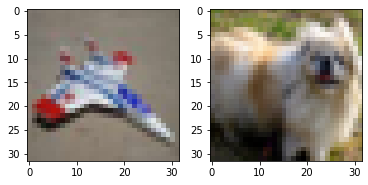

In [3]:
print("Original images:")
img1, img2 = cifar_x_train[30], cifar_x_train[40]
f, ax = plt.subplots(1,2)
ax[0].imshow(img1)
ax[1].imshow(img2)

In [4]:
def apply_cutout(img, size=12):
  h, w, channels = img.shape
  new_img = img.copy()

  y = np.random.randint(h)
  x = np.random.randint(w)

  y1 = np.clip(y - size // 2, 0, h)
  y2 = np.clip(y + size // 2, 0, h)
  x1 = np.clip(x - size // 2, 0, w)
  x2 = np.clip(x + size // 2, 0, w)

  new_img[y1:y2,x1:x2,:] = 0
  return new_img

Original images:
Cutout images:


Text(0.5, 1.0, 'Cutout')

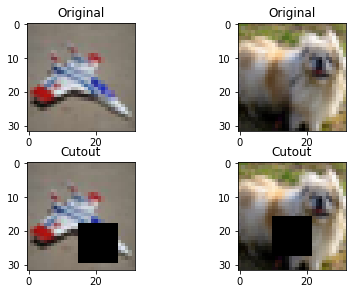

In [5]:
f, ax = plt.subplots(2,2)
f.tight_layout(pad=1.0)
print("Original images:")
ax[0, 0].imshow(img1)
ax[0,0].set_title("Original")
ax[0,1].imshow(img2)
ax[0,1].set_title("Original")


print("Cutout images:")
ax[1, 0].imshow(apply_cutout(img1))
ax[1,0].set_title("Cutout")
ax[1,1].imshow(apply_cutout(img2))
ax[1,1].set_title("Cutout")

**The remaining code in Problem 4 was run on GPU. Code and results attached.**

In [13]:
###### RESNET-44 START #########

In [ ]:
def lr_schedule(epoch):
    """Learning Rate Schedule
    Learning rate is scheduled to be reduced after 80, 120, 160, 180 epochs.
    Called automatically every epoch as part of callbacks during training.
    # Arguments
        epoch (int): The number of epochs
    # Returns
        lr (float32): learning rate
    """
    lr = 1e-3
    if epoch > 180:
        lr *= 0.5e-3
    elif epoch > 160:
        lr *= 1e-3
    elif epoch > 120:
        lr *= 1e-2
    elif epoch > 80:
        lr *= 1e-1
    print('Learning rate: ', lr)
    return lr


def resnet_layer(inputs,
                 num_filters=16,
                 kernel_size=3,
                 strides=1,
                 activation='relu',
                 batch_normalization=True,
                 conv_first=True):
    """2D Convolution-Batch Normalization-Activation stack builder
    Arguments:
        inputs (tensor): input tensor from input image or previous layer
        num_filters (int): Conv2D number of filters
        kernel_size (int): Conv2D square kernel dimensions
        strides (int): Conv2D square stride dimensions
        activation (string): activation name
        batch_normalization (bool): whether to include batch normalization
        conv_first (bool): conv-bn-activation (True) or
            bn-activation-conv (False)
    Returns:
        x (tensor): tensor as input to the next layer
    """
    conv = Conv2D(num_filters,
                  kernel_size=kernel_size,
                  strides=strides,
                  padding='same',
                  kernel_initializer='he_normal',
                  kernel_regularizer=l2(1e-4))

    x = inputs
    if conv_first:
        x = conv(x)
        if batch_normalization:
            x = BatchNormalization()(x)
        if activation is not None:
            x = Activation(activation)(x)
    else:
        if batch_normalization:
            x = BatchNormalization()(x)
        if activation is not None:
            x = Activation(activation)(x)
        x = conv(x)
    return x


def resnet_v1(input_shape, depth, num_classes=10):
    """ResNet Version 1 Model builder [a]
    Stacks of 2 x (3 x 3) Conv2D-BN-ReLU
    Last ReLU is after the shortcut connection.
    At the beginning of each stage, the feature map size is halved
    (downsampled) by a convolutional layer with strides=2, while 
    the number of filters is doubled. Within each stage, 
    the layers have the same number filters and the
    same number of filters.
    Features maps sizes:
    stage 0: 32x32, 16
    stage 1: 16x16, 32
    stage 2:  8x8,  64
    The Number of parameters is approx the same as Table 6 of [a]:
    ResNet20 0.27M
    ResNet32 0.46M
    ResNet44 0.66M
    ResNet56 0.85M
    ResNet110 1.7M
    Arguments:
        input_shape (tensor): shape of input image tensor
        depth (int): number of core convolutional layers
        num_classes (int): number of classes (CIFAR10 has 10)
    Returns:
        model (Model): Keras model instance
    """
    if (depth - 2) % 6 != 0:
        raise ValueError('depth should be 6n+2 (eg 20, 32, in [a])')
    # start model definition.
    num_filters = 16
    num_res_blocks = int((depth - 2) / 6)

    inputs = Input(shape=input_shape)
    x = resnet_layer(inputs=inputs)
    # instantiate the stack of residual units
    for stack in range(3):
        for res_block in range(num_res_blocks):
            strides = 1
            # first layer but not first stack
            if stack > 0 and res_block == 0:  
                strides = 2  # downsample
            y = resnet_layer(inputs=x,
                             num_filters=num_filters,
                             strides=strides)
            y = resnet_layer(inputs=y,
                             num_filters=num_filters,
                             activation=None)
            # first layer but not first stack
            if stack > 0 and res_block == 0:
                # linear projection residual shortcut
                # connection to match changed dims
                x = resnet_layer(inputs=x,
                                 num_filters=num_filters,
                                 kernel_size=1,
                                 strides=strides,
                                 activation=None,
                                 batch_normalization=False)
            x = add([x, y])
            x = Activation('relu')(x)
        num_filters *= 2

    # add classifier on top.
    # v1 does not use BN after last shortcut connection-ReLU
    x = AveragePooling2D(pool_size=8)(x)
    y = Flatten()(x)
    outputs = Dense(num_classes,
                    activation='softmax',
                    kernel_initializer='he_normal')(y)

    # instantiate model.
    model = Model(inputs=inputs, outputs=outputs)
    return model

In [ ]:
######### RESNET-44 END #########

In [6]:
(cifar_X_train, cifar_y_train), (cifar_X_test, cifar_y_test) = cifar10.load_data()

# training parameters
batch_size = 64
epochs = 100
data_augmentation = True
num_classes = 10
n = 7
depth = n * 6 + 2

model_type = 'ResNet-%d' % depth
print("Model type:", model_type)

input_shape = cifar_X_train.shape[1:]

X_train = cifar_X_train.astype('float32') / 255
X_test = cifar_X_test.astype('float32') / 255

X_train_mean = np.mean(X_train, axis=0)
X_train -= X_train_mean
X_test -= X_train_mean

print('X_train shape:', X_train.shape)
print(X_train.shape[0], 'train samples')
print(X_test.shape[0], 'test samples')
print('y_train shape:', cifar_y_train.shape)

# convert class vectors to binary class matrices.
y_train = to_categorical(cifar_y_train)
y_test = to_categorical(cifar_y_test)

Model type: ResNet-44
x_train shape: (50000, 32, 32, 3)
50000 train samples
10000 test samples
y_train shape: (50000, 1)


In [ ]:
def get_callbacks():

  lr_scheduler = LearningRateScheduler(lr_schedule)

  lr_reducer = ReduceLROnPlateau(factor=np.sqrt(0.1),
                                cooldown=0,
                                patience=5,
                                min_lr=0.5e-6)

  callbacks = [lr_reducer, lr_scheduler]
  return callbacks

epochs = 100
batch_size = 64
# basic augmentation like He et. al.
datagen = ImageDataGenerator(
    width_shift_range=[-4,4],
    height_shift_range=[-4,4],
    horizontal_flip=0.5, 
    fill_mode='constant',
    cval=0
)

datagen.fit(X_train)

he_model = resnet_v1(
    input_shape=X_train.shape[1:],
    depth=44
)      

he_model.compile(
    loss='categorical_crossentropy',
    optimizer=RMSprop(),
    metrics=['acc']
)    
start = time.time()

he_model_hist = he_model.fit(
    datagen.flow(X_train, y_train, batch_size=batch_size), 
    epochs=epochs, 
    validation_data=(X_test,y_test),
    steps_per_epoch=np.floor(X_train.shape[0]//batch_size),
    verbose=2,
    callbacks=get_callbacks()
)
dur = time.time() - start
print("final duration_4b:", dur)

name = "logs_history_4b.txt"
with open(name, "w") as outfile:
  outfile.write(str(he_model_hist.history))
outfile.close()
print("final loss_4b:", he_model_hist.history["val_loss"])
print("final acc_4b:", he_model_hist.history["val_acc"])
print("final training_loss_4b:", he_model_hist.history["loss"])
print("final training_acc_4b:", he_model_hist.history["acc"])

In [ ]:
# From files on the VM

In [16]:
val_acc = [0.2770000100135803, 0.41260001063346863, 0.5863999724388123, 0.6197999715805054, 0.6808000206947327, 0.7081000208854675, 0.6725000143051147, 0.7318000197410583, 0.612500011920929, 0.6309999823570251, 0.6919999718666077, 0.698199987411499, 0.6597999930381775, 0.7245000004768372, 0.7099000215530396, 0.5627999901771545, 0.7742999792098999, 0.7439000010490417, 0.7527999877929688, 0.758400022983551, 0.7049000263214111, 0.6995000243186951, 0.7962999939918518, 0.7720999717712402, 0.7706000208854675, 0.7215999960899353, 0.7171000242233276, 0.766700029373169, 0.7997999787330627, 0.7781999707221985, 0.781000018119812, 0.6697999835014343, 0.8036999702453613, 0.820900022983551, 0.781499981880188, 0.7965999841690063, 0.730400025844574, 0.7667999863624573, 0.7831000089645386, 0.7660999894142151, 0.8198000192642212, 0.7757999897003174, 0.803600013256073, 0.7947999835014343, 0.7868000268936157, 0.7731999754905701, 0.7752000093460083, 0.8134999871253967, 0.7968000173568726, 0.7529000043869019, 0.7926999926567078, 0.7912999987602234, 0.7890999913215637, 0.8116999864578247, 0.6898000240325928, 0.8241999745368958, 0.8299000263214111, 0.8188999891281128, 0.8148999810218811, 0.8230999708175659, 0.8219000101089478, 0.7623999714851379, 0.7868000268936157, 0.8235999941825867, 0.7922999858856201, 0.7861999869346619, 0.7049000263214111, 0.7684999704360962, 0.796999990940094, 0.7914999723434448, 0.8137000203132629, 0.8281000256538391, 0.8162999749183655, 0.7839000225067139, 0.817300021648407, 0.7753999829292297, 0.8299000263214111, 0.8310999870300293, 0.8087000250816345, 0.8090000152587891, 0.8217999935150146, 0.8725000023841858, 0.8755000233650208, 0.8779000043869019, 0.8781999945640564, 0.8763999938964844, 0.876800000667572, 0.8761000037193298, 0.8726000189781189, 0.8751000165939331, 0.8774999976158142, 0.8736000061035156, 0.8777999877929688, 0.8730000257492065, 0.8730000257492065, 0.8718000054359436, 0.8730000257492065, 0.8763999938964844, 0.8718000054359436, 0.8769000172615051]
val_loss = [3.948972225189209, 2.393470048904419, 1.6138858795166016, 1.4440668821334839, 1.2956339120864868, 1.2518402338027954, 1.4938231706619263, 1.0320180654525757, 1.843569278717041, 1.52774178981781, 1.3635083436965942, 1.400577425956726, 1.536002278327942, 1.2714414596557617, 1.255326509475708, 2.6682982444763184, 1.0307546854019165, 1.1962100267410278, 1.1943855285644531, 1.1358654499053955, 1.5560928583145142, 1.7338594198226929, 0.9591428637504578, 1.0277975797653198, 1.1324546337127686, 1.2763556241989136, 1.3396884202957153, 1.082546353340149, 0.9424713850021362, 1.0314632654190063, 1.102142572402954, 1.8617312908172607, 0.8603289127349854, 0.9351900219917297, 1.2015955448150635, 1.0677151679992676, 1.4042887687683105, 1.2212408781051636, 1.0354726314544678, 1.2609721422195435, 0.9482849836349487, 1.0987061262130737, 1.0104522705078125, 1.0356910228729248, 1.180625319480896, 1.39975106716156, 1.099661946296692, 0.9794822335243225, 1.0479482412338257, 1.57280695438385, 1.0778095722198486, 1.0056235790252686, 1.1159976720809937, 1.0009891986846924, 1.6996862888336182, 0.8846287131309509, 0.8633478283882141, 0.9383567571640015, 0.988592267036438, 0.9147658944129944, 0.8988801836967468, 1.1732629537582397, 1.129762053489685, 0.9385396242141724, 1.1370230913162231, 1.235766053199768, 1.938504695892334, 1.3294196128845215, 1.2590750455856323, 1.239503264427185, 1.049507975578308, 0.9139991998672485, 0.9902435541152954, 1.2267669439315796, 0.9571051597595215, 1.3489184379577637, 0.9815184473991394, 0.9285802841186523, 1.1810485124588013, 1.114534854888916, 1.0846388339996338, 0.7728714346885681, 0.7875451445579529, 0.7824076414108276, 0.8256329894065857, 0.8375846743583679, 0.8487504720687866, 0.8920120000839233, 0.9185904264450073, 0.9319361448287964, 0.8993732333183289, 0.9530524611473083, 0.9677189588546753, 0.9704654216766357, 0.9835118055343628, 0.9937527179718018, 1.0325961112976074, 1.0194499492645264, 1.025007724761963, 1.0205895900726318]

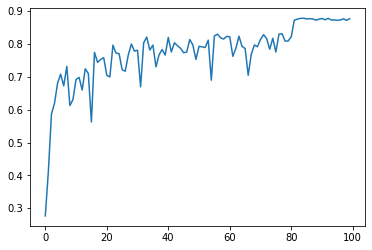

In [15]:
plt.plot(val_acc)
plt.xlabel("Epochs")
plt.ylabel("Validation Accuracy")

In [32]:
print("Accuracy at the end of 100 epochs:", val_acc[-1])

Accuracy at the end of 100 epochs: 0.8769000172615051


Text(0, 0.5, 'Validation Loss')

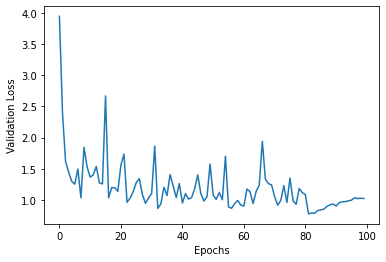

In [17]:
plt.plot(val_loss)
plt.xlabel("Epochs")
plt.ylabel("Validation Loss")

In [36]:
dur = 6576.512188196182
print("Model ran for 100 epochs:")
print("Time taken to train in hrs:", dur/3600)

Model ran for 100 epochs:
Time taken to train in hrs: 1.826808941165606


In [ ]:
# 4.3

In [7]:
def augment_m_times(x, y, epochs, m, batch_size):
    for _ in range(epochs):
        n = x.shape[0]
        start_ptr = 0
        while start_ptr + batch_size < x.shape[0]:
            x_batch = x[start_ptr:start_ptr + batch_size]
            y_batch = y[start_ptr:start_ptr + batch_size]
            yield np.array([apply_cutout(xx) for xx in x_batch for rep in range(m)]), np.array([yy for yy in y_batch for rep in range(m)])
            start_ptr += batch_size

def get_callbacks():
    lr_scheduler = LearningRateScheduler(lr_schedule)

    lr_reducer = ReduceLROnPlateau(factor=np.sqrt(0.1),
                                cooldown=0,
                                patience=5,
                                min_lr=0.5e-6)

    callbacks = [lr_reducer, lr_scheduler]
    return callbacks

val_acc_cutout = []
val_loss_cutout = []
epochs = 100
durations_hoffer = []

for i in [2,4,8,16]:
    hoffer_model = resnet_v1(
        input_shape=X_train.shape[1:],
        depth=44
    )      
    hoffer_model.compile(
        loss='categorical_crossentropy',
        optimizer=RMSprop(),
        metrics=['acc']
    )    
    start = time.time()
    
    hoffer_generator = augment_m_times(
            X_train,
            y_train,
            m=i,
            batch_size=64,
            epochs=epochs
        )
    
    hist_M = hoffer_model.fit(
        hoffer_generator,
        epochs=epochs, 
        validation_data=(X_test,y_test),
        steps_per_epoch=np.floor(X_train.shape[0]//batch_size),
        verbose=1,
        use_multiprocessing=True,
        workers=6,
        callbacks=get_callbacks()
    )
    durations_hoffer.append(time.time()-start)
    val_acc_cutout.append(hist_M.history['val_acc'])
    val_loss_cutout.append(hist_M.history['val_loss'])
    name = f"hist_{i}.txt"
    with open(name, "w") as outfile:
      outfile.write(str(hist_M.history))
    outfile.close()

print("final loss:", val_loss_cutout)
with open("outfile_val", "w") as outfile:
    outfile.write("\n".join(val_loss_cutout))
outfile.close()

with open("outfile_dur", "w") as outfile2:
    outfile2.write("\n".join(durations_hoffer))
outfile2.close()

In [18]:
# Output from VM files

In [26]:
hoffer_val_loss_2 = [4.996125221252441, 3.4406538009643555, 3.981978416442871, 2.714226484298706, 3.437345027923584, 2.494075298309326, 3.137688159942627, 2.484424352645874, 2.232569932937622, 2.69486141204834, 2.365030288696289, 2.40130877494812, 2.8535938262939453, 1.9926292896270752, 3.9851772785186768, 1.5526633262634277, 1.9728208780288696, 1.50339674949646, 2.2206919193267822, 2.8449504375457764, 1.8210409879684448, 2.273715019226074, 3.5209789276123047, 1.861472249031067, 1.813827395439148, 1.7140507698059082, 1.6596918106079102, 2.1095917224884033, 2.1157901287078857, 1.8715887069702148, 2.0786705017089844, 2.1386148929595947, 1.7112817764282227, 1.2273114919662476, 2.1771790981292725, 1.7274885177612305, 1.7286099195480347, 1.4899791479110718, 1.3475863933563232, 1.6135199069976807, 1.5442653894424438, 2.3498058319091797, 1.4481914043426514, 1.1932482719421387, 2.7163736820220947, 1.9992214441299438, 0.9788616299629211, 1.9405878782272339, 1.2038518190383911, 1.9744644165039062, 2.055389642715454, 1.4450141191482544, 1.6716045141220093, 1.7796251773834229, 1.2757607698440552, 1.022338628768921, 1.3608214855194092, 1.4372044801712036, 2.020260810852051, 1.4338440895080566, 1.3354730606079102, 1.161457896232605, 1.1276684999465942, 1.1021795272827148, 2.371967315673828, 1.4948883056640625, 1.031998872756958, 1.345131754875183, 1.2799566984176636, 1.0097918510437012, 1.037927508354187, 1.5301214456558228, 1.2116501331329346, 1.0802663564682007, 1.5408767461776733, 1.2945400476455688, 1.2479898929595947, 0.9285770654678345, 1.018773078918457, 1.1929879188537598, 1.3502373695373535, 0.7038217186927795, 0.6856280565261841, 0.6979588270187378, 0.7645232081413269, 0.7729604244232178, 0.7812507748603821, 0.7693789005279541, 0.8411659002304077, 0.8277170062065125, 0.800743818283081, 0.9482532143592834, 0.8681854605674744, 0.8682307600975037, 0.9538261890411377, 0.8424407243728638, 0.9368406534194946, 0.924394428730011, 0.8406108617782593, 0.8289323449134827]
hoffer_val_acc_2 = [0.19329999387264252, 0.3402999937534332, 0.29420000314712524, 0.4090999960899353, 0.3425999879837036, 0.3889000117778778, 0.32690000534057617, 0.4108000099658966, 0.4442000091075897, 0.4212999939918518, 0.4447999894618988, 0.4830999970436096, 0.420199990272522, 0.5012999773025513, 0.3531000018119812, 0.5878999829292297, 0.5579000115394592, 0.5927000045776367, 0.4966999888420105, 0.48890000581741333, 0.5914000272750854, 0.5680999755859375, 0.38019999861717224, 0.6154999732971191, 0.6190000176429749, 0.5609999895095825, 0.605400025844574, 0.5533000230789185, 0.5849999785423279, 0.583899974822998, 0.5580999851226807, 0.5849999785423279, 0.6047000288963318, 0.6870999932289124, 0.5824000239372253, 0.6258999705314636, 0.6148999929428101, 0.6718999743461609, 0.6682999730110168, 0.6169000267982483, 0.6399000287055969, 0.5257999897003174, 0.670199990272522, 0.7032999992370605, 0.5392000079154968, 0.6107000112533569, 0.743399977684021, 0.6234999895095825, 0.7197999954223633, 0.6261000037193298, 0.5889000296592712, 0.6647999882698059, 0.6407999992370605, 0.6355999708175659, 0.6937000155448914, 0.7342000007629395, 0.684499979019165, 0.6937999725341797, 0.6013000011444092, 0.6740000247955322, 0.6628000140190125, 0.7161999940872192, 0.7206000089645386, 0.7031999826431274, 0.5486999750137329, 0.6653000116348267, 0.7495999932289124, 0.6972000002861023, 0.6901000142097473, 0.7348999977111816, 0.745199978351593, 0.6534000039100647, 0.7106999754905701, 0.728600025177002, 0.6660000085830688, 0.7265999913215637, 0.7232999801635742, 0.7497000098228455, 0.7569000124931335, 0.7168999910354614, 0.6866000294685364, 0.819599986076355, 0.8319000005722046, 0.8346999883651733, 0.8334000110626221, 0.8335000276565552, 0.8342000246047974, 0.8414000272750854, 0.8366000056266785, 0.8355000019073486, 0.8413000106811523, 0.8237000107765198, 0.8410999774932861, 0.8371000289916992, 0.8285999894142151, 0.843500018119812, 0.836899995803833, 0.8377000093460083, 0.8435999751091003, 0.8446000218391418]

hoffer_val_loss_4 = [4.501518726348877, 3.6113035678863525, 4.166891574859619, 6.38674783706665, 2.8704352378845215, 2.566619873046875, 5.728405475616455, 4.555456161499023, 1.858786940574646, 3.3618409633636475, 1.930057168006897, 1.8618285655975342, 2.7269444465637207, 2.5561563968658447, 2.443002700805664, 2.397524118423462, 3.175384283065796, 1.7941632270812988, 2.044546365737915, 2.507260799407959, 2.3512988090515137, 2.6438381671905518, 2.544607400894165, 1.7064205408096313, 1.7910888195037842, 1.5959175825119019, 1.7369133234024048, 1.4851666688919067, 1.7003506422042847, 1.6854218244552612, 1.5047740936279297, 1.9379161596298218, 1.5027134418487549, 2.3133065700531006, 1.6517266035079956, 1.245552659034729, 1.7848870754241943, 1.7769529819488525, 1.4918075799942017, 1.1277695894241333, 1.6076546907424927, 1.230424165725708, 1.5552862882614136, 1.0843555927276611, 1.892732858657837, 1.484391212463379, 1.3414870500564575, 1.0934494733810425, 1.3435447216033936, 1.6443023681640625, 1.0046793222427368, 1.6303530931472778, 1.1660959720611572, 0.9145206809043884, 1.3999848365783691, 1.3486746549606323, 1.9503238201141357, 2.350658416748047, 1.1637932062149048, 0.9422541260719299, 1.2707074880599976, 1.0198644399642944, 1.5403592586517334, 0.9231513738632202, 1.1199519634246826, 1.502030372619629, 1.1250580549240112, 0.9812950491905212, 1.421768069267273, 1.0426108837127686, 1.289604902267456, 1.3683744668960571, 0.9833275675773621, 1.1372156143188477, 1.060068130493164, 1.11456298828125, 1.0118261575698853, 0.9336652159690857, 0.9286775588989258, 0.8865221738815308, 0.9803973436355591, 0.6173885464668274, 0.6605716347694397, 0.6037031412124634, 0.6811045408248901, 0.6687624454498291, 0.7382934093475342, 0.6908650398254395, 0.7998713254928589, 0.7595372200012207, 0.7609684467315674, 0.7623240351676941, 0.8151111602783203, 0.736150860786438, 0.8307617902755737, 0.7508565187454224, 0.841609001159668, 0.8346626162528992, 0.815364420413971, 0.786154568195343]
hoffer_val_acc_4 = [0.19370000064373016, 0.31700000166893005, 0.2888999879360199, 0.24629999697208405, 0.37549999356269836, 0.4113999903202057, 0.25049999356269836, 0.31279999017715454, 0.5185999870300293, 0.4489000141620636, 0.544700026512146, 0.5601000189781189, 0.4742000102996826, 0.4846000075340271, 0.4950999915599823, 0.4819999933242798, 0.4036000072956085, 0.5633999705314636, 0.5936999917030334, 0.49129998683929443, 0.4927999973297119, 0.5230000019073486, 0.5411999821662903, 0.593500018119812, 0.5745000243186951, 0.6322000026702881, 0.6254000067710876, 0.6565999984741211, 0.6498000025749207, 0.6380000114440918, 0.6514000296592712, 0.6179999709129333, 0.6700000166893005, 0.5929999947547913, 0.6601999998092651, 0.7024000287055969, 0.6049000024795532, 0.6546000242233276, 0.6636000275611877, 0.704200029373169, 0.6564000248908997, 0.6958000063896179, 0.6759999990463257, 0.7296000123023987, 0.6428999900817871, 0.6797999739646912, 0.6960999965667725, 0.7340999841690063, 0.6794999837875366, 0.6736999750137329, 0.7355999946594238, 0.6607999801635742, 0.7128999829292297, 0.7781000137329102, 0.6794999837875366, 0.6935999989509583, 0.6222000122070312, 0.5489000082015991, 0.7203999757766724, 0.7617999911308289, 0.738099992275238, 0.7484999895095825, 0.6804999709129333, 0.7505999803543091, 0.7508999705314636, 0.6689000129699707, 0.7390999794006348, 0.7487999796867371, 0.6959999799728394, 0.7523999810218811, 0.6956999897956848, 0.6901999711990356, 0.7608000040054321, 0.7330999970436096, 0.737500011920929, 0.729200005531311, 0.7455999851226807, 0.7656999826431274, 0.7757999897003174, 0.7825000286102295, 0.7621999979019165, 0.8370000123977661, 0.8328999876976013, 0.8463000059127808, 0.8476999998092651, 0.8499000072479248, 0.8464000225067139, 0.8575999736785889, 0.8402000069618225, 0.8490999937057495, 0.8579999804496765, 0.8539999723434448, 0.8511999845504761, 0.8593999743461609, 0.8507000207901001, 0.858299970626831, 0.8529999852180481, 0.8522999882698059, 0.858299970626831, 0.857699990272522]

hoffer_val_loss_8 = [3.679943799972534, 3.3426756858825684, 3.882068395614624, 4.147252559661865, 3.641688585281372, 3.839381217956543, 2.252420425415039, 2.598661184310913, 3.06463360786438, 3.389705181121826, 1.8899106979370117, 2.1242423057556152, 1.8839365243911743, 3.108664035797119, 1.8720391988754272, 1.7415450811386108, 2.4961376190185547, 1.6750420331954956, 1.431925892829895, 1.9645503759384155, 1.7468243837356567, 1.664611577987671, 1.3706426620483398, 2.9032416343688965, 2.9465034008026123, 1.7925441265106201, 1.7317851781845093, 1.5719342231750488, 1.188583254814148, 1.2344903945922852, 1.930525541305542, 1.2502658367156982, 1.6959198713302612, 1.4354796409606934, 2.090322494506836, 1.39324951171875, 1.204525351524353, 1.4102553129196167, 1.1203609704971313, 1.117837905883789, 1.1404038667678833, 1.2674264907836914, 1.581882119178772, 1.4030531644821167, 1.6226582527160645, 1.4473366737365723, 1.0667099952697754, 1.3163057565689087, 1.0632929801940918, 1.1667258739471436, 1.1232491731643677, 1.126968502998352, 1.331583857536316, 1.0871368646621704, 1.0427206754684448, 0.9430392384529114, 1.0224865674972534, 1.4068551063537598, 1.5389530658721924, 1.3418060541152954, 1.1229608058929443, 1.0013153553009033, 1.1249843835830688, 1.2905757427215576, 1.5285351276397705, 1.3640251159667969, 0.8173534870147705, 1.209174394607544, 1.1281800270080566, 0.9583638906478882, 1.0812413692474365, 1.3695037364959717, 0.9731772541999817, 0.9537507891654968, 0.9742973446846008, 1.4183213710784912, 0.9111219644546509, 0.9824965000152588, 1.354307770729065, 1.3499542474746704, 0.9203521609306335, 0.6553851366043091, 0.6242617964744568, 0.6369642615318298, 0.6326478719711304, 0.6593084931373596, 0.7032730579376221, 0.730278730392456, 0.6972692012786865, 0.7189734578132629, 0.7401832342147827, 0.7496080994606018, 0.7412875294685364, 0.7867764234542847, 0.8433923721313477, 0.7714753150939941, 0.7743293642997742, 0.7694428563117981, 0.7871646285057068, 0.7924162745475769]
hoffer_val_acc_8 = [0.29829999804496765, 0.3122999966144562, 0.36660000681877136, 0.3391999900341034, 0.3278999924659729, 0.3409999907016754, 0.48500001430511475, 0.4740999937057495, 0.4036000072956085, 0.42320001125335693, 0.5975000262260437, 0.5335999727249146, 0.5724999904632568, 0.4343999922275543, 0.578499972820282, 0.5911999940872192, 0.5691999793052673, 0.6129000186920166, 0.6523000001907349, 0.6122999787330627, 0.6068000197410583, 0.6266999840736389, 0.6845999956130981, 0.5698000192642212, 0.5503000020980835, 0.6151999831199646, 0.675599992275238, 0.6640999913215637, 0.7184000015258789, 0.7003999948501587, 0.6262999773025513, 0.7275999784469604, 0.6327000260353088, 0.6912000179290771, 0.6225000023841858, 0.7052000164985657, 0.7257999777793884, 0.6922000050544739, 0.7494000196456909, 0.7229999899864197, 0.7394999861717224, 0.7171000242233276, 0.6855000257492065, 0.7177000045776367, 0.6729999780654907, 0.6974999904632568, 0.7457000017166138, 0.7163000106811523, 0.7527999877929688, 0.7286999821662903, 0.7409999966621399, 0.7379999756813049, 0.7009999752044678, 0.7480999827384949, 0.7669000029563904, 0.7724999785423279, 0.7706000208854675, 0.7038000226020813, 0.6850000023841858, 0.7099999785423279, 0.7559999823570251, 0.761900007724762, 0.7426999807357788, 0.7142000198364258, 0.6973999738693237, 0.6829000115394592, 0.7964000105857849, 0.7303000092506409, 0.7458999752998352, 0.7712000012397766, 0.7551000118255615, 0.7232000231742859, 0.7731999754905701, 0.7756999731063843, 0.7703999876976013, 0.7153000235557556, 0.7851999998092651, 0.7739999890327454, 0.718500018119812, 0.713699996471405, 0.7843999862670898, 0.8414999842643738, 0.8501999974250793, 0.85589998960495, 0.8607000112533569, 0.859499990940094, 0.8554999828338623, 0.8521999716758728, 0.8604999780654907, 0.8586999773979187, 0.8636000156402588, 0.8590999841690063, 0.8604999780654907, 0.8589000105857849, 0.8531000018119812, 0.8615999817848206, 0.8629000186920166, 0.8636000156402588, 0.8644999861717224, 0.862500011920929]

hoffer_val_loss_16 = [3.80856990814209, 3.870112180709839, 2.9357664585113525, 3.7211968898773193, 3.8718366622924805, 2.6705243587493896, 2.3954918384552, 2.0710010528564453, 2.8877339363098145, 2.2357916831970215, 4.578775882720947, 1.859379529953003, 1.9224685430526733, 2.3106296062469482, 2.3109352588653564, 2.8910655975341797, 2.4791665077209473, 1.6098345518112183, 1.6670880317687988, 2.874234437942505, 3.2185723781585693, 1.4607616662979126, 1.1916338205337524, 1.7207165956497192, 2.0379879474639893, 2.8818984031677246, 1.5882689952850342, 2.3308842182159424, 1.4678678512573242, 1.4674439430236816, 1.3126763105392456, 1.115504503250122, 0.9736699461936951, 3.609419822692871, 1.3031827211380005, 1.3882931470870972, 1.0330607891082764, 1.330933928489685, 1.8749269247055054, 1.173693299293518, 1.623127818107605, 0.9167305827140808, 1.7954230308532715, 1.8108822107315063, 1.8929681777954102, 1.20430326461792, 1.7402163743972778, 1.910813808441162, 0.8765271306037903, 0.9311362504959106, 0.9188550710678101, 1.1877011060714722, 1.1439158916473389, 1.103368878364563, 1.0101603269577026, 1.0611989498138428, 1.1331558227539062, 0.8299617171287537, 0.9128993153572083, 1.0279797315597534, 1.1272963285446167, 1.3240468502044678, 1.1789284944534302, 0.983440637588501, 1.423829436302185, 0.914584755897522, 1.1980408430099487, 0.8057918548583984, 0.9918507933616638, 0.8588190674781799, 1.2868646383285522, 1.2415844202041626, 0.8451862335205078, 1.211803913116455, 1.0142652988433838, 1.0614465475082397, 1.438795566558838, 0.9296995401382446, 1.4476447105407715, 0.9628629684448242, 0.84163498878479, 0.5858417749404907, 0.6036818027496338, 0.5974083542823792, 0.6033306121826172, 0.6224012970924377, 0.6246582269668579, 0.6955441832542419, 0.697147011756897, 0.6720097064971924, 0.7243748307228088, 0.7193589210510254, 0.7422013878822327, 0.7206480503082275, 0.7630859017372131, 0.6982859969139099, 0.7557502388954163, 0.7873350977897644, 0.7994208931922913, 0.7957475781440735]
hoffer_val_acc_16 = [0.31049999594688416, 0.3192000091075897, 0.41130000352859497, 0.328000009059906, 0.4075999855995178, 0.4625999927520752, 0.4555000066757202, 0.5127999782562256, 0.4341000020503998, 0.5270000100135803, 0.41760000586509705, 0.5270000100135803, 0.5722000002861023, 0.4984999895095825, 0.49630001187324524, 0.5040000081062317, 0.5235000252723694, 0.6118999719619751, 0.6043000221252441, 0.545199990272522, 0.4812999963760376, 0.6621999740600586, 0.6872000098228455, 0.5925999879837036, 0.5770999789237976, 0.4796999990940094, 0.6736999750137329, 0.5705000162124634, 0.6577000021934509, 0.6496000289916992, 0.7064999938011169, 0.7243000268936157, 0.7427999973297119, 0.4659999907016754, 0.7184000015258789, 0.6732000112533569, 0.7570000290870667, 0.7121000289916992, 0.5839999914169312, 0.7253000140190125, 0.6636000275611877, 0.7720000147819519, 0.6333000063896179, 0.6413000226020813, 0.6507999897003174, 0.718500018119812, 0.6177999973297119, 0.5911999940872192, 0.7885000109672546, 0.7922000288963318, 0.7775999903678894, 0.7161999940872192, 0.7462000250816345, 0.7487999796867371, 0.7807000279426575, 0.7509999871253967, 0.7603999972343445, 0.8065000176429749, 0.792900025844574, 0.7587000131607056, 0.7515000104904175, 0.7371000051498413, 0.7423999905586243, 0.7825999855995178, 0.7247999906539917, 0.7932999730110168, 0.7396000027656555, 0.8019999861717224, 0.7831000089645386, 0.7986999750137329, 0.7350999712944031, 0.739300012588501, 0.8069999814033508, 0.7537999749183655, 0.7795000076293945, 0.7710000276565552, 0.7257000207901001, 0.7807999849319458, 0.7275000214576721, 0.7907999753952026, 0.8044000267982483, 0.8571000099182129, 0.8580999970436096, 0.8616999983787537, 0.8687000274658203, 0.8686000108718872, 0.8676000237464905, 0.8616999983787537, 0.8574000000953674, 0.8644999861717224, 0.8682000041007996, 0.8658000230789185, 0.8611999750137329, 0.8690000176429749, 0.866599977016449, 0.8729000091552734, 0.8669999837875366, 0.8661999702453613, 0.8687999844551086, 0.8604999780654907]

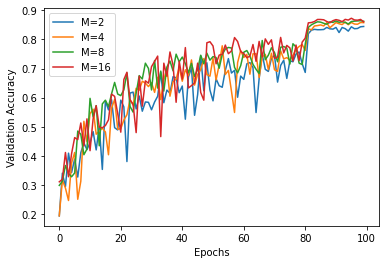

In [28]:
plt.plot(hoffer_val_acc_2, label="M=2")
plt.plot(hoffer_val_acc_4, label="M=4")
plt.plot(hoffer_val_acc_8, label="M=8")
plt.plot(hoffer_val_acc_16, label="M=16")
plt.xlabel("Epochs")
plt.ylabel("Validation Accuracy")
plt.legend()


In [31]:
print("Accuracy at the end of 100 epochs (M=2):", hoffer_val_acc_2[-1])
print("Accuracy at the end of 100 epochs (M=4):", hoffer_val_acc_4[-1])
print("Accuracy at the end of 100 epochs (M=8):", hoffer_val_acc_8[-1])
print("Accuracy at the end of 100 epochs (M=16):", hoffer_val_acc_16[-1])

Accuracy at the end of 100 epochs (M=2): 0.8446000218391418
Accuracy at the end of 100 epochs (M=4): 0.857699990272522
Accuracy at the end of 100 epochs (M=8): 0.862500011920929
Accuracy at the end of 100 epochs (M=16): 0.8604999780654907


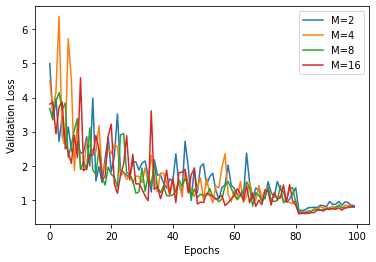

In [29]:
plt.plot(hoffer_val_loss_2, label="M=2")
plt.plot(hoffer_val_loss_4, label="M=4")
plt.plot(hoffer_val_loss_8, label="M=8")
plt.plot(hoffer_val_loss_16, label="M=16")
plt.xlabel("Epochs")
plt.ylabel("Validation Loss")
plt.legend()

In [35]:
# Wall clock time
print("All ran for 100 epochs:")
dur_2, dur_4, dur_8, dur_16 = [3756.983230113983, 4947.20573759079, 7149.521830320358, 12374.478309869766]
print("Time taken to train in hrs(M=2):", dur_2/3600)
print("Time taken to train in hrs(M=4):", dur_4/3600)
print("Time taken to train in hrs(M=8):", dur_8/3600)
print("Time taken to train in hrs(M=16):", dur_16/3600)

All ran for 100 epochs:
Time taken to train in hrs(M=2): 1.0436064528094398
Time taken to train in hrs(M=4): 1.3742238159974416
Time taken to train in hrs(M=8): 1.9859782862000994
Time taken to train in hrs(M=16): 3.437355086074935
